# Text Analysis of Enron Emails using Word2Vec Model

 This is a work performed purely out of curiosity to get a better understanding of text analytics using Python. This work makes use of the famous Enron Email Corpus, which consists close to 0.5 Million emails. The enron email corpus is the largest public domain database of real emails in the world. Originally collected as part of investigations into one of the most infamous corporate scandals of 21st centruy, this dataset is now actively used both by researchers and enthusisasts for experiments in the field of Natural Language Processing.

I had previously worked on sentiment analysis of text using a basic bag of words model. I wanted to proceed to more advanced techniques, which is when I came across the word2vec model developed by researchers at Google. I decided to use this technique for analysing the text in the enron emails. 

To better understand what has been done in this work, it would be helpful to that during the investigation into the scandal, several person at enron were identified as 'Persons Of Interest' (POI), or basically people who were suspected to be associated with the scandal based on their email and financial records. The list of persons of interest is known, and the dataset I have obtained contains their names as well as email IDs in them. 

As mentioned above, the persons of interest were originally identified based on their financial records as well as their email exchanges. It would then be of interest hence to look at the emails exchanged between two POIs. In this work, I have used Python to parse through all the emails in the corpus (barring duplicates, at least as far as I could identify), collected the text body from each email, and used this to train a word2vec model using the gensim package. The word2vec model creates a n-dimensional vector to represent each word. Hence, given an email, or rather the text of an email, we can combine the vectors representing the words contained in the same to some form to obtain a single vector representing the text. 
In this work, I wish to use the trained word2vec model to generate aggregated vectors for the emails. Specifically, I wish to generate vectors for all the emails exchanged between POIs (Let's call this Email of Interest EOI), as well as for some of the non EOIs. I wish to compare the vectors representing EOI and non EOI, to see if there are some patterns.

It is not clear what to expect as outcome from this work. Also, the objective I have mentioned is too restricted in scope, and much more can be done. However, as the first step of a practice exercise, this much is what I have done. I will expand on this work in the future


NOTE: This dataset has been obtained while working for project to be completed as part of the Data Analyst Nanodegree from Udacity. The function parseOutText given in the Support Functions was also taken from the helper functions provided by Udacity for their project. The rest of the code is original

In [10]:
######### Support Functions ##########################################################################
import os
import string
import re
import nltk
import numpy as np
from IPython.display import display

tokenizer = nltk.data.load('tokenizers/punkt/english.pickle') #Helps tokenize a paragrah into sentences

def parseOutText(f):
    """ given an opened email file f, parse out all text below the
        metadata block at the top
        
        example use case:
        f = open("email_file_name.txt", "r")
        text = parseOutText(f)
        
        """
    f.seek(0)  ### go back to beginning of file (annoying)
    all_text = f.read()
#    print(all_text)
    ### split off metadata
    content = all_text.split("X-FileName:")
    words = ""
    if len(content) > 1:
        ### remove punctuation
        text_string = content[1].translate(string.maketrans("", ""), string.punctuation)
#        text_string = content[1]
    return text_string


def parseOutText_2(f):
    """ given an opened email file f, parse out all text below the
        metadata block at the top. Additionally, this removes any content
        below the actual email body (such as quoted text from other emails 
        in the conversation threat)
        
        example use case:
        f = open("email_file_name.txt", "r")
        text = parseOutText(f)
        
        """


    f.seek(0)  ### go back to beginning of file (annoying)
    all_text = f.read()
    
    ### split off metadata
    content = all_text.split("X-FileName:")
    
    words = ""
    if len(content) > 1:
        ### remove punctuation
        intermediate_string = content[1]

        content = re.split('-+ ?Forwarded by|-+ ?Original Message',intermediate_string) #to remove those content from such as "Original Message" or "Forwarded By"

#        text_string = content[0].translate(string.maketrans("", ""), string.punctuation)
        text_string = content[0]
    return text_string

def get_id(f):
    """ get the ID of the email from the first line of the same. This ID will be stored
        in a set as each email is opened and read. 
        
        example use case:
        f = open("email_file_name.txt", "r")
        text = get_id(f)
        """
    f.seek(0)
    line = f.readline()
#    print(line)
    ID = re.split('Message-ID: <',re.split('.JavaMail.evans@thyme>',line)[0])[1]
    return ID
    

        
def sentence_to_words(sentence):
 
    """ Convert a sentence to list of words, after removing all characters
        other than letters of the alphabet. The gensim package used for training
        word2vec requires list of sentences each provided in turn as a list of words, 
    """
    # Remove punctuations
    text = re.sub("[^a-zA-Z]"," ",sentence)
    
    #Change case of letters
    text = text.lower()
    
    #Split the text into words
    word_list = text.split()
    
    return word_list


def text_to_sentences(text,tokenizer):
    
    """ Convert a paragrah to sentences using punkt tokenizer. 
        The gensim package used for training
        word2vec requires list of sentences each provided in turn as a list of words,
    """
    sentences = tokenizer.tokenize(text.strip())
    sentences_list = []
    for sentence in sentences:
        if len(sentence)>0:
            sentences_list.append(sentence_to_words(sentence))
            
    return sentences_list

def get_from_to(f):
    """ get the from email ID and to email ID from an email headers"""
    f.seek(0)
    text = f.read()
    content = text.split("Subject:")
    if len(content)>=2: 
        addr_str = content[0]
        tmp1 = re.split('From:',addr_str)
        if len(tmp1)<2:
#            print("No From line, skipping email")
            return(None)
        tmp2 = re.split('To:',tmp1[1])
        if len(tmp2)<2:
#            print("No To line, skipping email")
            return(None)
        from_addr = re.sub('[\r\n\t ]','',tmp2[0])
        to_addr_str = re.sub('[\r\n\t ]','',tmp2[1])
        to_addr = to_addr_str.split(',')
        to_addr_set = set(to_addr)
    #return(content[0])
    return from_addr,to_addr_set


def poiEmails():
    " list of email ID of persons of Interest. Includes non-Enron Email IDs as well " 
    email_list = ["kenneth_lay@enron.net",    
            "kenneth_lay@enron.com",
            "klay.enron@enron.com",
            "kenneth.lay@enron.com", 
            "klay@enron.com",
            "layk@enron.com",
            "chairman.ken@enron.com",
            "jeffreyskilling@yahoo.com",
            "jeff_skilling@enron.com",
            "jskilling@enron.com",
            "effrey.skilling@enron.com",
            "skilling@enron.com",
            "jeffrey.k.skilling@enron.com",
            "jeff.skilling@enron.com",
            "kevin_a_howard.enronxgate.enron@enron.net",
            "kevin.howard@enron.com",
            "kevin.howard@enron.net",
            "kevin.howard@gcm.com",
            "michael.krautz@enron.com",
            "scott.yeager@enron.com",
            "syeager@fyi-net.com",
            "scott_yeager@enron.net",
            "syeager@flash.net",
            "joe.hirko@enron.com", 
            "joe.hirko@enron.com", 
            "rex.shelby@enron.com", 
            "rex.shelby@enron.nt", 
            "rex_shelby@enron.net",
            "jbrown@enron.com",
            "james.brown@enron.com", 
            "rick.causey@enron.com", 
            "richard.causey@enron.com", 
            "rcausey@enron.com",
            "calger@enron.com",
            "chris.calger@enron.com", 
            "christopher.calger@enron.com", 
            "ccalger@enron.com",
            "tim_despain.enronxgate.enron@enron.net", 
            "tim.despain@enron.com",
            "kevin_hannon@enron.com", 
            "kevin.hannon@enron.com", 
            "kevin_hannon@enron.net", 
            "kevin.hannon@enron.com",
            "mkoenig@enron.com", 
            "mark.koenig@enron.com",
            "m..forney@enron.com",
            "ken.rice@enron.com", 
            "ken.rice@enron.com",
            "ken_rice@enron.com", 
            "ken_rice@enron.net",
            "paula.rieker@enron.com",
            "prieker@enron.com", 
            "andrew.fastow@enron.com", 
            "lfastow@pdq.net", 
            "andrew.s.fastow@enron.com", 
            "lfastow@pop.pdq.net", 
            "andy.fastow@enron.com",
            "david.w.delainey@enron.com", 
            "delainey.dave@enron.com", 
            "delainey@enron.com", 
            "david.delainey@enron.com", 
            "david.delainey@enron.com", 
            "dave.delainey@enron.com", 
            "delainey.david@enron.com",
            "ben.glisan@enron.com", 
            "bglisan@enron.com", 
            "ben_f_glisan@enron.com", 
            "ben.glisan@enron.com",
            "jeff.richter@enron.com", 
            "jrichter@nwlink.com",
            "lawrencelawyer@aol.com", 
            "lawyer.larry@enron.com", 
            "larry_lawyer@enron.com", 
            "llawyer@enron.com", 
            "larry.lawyer@enron.com", 
            "lawrence.lawyer@enron.com",
            "tbelden@enron.com", 
            "tim.belden@enron.com", 
            "tim_belden@pgn.com", 
            "tbelden@ect.enron.com",
            "michael.kopper@enron.com",
            "dave.duncan@enron.com", 
            "dave.duncan@cipco.org", 
            "duncan.dave@enron.com",
            "ray.bowen@enron.com", 
            "raymond.bowen@enron.com", 
            "bowen@enron.com",
            "wes.colwell@enron.com",
            "dan.boyle@enron.com",
            "cloehr@enron.com", 
            "chris.loehr@enron.com"
        ]
    return email_list


#function to generate feature vector after getting word embeddings
def generate_feature_vector(text):
    """Used after generating word2vec model. This transforms (combines) the vectors 
    representing the individual words in an email into a single vector representing 
    the email. The method employed for doing this is taken from Ref []. Basicallly <>"""
#    print text
    text = re.sub("[^a-zA-Z]"," ",text) #Remove all non-alphabetical characters
    text = re.sub(' +',' ',text) #Replace all multiple spaces with single space
#    print text
    word_list = text.split(" ")
    email_vector_min = np.zeros(300,dtype=float)
    email_vector_max = np.zeros(300,dtype=float)

#Build a dataframe of the vectors of all words in the email
    import pandas as pd
    index = word_list
    columns = range(1,301)
    df = pd.DataFrame(index=index, columns=columns)
#    df = df.fillna(0)

    for word in word_list:
        if len(word)<1 or word not in model.wv.vocab:
            continue
        df.ix[word,]=model.wv[word]

    email_vector_min = np.array((df.min(axis=0)))
    email_vector_max = np.array((df.max(axis=0)))
    email_vector = np.concatenate([email_vector_min,email_vector_max])
    return email_vector



The above cell contains all the functions used throughtout this work. As mentioned earlier, all the emails are contained in the directory "maildir". The code in the cell below parses through the folder hierarchically and opens each individual email. The text of the email is then extracted. For this the header portion of the email containing its metadata is ignored, and so are any quoted text belonging to any earlier email in the conversation thread. The word2vec model is trained using the gensim package. To train a model, gensim requires a list of sentences, with each sentence in turn split into a list of words. Hence the input to gensim is a list of lists. This list is generated from the email text in the code below 

In [7]:
#Parses through each folder hierarchically in the parent folder maildir
#Reads individual emails and processes it. Uses the python function os.walk

path = '../maildir/' #change the path accordingly. 
email_read_count=0 #Keep track of number of emails read
Email_dict = {} # Key is the unique ID of the email, and value is 1 if it is EOI and 0 if it is non-EOI. 
poi_email_addresses = poiEmails()
poi_email_set = set(poi_email_addresses)

for (dirpath, dirnamesl1, filenamesl1) in os.walk(path):

    for directory in dirnamesl1:

        pathl2 = path+directory

        for (dirpathl2, dirnamesl2, filenamesl2) in os.walk(pathl2):
            
            for email_directory in dirnamesl2:
               
                if email_directory =='all_documents': #this directory contains duplicate emails, hence skipping
                    continue
                pathl3 = pathl2 + '/' + email_directory
               
                for (dirpathl3,dirnamesl3,filenamesl3) in os.walk(pathl3):
                    
            #Reading emails one by one
                    for email_name in filenamesl3:
                        email_path = dirpathl3 + '/' + email_name
                        current_email = open(email_path,'r')
                        eid = get_id(current_email) #Get unique ID of the email

# Check if the currently opened email is of interest, i.e, involves exchanges between POIs 
                        to_addr_set=set()
                        if get_from_to(current_email) is None: #Skip email without appropriate header
                            current_email.close()
                            continue
                        else:
                            from_addr,to_addr_set=get_from_to(current_email) #Get from and to addresses from the current email
         
        #If the from address and to addresses involve only POI Email IDs, classify it as EOI
                        if (from_addr in poi_email_set and len(to_addr_set.intersection(poi_email_set))==len(to_addr_set)):
                            Email_dict[eid]=1
                            #print("PM")
                            #EOI_path_list.append(email_path)
                        else:
                            Email_dict[eid]=0
                            
# The two lines below needs to be activated only if we are collecting all the text from emails 
#  for training the word2vec model. The text is taken for all emails 

                        email_text = parseOutText_2(current_email)
                        sentence_list += text_to_sentences(email_text,tokenizer)

                        current_email.close()
                        email_read_count=email_read_count+1
                print "Total number of emails read:" , email_read_count
                        

            

Total number of emails read: 80
Total number of emails read: 81
Total number of emails read: 86
Total number of emails read: 89
Total number of emails read: 92
Total number of emails read: 725
Total number of emails read: 725
Total number of emails read: 726
Total number of emails read: 728
Total number of emails read: 861
Total number of emails read: 862
Total number of emails read: 865
Total number of emails read: 878
Total number of emails read: 1272
Total number of emails read: 1276
Total number of emails read: 1282
Total number of emails read: 1284
Total number of emails read: 1285
Total number of emails read: 1288
Total number of emails read: 1290
Total number of emails read: 1291
Total number of emails read: 1292
Total number of emails read: 1293
Total number of emails read: 2016
Total number of emails read: 2830
Total number of emails read: 2831
Total number of emails read: 2836
Total number of emails read: 2837
Total number of emails read: 2840
Total number of emails read: 285

Total number of emails read: 25383
Total number of emails read: 25749
Total number of emails read: 31151
Total number of emails read: 31170
Total number of emails read: 31173
Total number of emails read: 31335
Total number of emails read: 31409
Total number of emails read: 31413
Total number of emails read: 31517
Total number of emails read: 31523
Total number of emails read: 33219
Total number of emails read: 33756
Total number of emails read: 33866
Total number of emails read: 33975
Total number of emails read: 37429
Total number of emails read: 37446
Total number of emails read: 37471
Total number of emails read: 37497
Total number of emails read: 40952
Total number of emails read: 40973
Total number of emails read: 40980
Total number of emails read: 41024
Total number of emails read: 41042
Total number of emails read: 41047
Total number of emails read: 41103
Total number of emails read: 41290
Total number of emails read: 41309
Total number of emails read: 41528
Total number of emai

Total number of emails read: 66189
Total number of emails read: 66196
Total number of emails read: 66226
Total number of emails read: 66233
Total number of emails read: 66237
Total number of emails read: 66244
Total number of emails read: 66252
Total number of emails read: 66255
Total number of emails read: 66259
Total number of emails read: 66277
Total number of emails read: 66814
Total number of emails read: 66834
Total number of emails read: 66839
Total number of emails read: 66839
Total number of emails read: 66839
Total number of emails read: 66839
Total number of emails read: 66839
Total number of emails read: 66995
Total number of emails read: 66995
Total number of emails read: 66995
Total number of emails read: 66995
Total number of emails read: 66995
Total number of emails read: 66995
Total number of emails read: 66995
Total number of emails read: 66995
Total number of emails read: 66995
Total number of emails read: 66995
Total number of emails read: 66995
Total number of emai

Total number of emails read: 84390
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 85628
Total number of emails read: 86479
Total number of emails read: 86484
Total number of emails read: 87651
Total number of emai

Total number of emails read: 114193
Total number of emails read: 114196
Total number of emails read: 114248
Total number of emails read: 114249
Total number of emails read: 114251
Total number of emails read: 114255
Total number of emails read: 114255
Total number of emails read: 114257
Total number of emails read: 115710
Total number of emails read: 115781
Total number of emails read: 115787
Total number of emails read: 115815
Total number of emails read: 115819
Total number of emails read: 117101
Total number of emails read: 117110
Total number of emails read: 117161
Total number of emails read: 117162
Total number of emails read: 117163
Total number of emails read: 117172
Total number of emails read: 117174
Total number of emails read: 117219
Total number of emails read: 118653
Total number of emails read: 118654
Total number of emails read: 118794
Total number of emails read: 118815
Total number of emails read: 122742
Total number of emails read: 122753
Total number of emails read:

Total number of emails read: 135609
Total number of emails read: 135612
Total number of emails read: 135617
Total number of emails read: 135634
Total number of emails read: 135667
Total number of emails read: 135669
Total number of emails read: 135670
Total number of emails read: 135672
Total number of emails read: 135675
Total number of emails read: 135699
Total number of emails read: 135700
Total number of emails read: 135700
Total number of emails read: 135711
Total number of emails read: 135711
Total number of emails read: 135711
Total number of emails read: 135878
Total number of emails read: 135889
Total number of emails read: 135893
Total number of emails read: 135893
Total number of emails read: 135893
Total number of emails read: 136950
Total number of emails read: 136971
Total number of emails read: 136982
Total number of emails read: 137139
Total number of emails read: 137460
Total number of emails read: 137535
Total number of emails read: 137861
Total number of emails read:

Total number of emails read: 164371
Total number of emails read: 164391
Total number of emails read: 164396
Total number of emails read: 164463
Total number of emails read: 164464
Total number of emails read: 164468
Total number of emails read: 164554
Total number of emails read: 164555
Total number of emails read: 164721
Total number of emails read: 164732
Total number of emails read: 164799
Total number of emails read: 164810
Total number of emails read: 164821
Total number of emails read: 164841
Total number of emails read: 164844
Total number of emails read: 164856
Total number of emails read: 164862
Total number of emails read: 164863
Total number of emails read: 164864
Total number of emails read: 164865
Total number of emails read: 164868
Total number of emails read: 164910
Total number of emails read: 164949
Total number of emails read: 164956
Total number of emails read: 165008
Total number of emails read: 165029
Total number of emails read: 165138
Total number of emails read:

Total number of emails read: 182998
Total number of emails read: 183528
Total number of emails read: 183531
Total number of emails read: 183532
Total number of emails read: 183533
Total number of emails read: 183536
Total number of emails read: 183537
Total number of emails read: 183538
Total number of emails read: 183541
Total number of emails read: 183542
Total number of emails read: 183544
Total number of emails read: 183587
Total number of emails read: 183589
Total number of emails read: 184253
Total number of emails read: 184264
Total number of emails read: 184545
Total number of emails read: 184549
Total number of emails read: 184554
Total number of emails read: 184558
Total number of emails read: 184568
Total number of emails read: 184572
Total number of emails read: 184588
Total number of emails read: 184593
Total number of emails read: 184594
Total number of emails read: 184599
Total number of emails read: 184600
Total number of emails read: 184604
Total number of emails read:

Total number of emails read: 229789
Total number of emails read: 229822
Total number of emails read: 229920
Total number of emails read: 229920
Total number of emails read: 230391
Total number of emails read: 230391
Total number of emails read: 230404
Total number of emails read: 230553
Total number of emails read: 231128
Total number of emails read: 231138
Total number of emails read: 231140
Total number of emails read: 231739
Total number of emails read: 231741
Total number of emails read: 231761
Total number of emails read: 232646
Total number of emails read: 232648
Total number of emails read: 232651
Total number of emails read: 233536
Total number of emails read: 233548
Total number of emails read: 233665
Total number of emails read: 233757
Total number of emails read: 233758
Total number of emails read: 233758
Total number of emails read: 233801
Total number of emails read: 233801
Total number of emails read: 233801
Total number of emails read: 234207
Total number of emails read:

Total number of emails read: 255493
Total number of emails read: 255497
Total number of emails read: 255518
Total number of emails read: 255586
Total number of emails read: 255594
Total number of emails read: 255610
Total number of emails read: 255611
Total number of emails read: 255633
Total number of emails read: 255660
Total number of emails read: 255661
Total number of emails read: 255712
Total number of emails read: 255770
Total number of emails read: 255771
Total number of emails read: 255773
Total number of emails read: 255776
Total number of emails read: 255792
Total number of emails read: 255807
Total number of emails read: 255816
Total number of emails read: 255819
Total number of emails read: 255821
Total number of emails read: 255827
Total number of emails read: 255847
Total number of emails read: 255867
Total number of emails read: 255871
Total number of emails read: 255874
Total number of emails read: 255905
Total number of emails read: 255913
Total number of emails read:

Total number of emails read: 271300
Total number of emails read: 271301
Total number of emails read: 271304
Total number of emails read: 271400
Total number of emails read: 271882
Total number of emails read: 271916
Total number of emails read: 274515
Total number of emails read: 274531
Total number of emails read: 274531
Total number of emails read: 274632
Total number of emails read: 274651
Total number of emails read: 274651
Total number of emails read: 274666
Total number of emails read: 276012
Total number of emails read: 276606
Total number of emails read: 278178
Total number of emails read: 278179
Total number of emails read: 278335
Total number of emails read: 278344
Total number of emails read: 278371
Total number of emails read: 278616
Total number of emails read: 278866
Total number of emails read: 278887
Total number of emails read: 279184
Total number of emails read: 279204
Total number of emails read: 279471
Total number of emails read: 279471
Total number of emails read:

Total number of emails read: 294684
Total number of emails read: 294688
Total number of emails read: 294704
Total number of emails read: 296102
Total number of emails read: 296113
Total number of emails read: 296122
Total number of emails read: 296249
Total number of emails read: 296266
Total number of emails read: 296274
Total number of emails read: 296290
Total number of emails read: 296296
Total number of emails read: 296341
Total number of emails read: 296341
Total number of emails read: 296345
Total number of emails read: 296864
Total number of emails read: 296867
Total number of emails read: 296879
Total number of emails read: 296883
Total number of emails read: 296901
Total number of emails read: 296916
Total number of emails read: 297002
Total number of emails read: 297083
Total number of emails read: 298043
Total number of emails read: 298044
Total number of emails read: 298130
Total number of emails read: 298166
Total number of emails read: 298169
Total number of emails read:

Total number of emails read: 322981
Total number of emails read: 323087
Total number of emails read: 323380
Total number of emails read: 323664
Total number of emails read: 324120
Total number of emails read: 324544
Total number of emails read: 324544
Total number of emails read: 324576
Total number of emails read: 324643
Total number of emails read: 324716
Total number of emails read: 324718
Total number of emails read: 324744
Total number of emails read: 324759
Total number of emails read: 325139
Total number of emails read: 325200
Total number of emails read: 325319
Total number of emails read: 325459
Total number of emails read: 325474
Total number of emails read: 325489
Total number of emails read: 325547
Total number of emails read: 325554
Total number of emails read: 325558
Total number of emails read: 325558
Total number of emails read: 326535
Total number of emails read: 326537
Total number of emails read: 327107
Total number of emails read: 327666
Total number of emails read:

Total number of emails read: 351418
Total number of emails read: 351419
Total number of emails read: 351419
Total number of emails read: 351419
Total number of emails read: 351504
Total number of emails read: 351598
Total number of emails read: 351602
Total number of emails read: 351916
Total number of emails read: 351919
Total number of emails read: 352000
Total number of emails read: 352034
Total number of emails read: 352077
Total number of emails read: 352118
Total number of emails read: 352624
Total number of emails read: 352656
Total number of emails read: 352677
Total number of emails read: 352783
Total number of emails read: 352812
Total number of emails read: 352813
Total number of emails read: 352813
Total number of emails read: 352813
Total number of emails read: 352835
Total number of emails read: 353278
Total number of emails read: 353349
Total number of emails read: 353796
Total number of emails read: 353947
Total number of emails read: 354238
Total number of emails read:

With the list of sentences extracted from the emails, we can now train the word2vec model. This is done below. The parameters chosen for training the model are based on some general recommendations, and haven't really been tuned as such. 

NOTE: As mentioned above, the input for gensim is a list of sentences. In the above code, we extracted the text from each email and kept adding the processed text (i.e., the sentences as list of words) into a single big list. This is not memory efficient. In fact, gensim provides a method to train a model, where the sentenes can be provided on the fly without storing them all together in a single list. However, this has not been done in this work. I shall update this later

In [ ]:
# Code to train word2vec model. Saves the model after training

import time

# Parameters to be set for wordvector training
dimension = 300    # Word vector dimensionality                      
min_words = 40      # min number of words                
num_workers = 4     # Number of threads to run in parallel (For Parallelization)
context = 10       # Context window size                                                                                    
downsampling = 1e-3 # Downsample setting for frequent words (Default Value)

# Initialize and train the model (this will take some time)
from gensim.models import word2vec
print ("Training model...")
start_time = time.time()
model = word2vec.Word2Vec(sentence_list, workers=num_workers, \
            size=dimension, min_count = min_words, \
            window = context, sample = downsampling)

end_time = time.time()


model.init_sims(replace=True) #This is used if the model will not be trained any further

run_time = end_time-start_time

print ("Training completed in {} seconds".format(run_time))

model_name = "300features_40minwords_10context_1"
model.save(model_name)
        

In [8]:
from gensim.models import word2vec
model =   word2vec.Word2Vec.load('300features_40minwords_10context_1')

The model is now trained. So what we have now is a 300-dimensional vector representation of each word in the word2vec vocabulary. We can call these individual dimensions as 'features'. Now what remains to be done is to generate a single vector representing an entire email text by appropriately combining the vectors representing the individual word in the email. 
A common technique employed for this purpose is to average the features for all the words in the text. However, this method has not been found to be very accurate, and hence I have not gone for this. Instead, I employ a technique found in [Ref. ]  Bascially, in this technique, we take the componentwise minimum of all word vectors, as well as componentwise maximum across all word vectors for all words in the email. The final vector will be a concatenation of these vectors.
As mentioned earlier the objective of this work is to compare the vectors representing EOI and those representing non-EOIs. It was observed that amongst this huge collection of emails, only 246 emails were there that involved only POIs. For feature creation, I'm using all this 246 EOIs and and additional 1000 non EOIs. This is done below


In [11]:
# Once again, walk through the maildir folder, this time generating the feature vector for each email 
# Based on word embeddings generated above

POI_email_feature_list = [] #will have the list of vectors representing POI emails (EOI)
non_POI_email_feature_list = [] #Will have list of vectors representing non EOIs

email_read_count = 0
POI_email_read_count = 0
non_POI_email_read_count = 0

EOI_key_list = [k for k,v in Email_dict.items() if v==1] #Get keys of those emails that are EOI
EOI_POI = {k: Email_dict[k] for k in EOI_key_list} # A dictionary containing unique ID of only EOI. 
                                                # This shall be useful later, while checking if 
                                                # currently open email is an EOI

path = '../maildir/'
for (dirpath, dirnamesl1, filenamesl1) in os.walk(path):

    for directory in dirnamesl1:

        pathl2 = path+directory

        for (dirpathl2, dirnamesl2, filenamesl2) in os.walk(pathl2):
            
            for email_directory in dirnamesl2:
               
                if email_directory =='all_documents':
                    continue
                pathl3 = pathl2 + '/' + email_directory
               
                for (dirpathl3,dirnamesl3,filenamesl3) in os.walk(pathl3):
                    
            #Reading emails one by one
                    for email_name in filenamesl3:
                        email_path = dirpathl3 + '/' + email_name
                        current_email = open(email_path,'r')

                        if get_from_to(current_email) is None: #Those emails that were skipped earlier
                            current_email.close()
                            continue
                        eid = get_id(current_email)

                        if eid in EOI_POI:
                            
                            POI_email_read_count=POI_email_read_count+1
                            email_text = parseOutText_2(current_email)
                            email_feature_vector = generate_feature_vector(email_text)
                            POI_email_feature_list.append(email_feature_vector)
                        
                        elif non_POI_email_read_count<=300:
                            non_POI_email_read_count=non_POI_email_read_count+1
                            email_text = parseOutText_2(current_email)
                            email_feature_vector = generate_feature_vector(email_text)
                            non_POI_email_feature_list.append(email_feature_vector)
                            
                        current_email.close()
                        email_read_count=email_read_count+1
                        print "Total POI emails read:", POI_email_read_count
                        print "Total non POI emails read:", non_POI_email_read_count
                        print "Total number of emails read:", email_read_count
#                         break
#                     break
#                 break
#             break
#         break
#     break
                
                        


/anaconda/envs/py27/lib/python2.7/site-packages/ipykernel_launcher.py:252: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


Total POI emails read: 0
Total non POI emails read: 1
Total number of emails read: 1
Total POI emails read: 0
Total non POI emails read: 2
Total number of emails read: 2
Total POI emails read: 0
Total non POI emails read: 3
Total number of emails read: 3
Total POI emails read: 0
Total non POI emails read: 4
Total number of emails read: 4
Total POI emails read: 0
Total non POI emails read: 5
Total number of emails read: 5
Total POI emails read: 0
Total non POI emails read: 6
Total number of emails read: 6
Total POI emails read: 0
Total non POI emails read: 7
Total number of emails read: 7
Total POI emails read: 0
Total non POI emails read: 8
Total number of emails read: 8
Total POI emails read: 0
Total non POI emails read: 9
Total number of emails read: 9
Total POI emails read: 0
Total non POI emails read: 10
Total number of emails read: 10
Total POI emails read: 0
Total non POI emails read: 11
Total number of emails read: 11
Total POI emails read: 0
Total non POI emails read: 12
Total 

Total POI emails read: 0
Total non POI emails read: 96
Total number of emails read: 96
Total POI emails read: 0
Total non POI emails read: 97
Total number of emails read: 97
Total POI emails read: 0
Total non POI emails read: 98
Total number of emails read: 98
Total POI emails read: 0
Total non POI emails read: 99
Total number of emails read: 99
Total POI emails read: 0
Total non POI emails read: 100
Total number of emails read: 100
Total POI emails read: 0
Total non POI emails read: 101
Total number of emails read: 101
Total POI emails read: 0
Total non POI emails read: 102
Total number of emails read: 102
Total POI emails read: 0
Total non POI emails read: 103
Total number of emails read: 103
Total POI emails read: 0
Total non POI emails read: 104
Total number of emails read: 104
Total POI emails read: 0
Total non POI emails read: 105
Total number of emails read: 105
Total POI emails read: 0
Total non POI emails read: 106
Total number of emails read: 106
Total POI emails read: 0
Tota

Total POI emails read: 0
Total non POI emails read: 192
Total number of emails read: 192
Total POI emails read: 0
Total non POI emails read: 193
Total number of emails read: 193
Total POI emails read: 0
Total non POI emails read: 194
Total number of emails read: 194
Total POI emails read: 0
Total non POI emails read: 195
Total number of emails read: 195
Total POI emails read: 0
Total non POI emails read: 196
Total number of emails read: 196
Total POI emails read: 0
Total non POI emails read: 197
Total number of emails read: 197
Total POI emails read: 0
Total non POI emails read: 198
Total number of emails read: 198
Total POI emails read: 0
Total non POI emails read: 199
Total number of emails read: 199
Total POI emails read: 0
Total non POI emails read: 200
Total number of emails read: 200
Total POI emails read: 0
Total non POI emails read: 201
Total number of emails read: 201
Total POI emails read: 0
Total non POI emails read: 202
Total number of emails read: 202
Total POI emails read

Total POI emails read: 0
Total non POI emails read: 285
Total number of emails read: 285
Total POI emails read: 0
Total non POI emails read: 286
Total number of emails read: 286
Total POI emails read: 0
Total non POI emails read: 287
Total number of emails read: 287
Total POI emails read: 0
Total non POI emails read: 288
Total number of emails read: 288
Total POI emails read: 0
Total non POI emails read: 289
Total number of emails read: 289
Total POI emails read: 0
Total non POI emails read: 290
Total number of emails read: 290
Total POI emails read: 0
Total non POI emails read: 291
Total number of emails read: 291
Total POI emails read: 0
Total non POI emails read: 292
Total number of emails read: 292
Total POI emails read: 0
Total non POI emails read: 293
Total number of emails read: 293
Total POI emails read: 0
Total non POI emails read: 294
Total number of emails read: 294
Total POI emails read: 0
Total non POI emails read: 295
Total number of emails read: 295
Total POI emails read

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 426
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 427
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 428
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 429
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 430
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 431
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 432
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 433
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 434
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 435
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 436
Total POI emails read

Total number of emails read: 680
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 681
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 682
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 683
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 684
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 685
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 686
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 687
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 688
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 689
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 690
Total POI emails read: 0
Total non POI emails read: 301
Total number of email

Total number of emails read: 939
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 940
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 941
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 942
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 943
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 944
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 945
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 946
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 947
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 948
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 949
Total POI emails read: 0
Total non POI emails read: 301
Total number of email

Total non POI emails read: 301
Total number of emails read: 1184
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1185
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1186
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1187
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1188
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1189
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1190
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1191
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1192
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1193
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1194
Total POI emails read: 0
Total non 

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1444
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1445
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1446
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1447
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1448
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1449
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1450
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1451
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1452
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1453
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1454
Total POI 

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1697
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1698
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1699
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1700
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1701
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1702
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1703
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1704
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1705
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1706
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1707
Total POI 

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1950
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1951
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1952
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1953
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1954
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1955
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1956
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1957
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1958
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1959
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 1960
Total POI 

Total non POI emails read: 301
Total number of emails read: 2184
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2185
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2186
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2187
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2188
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2189
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2190
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2191
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2192
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2193
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2194
Total POI emails read: 0
Total non 

Total non POI emails read: 301
Total number of emails read: 2445
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2446
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2447
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2448
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2449
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2450
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2451
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2452
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2453
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2454
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2455
Total POI emails read: 0
Total non 

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2697
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2698
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2699
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2700
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2701
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2702
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2703
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2704
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2705
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2706
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2707
Total POI 

Total non POI emails read: 301
Total number of emails read: 2951
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2952
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2953
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2954
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2955
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2956
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2957
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2958
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2959
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2960
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 2961
Total POI emails read: 0
Total non 

Total number of emails read: 3203
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3204
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3205
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3206
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3207
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3208
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3209
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3210
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3211
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3212
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3213
Total POI emails read: 0
Total non POI emails read: 301
Total numb

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3466
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3467
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3468
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3469
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3470
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3471
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3472
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3473
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3474
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3475
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3476
Total POI 

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3724
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3725
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3726
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3727
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3728
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3729
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3730
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3731
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3732
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3733
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3734
Total POI 

Total non POI emails read: 301
Total number of emails read: 3880
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3881
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3882
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3883
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3884
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3885
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3886
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3887
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3888
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3889
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 3890
Total POI emails read: 0
Total non 

Total number of emails read: 4111
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4112
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4113
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4114
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4115
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4116
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4117
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4118
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4119
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4120
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4121
Total POI emails read: 0
Total non POI emails read: 301
Total numb

Total number of emails read: 4362
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4363
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4364
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4365
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4366
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4367
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4368
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4369
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4370
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4371
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4372
Total POI emails read: 0
Total non POI emails read: 301
Total numb

Total number of emails read: 4605
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4606
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4607
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4608
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4609
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4610
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4611
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4612
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4613
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4614
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4615
Total POI emails read: 0
Total non POI emails read: 301
Total numb

Total non POI emails read: 301
Total number of emails read: 4860
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4861
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4862
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4863
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4864
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4865
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4866
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4867
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4868
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4869
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 4870
Total POI emails read: 0
Total non 

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5113
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5114
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5115
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5116
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5117
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5118
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5119
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5120
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5121
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5122
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5123
Total POI 

Total number of emails read: 5341
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5342
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5343
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5344
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5345
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5346
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5347
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5348
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5349
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5350
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5351
Total POI emails read: 0
Total non POI emails read: 301
Total numb

Total non POI emails read: 301
Total number of emails read: 5612
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5613
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5614
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5615
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5616
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5617
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5618
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5619
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5620
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5621
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5622
Total POI emails read: 0
Total non 

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5858
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5859
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5860
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5861
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5862
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5863
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5864
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5865
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5866
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5867
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 5868
Total POI 

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6113
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6114
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6115
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6116
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6117
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6118
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6119
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6120
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6121
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6122
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6123
Total POI 

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6354
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6355
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6356
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6357
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6358
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6359
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6360
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6361
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6362
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6363
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6364
Total POI 

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6567
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6568
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6569
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6570
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6571
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6572
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6573
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6574
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6575
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6576
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6577
Total POI 

Total non POI emails read: 301
Total number of emails read: 6855
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6856
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6857
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6858
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6859
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6860
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6861
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6862
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6863
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6864
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 6865
Total POI emails read: 0
Total non 

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7078
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7079
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7080
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7081
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7082
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7083
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7084
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7085
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7086
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7087
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7088
Total POI 

Total number of emails read: 7318
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7319
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7320
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7321
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7322
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7323
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7324
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7325
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7326
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7327
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7328
Total POI emails read: 0
Total non POI emails read: 301
Total numb

Total number of emails read: 7467
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7468
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7469
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7470
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7471
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7472
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7473
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7474
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7475
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7476
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7477
Total POI emails read: 0
Total non POI emails read: 301
Total numb

Total number of emails read: 7622
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7623
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7624
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7625
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7626
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7627
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7628
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7629
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7630
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7631
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7632
Total POI emails read: 0
Total non POI emails read: 301
Total numb

Total number of emails read: 7885
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7886
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7887
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7888
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7889
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7890
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7891
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7892
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7893
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7894
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 7895
Total POI emails read: 0
Total non POI emails read: 301
Total numb

Total number of emails read: 8147
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8148
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8149
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8150
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8151
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8152
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8153
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8154
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8155
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8156
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8157
Total POI emails read: 0
Total non POI emails read: 301
Total numb

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8412
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8413
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8414
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8415
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8416
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8417
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8418
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8419
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8420
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8421
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8422
Total POI 

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8693
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8694
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8695
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8696
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8697
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8698
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8699
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8700
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8701
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8702
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8703
Total POI 

Total number of emails read: 8937
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8938
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8939
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8940
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8941
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8942
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8943
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8944
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8945
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8946
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 8947
Total POI emails read: 0
Total non POI emails read: 301
Total numb

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9148
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9149
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9150
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9151
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9152
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9153
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9154
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9155
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9156
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9157
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9158
Total POI 

Total number of emails read: 9428
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9429
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9430
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9431
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9432
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9433
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9434
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9435
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9436
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9437
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9438
Total POI emails read: 0
Total non POI emails read: 301
Total numb

Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9690
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9691
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9692
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9693
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9694
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9695
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9696
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9697
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9698
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9699
Total POI emails read: 0
Total non POI emails read: 301
Total number of emails read: 9700
Total POI 

Total non POI emails read: 301
Total number of emails read: 9908
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 9909
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 9910
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 9911
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 9912
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 9913
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 9914
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 9915
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 9916
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 9917
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 9918
Total POI emails read: 1
Total non 

Total number of emails read: 10190
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10191
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10192
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10193
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10194
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10195
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10196
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10197
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10198
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10199
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10200
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 10403
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10404
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10405
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10406
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10407
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10408
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10409
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10410
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10411
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10412
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10413
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10659
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10660
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10661
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10662
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10663
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10664
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10665
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10666
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10667
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10668
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10669

Total non POI emails read: 301
Total number of emails read: 10943
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10944
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10945
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10946
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10947
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10948
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10949
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10950
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10951
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10952
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 10953
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11202
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11203
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11204
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11205
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11206
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11207
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11208
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11209
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11210
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11211
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11212

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11462
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11463
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11464
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11465
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11466
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11467
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11468
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11469
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11470
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11471
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11472

Total number of emails read: 11735
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11736
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11737
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11738
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11739
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11740
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11741
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11742
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11743
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11744
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 11745
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 12017
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12018
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12019
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12020
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12021
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12022
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12023
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12024
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12025
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12026
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12027
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 12276
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12277
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12278
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12279
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12280
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12281
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12282
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12283
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12284
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12285
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12286
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12521
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12522
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12523
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12524
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12525
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12526
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12527
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12528
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12529
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12530
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12531

Total non POI emails read: 301
Total number of emails read: 12772
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12773
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12774
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12775
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12776
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12777
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12778
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12779
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12780
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12781
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 12782
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 13027
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13028
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13029
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13030
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13031
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13032
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13033
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13034
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13035
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13036
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13037
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13284
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13285
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13286
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13287
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13288
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13289
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13290
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13291
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13292
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13293
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13294

Total non POI emails read: 301
Total number of emails read: 13529
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13530
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13531
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13532
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13533
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13534
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13535
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13536
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13537
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13538
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13539
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 13778
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13779
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13780
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13781
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13782
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13783
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13784
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13785
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13786
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13787
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 13788
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14047
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14048
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14049
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14050
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14051
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14052
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14053
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14054
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14055
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14056
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14057

Total non POI emails read: 301
Total number of emails read: 14319
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14320
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14321
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14322
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14323
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14324
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14325
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14326
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14327
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14328
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14329
Total POI emails read: 1

Total number of emails read: 14614
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14615
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14616
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14617
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14618
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14619
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14620
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14621
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14622
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14623
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14624
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14878
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14879
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14880
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14881
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14882
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14883
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14884
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14885
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14886
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14887
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 14888

Total number of emails read: 15117
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15118
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15119
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15120
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15121
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15122
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15123
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15124
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15125
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15126
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15127
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 15391
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15392
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15393
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15394
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15395
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15396
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15397
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15398
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15399
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15400
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15401
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15680
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15681
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15682
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15683
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15684
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15685
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15686
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15687
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15688
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15689
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15690

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15950
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15951
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15952
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15953
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15954
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15955
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15956
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15957
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15958
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15959
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 15960

Total non POI emails read: 301
Total number of emails read: 16210
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16211
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16212
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16213
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16214
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16215
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16216
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16217
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16218
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16219
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16220
Total POI emails read: 1

Total number of emails read: 16483
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16484
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16485
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16486
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16487
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16488
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16489
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16490
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16491
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16492
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16493
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 16783
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16784
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16785
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16786
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16787
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16788
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16789
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16790
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16791
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16792
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 16793
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17051
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17052
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17053
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17054
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17055
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17056
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17057
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17058
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17059
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17060
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17061

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17299
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17300
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17301
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17302
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17303
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17304
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17305
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17306
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17307
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17308
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17309

Total number of emails read: 17447
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17448
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17449
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17450
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17451
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17452
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17453
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17454
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17455
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17456
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17457
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17679
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17680
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17681
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17682
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17683
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17684
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17685
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17686
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17687
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17688
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17689

Total number of emails read: 17897
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17898
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17899
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17900
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17901
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17902
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17903
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17904
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17905
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17906
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 17907
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 18168
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18169
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18170
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18171
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18172
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18173
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18174
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18175
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18176
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18177
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18178
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 18443
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18444
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18445
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18446
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18447
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18448
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18449
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18450
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18451
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18452
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18453
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18705
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18706
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18707
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18708
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18709
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18710
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18711
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18712
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18713
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18714
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18715

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18974
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18975
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18976
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18977
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18978
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18979
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18980
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18981
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18982
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18983
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 18984

Total number of emails read: 19249
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19250
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19251
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19252
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19253
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19254
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19255
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19256
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19257
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19258
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19259
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 19486
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19487
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19488
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19489
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19490
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19491
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19492
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19493
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19494
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19495
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19496
Total POI emails read: 1

Total number of emails read: 19774
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19775
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19776
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19777
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19778
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19779
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19780
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19781
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19782
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19783
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 19784
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 20031
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20032
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20033
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20034
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20035
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20036
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20037
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20038
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20039
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20040
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20041
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20299
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20300
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20301
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20302
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20303
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20304
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20305
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20306
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20307
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20308
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20309

Total non POI emails read: 301
Total number of emails read: 20576
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20577
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20578
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20579
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20580
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20581
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20582
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20583
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20584
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20585
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20586
Total POI emails read: 1

Total number of emails read: 20830
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20831
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20832
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20833
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20834
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20835
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20836
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20837
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20838
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20839
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 20840
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21111
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21112
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21113
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21114
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21115
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21116
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21117
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21118
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21119
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21120
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21121

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21373
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21374
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21375
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21376
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21377
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21378
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21379
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21380
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21381
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21382
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21383

Total non POI emails read: 301
Total number of emails read: 21641
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21642
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21643
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21644
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21645
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21646
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21647
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21648
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21649
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21650
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21651
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21931
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21932
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21933
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21934
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21935
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21936
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21937
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21938
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21939
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21940
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 21941

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22194
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22195
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22196
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22197
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22198
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22199
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22200
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22201
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22202
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22203
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22204

Total non POI emails read: 301
Total number of emails read: 22455
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22456
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22457
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22458
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22459
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22460
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22461
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22462
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22463
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22464
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22465
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22694
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22695
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22696
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22697
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22698
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22699
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22700
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22701
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22702
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22703
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22704

Total non POI emails read: 301
Total number of emails read: 22959
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22960
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22961
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22962
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22963
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22964
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22965
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22966
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22967
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22968
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 22969
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 23231
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23232
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23233
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23234
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23235
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23236
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23237
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23238
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23239
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23240
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23241
Total POI emails read: 1

Total number of emails read: 23511
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23512
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23513
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23514
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23515
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23516
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23517
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23518
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23519
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23520
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23521
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23776
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23777
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23778
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23779
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23780
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23781
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23782
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23783
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23784
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23785
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 23786

Total non POI emails read: 301
Total number of emails read: 24034
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24035
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24036
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24037
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24038
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24039
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24040
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24041
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24042
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24043
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24044
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 24297
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24298
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24299
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24300
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24301
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24302
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24303
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24304
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24305
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24306
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24307
Total POI emails read: 1

Total number of emails read: 24582
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24583
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24584
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24585
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24586
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24587
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24588
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24589
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24590
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24591
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24592
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24855
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24856
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24857
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24858
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24859
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24860
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24861
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24862
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24863
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24864
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 24865

Total non POI emails read: 301
Total number of emails read: 25111
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25112
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25113
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25114
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25115
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25116
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25117
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25118
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25119
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25120
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25121
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 25365
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25366
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25367
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25368
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25369
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25370
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25371
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25372
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25373
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25374
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25375
Total POI emails read: 1

Total number of emails read: 25632
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25633
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25634
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25635
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25636
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25637
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25638
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25639
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25640
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25641
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25642
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 25809
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25810
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25811
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25812
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25813
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25814
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25815
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25816
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25817
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25818
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 25819
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 26036
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26037
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26038
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26039
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26040
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26041
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26042
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26043
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26044
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26045
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26046
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 26307
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26308
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26309
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26310
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26311
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26312
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26313
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26314
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26315
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26316
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26317
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 26600
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26601
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26602
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26603
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26604
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26605
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26606
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26607
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26608
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26609
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26610
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26855
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26856
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26857
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26858
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26859
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26860
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26861
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26862
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26863
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26864
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 26865

Total number of emails read: 27118
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27119
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27120
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27121
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27122
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27123
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27124
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27125
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27126
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27127
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27128
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27385
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27386
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27387
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27388
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27389
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27390
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27391
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27392
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27393
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27394
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27395

Total number of emails read: 27669
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27670
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27671
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27672
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27673
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27674
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27675
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27676
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27677
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27678
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27679
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 27946
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27947
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27948
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27949
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27950
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27951
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27952
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27953
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27954
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27955
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 27956
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 28213
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28214
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28215
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28216
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28217
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28218
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28219
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28220
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28221
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28222
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28223
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 28490
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28491
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28492
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28493
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28494
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28495
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28496
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28497
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28498
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28499
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28500
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 28774
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28775
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28776
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28777
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28778
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28779
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28780
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28781
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28782
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28783
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 28784
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 29040
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29041
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29042
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29043
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29044
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29045
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29046
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29047
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29048
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29049
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29050
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 29309
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29310
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29311
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29312
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29313
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29314
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29315
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29316
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29317
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29318
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29319
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 29582
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29583
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29584
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29585
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29586
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29587
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29588
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29589
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29590
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29591
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29592
Total POI emails read: 1

Total number of emails read: 29854
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29855
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29856
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29857
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29858
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29859
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29860
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29861
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29862
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29863
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 29864
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 30100
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30101
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30102
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30103
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30104
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30105
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30106
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30107
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30108
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30109
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30110
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30358
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30359
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30360
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30361
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30362
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30363
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30364
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30365
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30366
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30367
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30368

Total non POI emails read: 301
Total number of emails read: 30623
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30624
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30625
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30626
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30627
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30628
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30629
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30630
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30631
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30632
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30633
Total POI emails read: 1

Total number of emails read: 30884
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30885
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30886
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30887
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30888
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30889
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30890
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30891
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30892
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30893
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 30894
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 31140
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31141
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31142
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31143
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31144
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31145
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31146
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31147
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31148
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31149
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31150
Total POI emails read: 1

Total number of emails read: 31432
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31433
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31434
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31435
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31436
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31437
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31438
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31439
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31440
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31441
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31442
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31672
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31673
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31674
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31675
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31676
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31677
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31678
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31679
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31680
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31681
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31682

Total number of emails read: 31933
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31934
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31935
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31936
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31937
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31938
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31939
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31940
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31941
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31942
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 31943
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 32167
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32168
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32169
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32170
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32171
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32172
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32173
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32174
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32175
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32176
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32177
Total POI emails read: 1

Total number of emails read: 32426
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32427
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32428
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32429
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32430
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32431
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32432
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32433
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32434
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32435
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32436
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 32672
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32673
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32674
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32675
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32676
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32677
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32678
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32679
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32680
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32681
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32682
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 32935
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32936
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32937
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32938
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32939
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32940
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32941
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32942
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32943
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32944
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 32945
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33190
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33191
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33192
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33193
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33194
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33195
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33196
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33197
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33198
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33199
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33200

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33459
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33460
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33461
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33462
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33463
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33464
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33465
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33466
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33467
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33468
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33469

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33738
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33739
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33740
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33741
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33742
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33743
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33744
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33745
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33746
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33747
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33748

Total number of emails read: 33981
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33982
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33983
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33984
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33985
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33986
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33987
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33988
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33989
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33990
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 33991
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 34118
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34119
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34120
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34121
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34122
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34123
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34124
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34125
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34126
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34127
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34128
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 34377
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34378
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34379
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34380
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34381
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34382
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34383
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34384
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34385
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34386
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34387
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34662
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34663
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34664
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34665
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34666
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34667
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34668
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34669
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34670
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34671
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34672

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34908
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34909
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34910
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34911
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34912
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34913
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34914
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34915
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34916
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34917
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 34918

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35190
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35191
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35192
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35193
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35194
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35195
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35196
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35197
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35198
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35199
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35200

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35452
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35453
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35454
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35455
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35456
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35457
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35458
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35459
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35460
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35461
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35462

Total non POI emails read: 301
Total number of emails read: 35721
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35722
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35723
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35724
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35725
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35726
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35727
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35728
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35729
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35730
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35731
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35979
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35980
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35981
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35982
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35983
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35984
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35985
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35986
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35987
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35988
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 35989

Total non POI emails read: 301
Total number of emails read: 36275
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36276
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36277
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36278
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36279
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36280
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36281
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36282
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36283
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36284
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36285
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 36532
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36533
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36534
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36535
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36536
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36537
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36538
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36539
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36540
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36541
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36542
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 36786
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36787
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36788
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36789
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36790
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36791
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36792
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36793
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36794
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36795
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 36796
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 37056
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37057
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37058
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37059
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37060
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37061
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37062
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37063
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37064
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37065
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37066
Total POI emails read: 1

Total number of emails read: 37294
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37295
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37296
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37297
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37298
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37299
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37300
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37301
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37302
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37303
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37304
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 37535
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37536
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37537
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37538
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37539
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37540
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37541
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37542
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37543
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37544
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37545
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 37745
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37746
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37747
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37748
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37749
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37750
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37751
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37752
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37753
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37754
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 37755
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38025
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38026
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38027
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38028
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38029
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38030
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38031
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38032
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38033
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38034
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38035

Total non POI emails read: 301
Total number of emails read: 38287
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38288
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38289
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38290
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38291
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38292
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38293
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38294
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38295
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38296
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38297
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38577
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38578
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38579
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38580
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38581
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38582
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38583
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38584
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38585
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38586
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38587

Total number of emails read: 38856
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38857
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38858
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38859
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38860
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38861
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38862
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38863
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38864
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38865
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 38866
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 39124
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39125
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39126
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39127
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39128
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39129
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39130
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39131
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39132
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39133
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39134
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39412
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39413
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39414
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39415
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39416
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39417
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39418
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39419
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39420
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39421
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39422

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39678
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39679
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39680
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39681
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39682
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39683
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39684
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39685
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39686
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39687
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39688

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39924
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39925
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39926
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39927
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39928
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39929
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39930
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39931
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39932
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39933
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 39934

Total number of emails read: 40176
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40177
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40178
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40179
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40180
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40181
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40182
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40183
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40184
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40185
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40186
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 40438
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40439
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40440
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40441
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40442
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40443
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40444
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40445
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40446
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40447
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40448
Total POI emails read: 1

Total number of emails read: 40682
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40683
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40684
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40685
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40686
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40687
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40688
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40689
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40690
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40691
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40692
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 40933
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40934
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40935
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40936
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40937
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40938
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40939
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40940
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40941
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40942
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 40943
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 41191
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41192
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41193
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41194
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41195
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41196
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41197
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41198
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41199
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41200
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41201
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 41462
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41463
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41464
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41465
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41466
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41467
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41468
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41469
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41470
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41471
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41472
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 41722
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41723
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41724
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41725
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41726
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41727
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41728
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41729
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41730
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41731
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 41732
Total POI emails read: 1

Total number of emails read: 42015
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42016
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42017
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42018
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42019
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42020
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42021
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42022
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42023
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42024
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42025
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 42272
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42273
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42274
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42275
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42276
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42277
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42278
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42279
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42280
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42281
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42282
Total POI emails read: 1
Total non POI emails read: 301

Total number of emails read: 42529
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42530
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42531
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42532
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42533
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42534
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42535
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42536
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42537
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42538
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42539
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42797
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42798
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42799
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42800
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42801
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42802
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42803
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42804
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42805
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42806
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 42807

Total non POI emails read: 301
Total number of emails read: 43084
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43085
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43086
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43087
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43088
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43089
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43090
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43091
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43092
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43093
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43094
Total POI emails read: 1

Total number of emails read: 43318
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43319
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43320
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43321
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43322
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43323
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43324
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43325
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43326
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43327
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43328
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43421
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43422
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43423
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43424
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43425
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43426
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43427
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43428
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43429
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43430
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43431

Total number of emails read: 43522
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43523
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43524
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43525
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43526
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43527
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43528
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43529
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43530
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43531
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43532
Total POI emails read: 1
Total non POI emails read: 301

Total non POI emails read: 301
Total number of emails read: 43745
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43746
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43747
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43748
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43749
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43750
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43751
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43752
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43753
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43754
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 43755
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 44019
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44020
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44021
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44022
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44023
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44024
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44025
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44026
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44027
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44028
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44029
Total POI emails read: 1

Total non POI emails read: 301
Total number of emails read: 44275
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44276
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44277
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44278
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44279
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44280
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44281
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44282
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44283
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44284
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44285
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44540
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44541
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44542
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44543
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44544
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44545
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44546
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44547
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44548
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44549
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44550

Total number of emails read: 44809
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44810
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44811
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44812
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44813
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44814
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44815
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44816
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44817
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44818
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 44819
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45087
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45088
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45089
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45090
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45091
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45092
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45093
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45094
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45095
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45096
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45097

Total non POI emails read: 301
Total number of emails read: 45348
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45349
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45350
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45351
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45352
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45353
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45354
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45355
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45356
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45357
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45358
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45604
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45605
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45606
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45607
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45608
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45609
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45610
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45611
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45612
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45613
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45614

Total non POI emails read: 301
Total number of emails read: 45862
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45863
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45864
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45865
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45866
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45867
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45868
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45869
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45870
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45871
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 45872
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46129
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46130
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46131
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46132
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46133
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46134
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46135
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46136
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46137
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46138
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46139

Total non POI emails read: 301
Total number of emails read: 46419
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46420
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46421
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46422
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46423
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46424
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46425
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46426
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46427
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46428
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46429
Total POI emails read: 1

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46688
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46689
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46690
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46691
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46692
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46693
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46694
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46695
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46696
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46697
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46698

Total number of emails read: 46950
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46951
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46952
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46953
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46954
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46955
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46956
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46957
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46958
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46959
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 46960
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47228
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47229
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47230
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47231
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47232
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47233
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47234
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47235
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47236
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47237
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47238

Total non POI emails read: 301
Total number of emails read: 47518
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47519
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47520
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47521
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47522
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47523
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47524
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47525
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47526
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47527
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47528
Total POI emails read: 1

Total number of emails read: 47771
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47772
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47773
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47774
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47775
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47776
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47777
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47778
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47779
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47780
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47781
Total POI emails read: 1
Total non POI emails read: 301

Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47938
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47939
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47940
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47941
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47942
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47943
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47944
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47945
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47946
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47947
Total POI emails read: 1
Total non POI emails read: 301
Total number of emails read: 47948

Total POI emails read: 4
Total non POI emails read: 301
Total number of emails read: 48056
Total POI emails read: 4
Total non POI emails read: 301
Total number of emails read: 48057
Total POI emails read: 4
Total non POI emails read: 301
Total number of emails read: 48058
Total POI emails read: 4
Total non POI emails read: 301
Total number of emails read: 48059
Total POI emails read: 4
Total non POI emails read: 301
Total number of emails read: 48060
Total POI emails read: 4
Total non POI emails read: 301
Total number of emails read: 48061
Total POI emails read: 4
Total non POI emails read: 301
Total number of emails read: 48062
Total POI emails read: 4
Total non POI emails read: 301
Total number of emails read: 48063
Total POI emails read: 4
Total non POI emails read: 301
Total number of emails read: 48064
Total POI emails read: 4
Total non POI emails read: 301
Total number of emails read: 48065
Total POI emails read: 4
Total non POI emails read: 301
Total number of emails read: 48066

Total POI emails read: 5
Total non POI emails read: 301
Total number of emails read: 48196
Total POI emails read: 5
Total non POI emails read: 301
Total number of emails read: 48197
Total POI emails read: 5
Total non POI emails read: 301
Total number of emails read: 48198
Total POI emails read: 5
Total non POI emails read: 301
Total number of emails read: 48199
Total POI emails read: 5
Total non POI emails read: 301
Total number of emails read: 48200
Total POI emails read: 5
Total non POI emails read: 301
Total number of emails read: 48201
Total POI emails read: 5
Total non POI emails read: 301
Total number of emails read: 48202
Total POI emails read: 5
Total non POI emails read: 301
Total number of emails read: 48203
Total POI emails read: 5
Total non POI emails read: 301
Total number of emails read: 48204
Total POI emails read: 5
Total non POI emails read: 301
Total number of emails read: 48205
Total POI emails read: 5
Total non POI emails read: 301
Total number of emails read: 48206

Total non POI emails read: 301
Total number of emails read: 48349
Total POI emails read: 10
Total non POI emails read: 301
Total number of emails read: 48350
Total POI emails read: 10
Total non POI emails read: 301
Total number of emails read: 48351
Total POI emails read: 10
Total non POI emails read: 301
Total number of emails read: 48352
Total POI emails read: 10
Total non POI emails read: 301
Total number of emails read: 48353
Total POI emails read: 10
Total non POI emails read: 301
Total number of emails read: 48354
Total POI emails read: 10
Total non POI emails read: 301
Total number of emails read: 48355
Total POI emails read: 10
Total non POI emails read: 301
Total number of emails read: 48356
Total POI emails read: 10
Total non POI emails read: 301
Total number of emails read: 48357
Total POI emails read: 10
Total non POI emails read: 301
Total number of emails read: 48358
Total POI emails read: 10
Total non POI emails read: 301
Total number of emails read: 48359
Total POI emai

Total POI emails read: 14
Total non POI emails read: 301
Total number of emails read: 48493
Total POI emails read: 14
Total non POI emails read: 301
Total number of emails read: 48494
Total POI emails read: 14
Total non POI emails read: 301
Total number of emails read: 48495
Total POI emails read: 14
Total non POI emails read: 301
Total number of emails read: 48496
Total POI emails read: 14
Total non POI emails read: 301
Total number of emails read: 48497
Total POI emails read: 14
Total non POI emails read: 301
Total number of emails read: 48498
Total POI emails read: 14
Total non POI emails read: 301
Total number of emails read: 48499
Total POI emails read: 14
Total non POI emails read: 301
Total number of emails read: 48500
Total POI emails read: 14
Total non POI emails read: 301
Total number of emails read: 48501
Total POI emails read: 14
Total non POI emails read: 301
Total number of emails read: 48502
Total POI emails read: 14
Total non POI emails read: 301
Total number of emails 

Total POI emails read: 16
Total non POI emails read: 301
Total number of emails read: 48613
Total POI emails read: 16
Total non POI emails read: 301
Total number of emails read: 48614
Total POI emails read: 16
Total non POI emails read: 301
Total number of emails read: 48615
Total POI emails read: 16
Total non POI emails read: 301
Total number of emails read: 48616
Total POI emails read: 16
Total non POI emails read: 301
Total number of emails read: 48617
Total POI emails read: 16
Total non POI emails read: 301
Total number of emails read: 48618
Total POI emails read: 16
Total non POI emails read: 301
Total number of emails read: 48619
Total POI emails read: 16
Total non POI emails read: 301
Total number of emails read: 48620
Total POI emails read: 16
Total non POI emails read: 301
Total number of emails read: 48621
Total POI emails read: 16
Total non POI emails read: 301
Total number of emails read: 48622
Total POI emails read: 16
Total non POI emails read: 301
Total number of emails 

Total POI emails read: 18
Total non POI emails read: 301
Total number of emails read: 48811
Total POI emails read: 18
Total non POI emails read: 301
Total number of emails read: 48812
Total POI emails read: 18
Total non POI emails read: 301
Total number of emails read: 48813
Total POI emails read: 18
Total non POI emails read: 301
Total number of emails read: 48814
Total POI emails read: 18
Total non POI emails read: 301
Total number of emails read: 48815
Total POI emails read: 18
Total non POI emails read: 301
Total number of emails read: 48816
Total POI emails read: 18
Total non POI emails read: 301
Total number of emails read: 48817
Total POI emails read: 18
Total non POI emails read: 301
Total number of emails read: 48818
Total POI emails read: 18
Total non POI emails read: 301
Total number of emails read: 48819
Total POI emails read: 18
Total non POI emails read: 301
Total number of emails read: 48820
Total POI emails read: 18
Total non POI emails read: 301
Total number of emails 

Total POI emails read: 20
Total non POI emails read: 301
Total number of emails read: 48939
Total POI emails read: 20
Total non POI emails read: 301
Total number of emails read: 48940
Total POI emails read: 20
Total non POI emails read: 301
Total number of emails read: 48941
Total POI emails read: 20
Total non POI emails read: 301
Total number of emails read: 48942
Total POI emails read: 20
Total non POI emails read: 301
Total number of emails read: 48943
Total POI emails read: 20
Total non POI emails read: 301
Total number of emails read: 48944
Total POI emails read: 20
Total non POI emails read: 301
Total number of emails read: 48945
Total POI emails read: 20
Total non POI emails read: 301
Total number of emails read: 48946
Total POI emails read: 20
Total non POI emails read: 301
Total number of emails read: 48947
Total POI emails read: 20
Total non POI emails read: 301
Total number of emails read: 48948
Total POI emails read: 20
Total non POI emails read: 301
Total number of emails 

Total POI emails read: 22
Total non POI emails read: 301
Total number of emails read: 49041
Total POI emails read: 22
Total non POI emails read: 301
Total number of emails read: 49042
Total POI emails read: 22
Total non POI emails read: 301
Total number of emails read: 49043
Total POI emails read: 22
Total non POI emails read: 301
Total number of emails read: 49044
Total POI emails read: 22
Total non POI emails read: 301
Total number of emails read: 49045
Total POI emails read: 22
Total non POI emails read: 301
Total number of emails read: 49046
Total POI emails read: 22
Total non POI emails read: 301
Total number of emails read: 49047
Total POI emails read: 22
Total non POI emails read: 301
Total number of emails read: 49048
Total POI emails read: 22
Total non POI emails read: 301
Total number of emails read: 49049
Total POI emails read: 22
Total non POI emails read: 301
Total number of emails read: 49050
Total POI emails read: 22
Total non POI emails read: 301
Total number of emails 

Total POI emails read: 24
Total non POI emails read: 301
Total number of emails read: 49208
Total POI emails read: 24
Total non POI emails read: 301
Total number of emails read: 49209
Total POI emails read: 24
Total non POI emails read: 301
Total number of emails read: 49210
Total POI emails read: 24
Total non POI emails read: 301
Total number of emails read: 49211
Total POI emails read: 24
Total non POI emails read: 301
Total number of emails read: 49212
Total POI emails read: 24
Total non POI emails read: 301
Total number of emails read: 49213
Total POI emails read: 24
Total non POI emails read: 301
Total number of emails read: 49214
Total POI emails read: 24
Total non POI emails read: 301
Total number of emails read: 49215
Total POI emails read: 24
Total non POI emails read: 301
Total number of emails read: 49216
Total POI emails read: 24
Total non POI emails read: 301
Total number of emails read: 49217
Total POI emails read: 24
Total non POI emails read: 301
Total number of emails 

Total non POI emails read: 301
Total number of emails read: 49359
Total POI emails read: 25
Total non POI emails read: 301
Total number of emails read: 49360
Total POI emails read: 25
Total non POI emails read: 301
Total number of emails read: 49361
Total POI emails read: 25
Total non POI emails read: 301
Total number of emails read: 49362
Total POI emails read: 25
Total non POI emails read: 301
Total number of emails read: 49363
Total POI emails read: 25
Total non POI emails read: 301
Total number of emails read: 49364
Total POI emails read: 25
Total non POI emails read: 301
Total number of emails read: 49365
Total POI emails read: 25
Total non POI emails read: 301
Total number of emails read: 49366
Total POI emails read: 25
Total non POI emails read: 301
Total number of emails read: 49367
Total POI emails read: 25
Total non POI emails read: 301
Total number of emails read: 49368
Total POI emails read: 25
Total non POI emails read: 301
Total number of emails read: 49369
Total POI emai

Total POI emails read: 27
Total non POI emails read: 301
Total number of emails read: 49554
Total POI emails read: 27
Total non POI emails read: 301
Total number of emails read: 49555
Total POI emails read: 27
Total non POI emails read: 301
Total number of emails read: 49556
Total POI emails read: 27
Total non POI emails read: 301
Total number of emails read: 49557
Total POI emails read: 27
Total non POI emails read: 301
Total number of emails read: 49558
Total POI emails read: 27
Total non POI emails read: 301
Total number of emails read: 49559
Total POI emails read: 27
Total non POI emails read: 301
Total number of emails read: 49560
Total POI emails read: 27
Total non POI emails read: 301
Total number of emails read: 49561
Total POI emails read: 27
Total non POI emails read: 301
Total number of emails read: 49562
Total POI emails read: 27
Total non POI emails read: 301
Total number of emails read: 49563
Total POI emails read: 27
Total non POI emails read: 301
Total number of emails 

Total number of emails read: 49719
Total POI emails read: 29
Total non POI emails read: 301
Total number of emails read: 49720
Total POI emails read: 29
Total non POI emails read: 301
Total number of emails read: 49721
Total POI emails read: 29
Total non POI emails read: 301
Total number of emails read: 49722
Total POI emails read: 29
Total non POI emails read: 301
Total number of emails read: 49723
Total POI emails read: 29
Total non POI emails read: 301
Total number of emails read: 49724
Total POI emails read: 29
Total non POI emails read: 301
Total number of emails read: 49725
Total POI emails read: 29
Total non POI emails read: 301
Total number of emails read: 49726
Total POI emails read: 29
Total non POI emails read: 301
Total number of emails read: 49727
Total POI emails read: 29
Total non POI emails read: 301
Total number of emails read: 49728
Total POI emails read: 29
Total non POI emails read: 301
Total number of emails read: 49729
Total POI emails read: 29
Total non POI email

Total number of emails read: 49865
Total POI emails read: 32
Total non POI emails read: 301
Total number of emails read: 49866
Total POI emails read: 32
Total non POI emails read: 301
Total number of emails read: 49867
Total POI emails read: 32
Total non POI emails read: 301
Total number of emails read: 49868
Total POI emails read: 32
Total non POI emails read: 301
Total number of emails read: 49869
Total POI emails read: 32
Total non POI emails read: 301
Total number of emails read: 49870
Total POI emails read: 32
Total non POI emails read: 301
Total number of emails read: 49871
Total POI emails read: 32
Total non POI emails read: 301
Total number of emails read: 49872
Total POI emails read: 32
Total non POI emails read: 301
Total number of emails read: 49873
Total POI emails read: 32
Total non POI emails read: 301
Total number of emails read: 49874
Total POI emails read: 32
Total non POI emails read: 301
Total number of emails read: 49875
Total POI emails read: 32
Total non POI email

Total POI emails read: 33
Total non POI emails read: 301
Total number of emails read: 50052
Total POI emails read: 33
Total non POI emails read: 301
Total number of emails read: 50053
Total POI emails read: 33
Total non POI emails read: 301
Total number of emails read: 50054
Total POI emails read: 33
Total non POI emails read: 301
Total number of emails read: 50055
Total POI emails read: 33
Total non POI emails read: 301
Total number of emails read: 50056
Total POI emails read: 33
Total non POI emails read: 301
Total number of emails read: 50057
Total POI emails read: 33
Total non POI emails read: 301
Total number of emails read: 50058
Total POI emails read: 33
Total non POI emails read: 301
Total number of emails read: 50059
Total POI emails read: 33
Total non POI emails read: 301
Total number of emails read: 50060
Total POI emails read: 33
Total non POI emails read: 301
Total number of emails read: 50061
Total POI emails read: 33
Total non POI emails read: 301
Total number of emails 

Total non POI emails read: 301
Total number of emails read: 50236
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50237
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50238
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50239
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50240
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50241
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50242
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50243
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50244
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50245
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50246
Total POI emai

Total number of emails read: 50380
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50381
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50382
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50383
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50384
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50385
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50386
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50387
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50388
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50389
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50390
Total POI emails read: 40
Total non POI email

Total number of emails read: 50676
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50677
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50678
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50679
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50680
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50681
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50682
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50683
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50684
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50685
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50686
Total POI emails read: 40
Total non POI email

Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50921
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50922
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50923
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50924
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50925
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50926
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50927
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50928
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50929
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 50930
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails 

Total non POI emails read: 301
Total number of emails read: 51176
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51177
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51178
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51179
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51180
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51181
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51182
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51183
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51184
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51185
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51186
Total POI emai

Total number of emails read: 51434
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51435
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51436
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51437
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51438
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51439
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51440
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51441
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51442
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51443
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51444
Total POI emails read: 40
Total non POI email

Total number of emails read: 51691
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51692
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51693
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51694
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51695
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51696
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51697
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51698
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51699
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51700
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51701
Total POI emails read: 40
Total non POI email

Total number of emails read: 51968
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51969
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51970
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51971
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51972
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51973
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51974
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51975
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51976
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51977
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 51978
Total POI emails read: 40
Total non POI email

Total number of emails read: 52249
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52250
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52251
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52252
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52253
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52254
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52255
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52256
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52257
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52258
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52259
Total POI emails read: 40
Total non POI email

Total non POI emails read: 301
Total number of emails read: 52516
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52517
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52518
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52519
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52520
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52521
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52522
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52523
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52524
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52525
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52526
Total POI emai

Total non POI emails read: 301
Total number of emails read: 52776
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52777
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52778
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52779
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52780
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52781
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52782
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52783
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52784
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52785
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 52786
Total POI emai

Total non POI emails read: 301
Total number of emails read: 53041
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53042
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53043
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53044
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53045
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53046
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53047
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53048
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53049
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53050
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53051
Total POI emai

Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53332
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53333
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53334
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53335
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53336
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53337
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53338
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53339
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53340
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53341
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails 

Total number of emails read: 53601
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53602
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53603
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53604
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53605
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53606
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53607
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53608
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53609
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53610
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53611
Total POI emails read: 40
Total non POI email

Total number of emails read: 53857
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53858
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53859
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53860
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53861
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53862
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53863
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53864
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53865
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53866
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 53867
Total POI emails read: 40
Total non POI email

Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54124
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54125
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54126
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54127
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54128
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54129
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54130
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54131
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54132
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54133
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails 

Total non POI emails read: 301
Total number of emails read: 54402
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54403
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54404
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54405
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54406
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54407
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54408
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54409
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54410
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54411
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54412
Total POI emai

Total non POI emails read: 301
Total number of emails read: 54683
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54684
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54685
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54686
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54687
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54688
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54689
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54690
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54691
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54692
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54693
Total POI emai

Total non POI emails read: 301
Total number of emails read: 54874
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54875
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54876
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54877
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54878
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54879
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54880
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54881
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54882
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54883
Total POI emails read: 40
Total non POI emails read: 301
Total number of emails read: 54884
Total POI emai

Total number of emails read: 55005
Total POI emails read: 41
Total non POI emails read: 301
Total number of emails read: 55006
Total POI emails read: 41
Total non POI emails read: 301
Total number of emails read: 55007
Total POI emails read: 41
Total non POI emails read: 301
Total number of emails read: 55008
Total POI emails read: 41
Total non POI emails read: 301
Total number of emails read: 55009
Total POI emails read: 42
Total non POI emails read: 301
Total number of emails read: 55010
Total POI emails read: 43
Total non POI emails read: 301
Total number of emails read: 55011
Total POI emails read: 43
Total non POI emails read: 301
Total number of emails read: 55012
Total POI emails read: 43
Total non POI emails read: 301
Total number of emails read: 55013
Total POI emails read: 43
Total non POI emails read: 301
Total number of emails read: 55014
Total POI emails read: 43
Total non POI emails read: 301
Total number of emails read: 55015
Total POI emails read: 43
Total non POI email

Total number of emails read: 55134
Total POI emails read: 52
Total non POI emails read: 301
Total number of emails read: 55135
Total POI emails read: 52
Total non POI emails read: 301
Total number of emails read: 55136
Total POI emails read: 52
Total non POI emails read: 301
Total number of emails read: 55137
Total POI emails read: 52
Total non POI emails read: 301
Total number of emails read: 55138
Total POI emails read: 52
Total non POI emails read: 301
Total number of emails read: 55139
Total POI emails read: 52
Total non POI emails read: 301
Total number of emails read: 55140
Total POI emails read: 52
Total non POI emails read: 301
Total number of emails read: 55141
Total POI emails read: 53
Total non POI emails read: 301
Total number of emails read: 55142
Total POI emails read: 53
Total non POI emails read: 301
Total number of emails read: 55143
Total POI emails read: 53
Total non POI emails read: 301
Total number of emails read: 55144
Total POI emails read: 53
Total non POI email

Total non POI emails read: 301
Total number of emails read: 55238
Total POI emails read: 59
Total non POI emails read: 301
Total number of emails read: 55239
Total POI emails read: 59
Total non POI emails read: 301
Total number of emails read: 55240
Total POI emails read: 59
Total non POI emails read: 301
Total number of emails read: 55241
Total POI emails read: 59
Total non POI emails read: 301
Total number of emails read: 55242
Total POI emails read: 59
Total non POI emails read: 301
Total number of emails read: 55243
Total POI emails read: 60
Total non POI emails read: 301
Total number of emails read: 55244
Total POI emails read: 60
Total non POI emails read: 301
Total number of emails read: 55245
Total POI emails read: 60
Total non POI emails read: 301
Total number of emails read: 55246
Total POI emails read: 60
Total non POI emails read: 301
Total number of emails read: 55247
Total POI emails read: 60
Total non POI emails read: 301
Total number of emails read: 55248
Total POI emai

Total number of emails read: 55336
Total POI emails read: 64
Total non POI emails read: 301
Total number of emails read: 55337
Total POI emails read: 64
Total non POI emails read: 301
Total number of emails read: 55338
Total POI emails read: 64
Total non POI emails read: 301
Total number of emails read: 55339
Total POI emails read: 64
Total non POI emails read: 301
Total number of emails read: 55340
Total POI emails read: 64
Total non POI emails read: 301
Total number of emails read: 55341
Total POI emails read: 64
Total non POI emails read: 301
Total number of emails read: 55342
Total POI emails read: 64
Total non POI emails read: 301
Total number of emails read: 55343
Total POI emails read: 64
Total non POI emails read: 301
Total number of emails read: 55344
Total POI emails read: 64
Total non POI emails read: 301
Total number of emails read: 55345
Total POI emails read: 64
Total non POI emails read: 301
Total number of emails read: 55346
Total POI emails read: 64
Total non POI email

Total POI emails read: 67
Total non POI emails read: 301
Total number of emails read: 55444
Total POI emails read: 67
Total non POI emails read: 301
Total number of emails read: 55445
Total POI emails read: 68
Total non POI emails read: 301
Total number of emails read: 55446
Total POI emails read: 68
Total non POI emails read: 301
Total number of emails read: 55447
Total POI emails read: 68
Total non POI emails read: 301
Total number of emails read: 55448
Total POI emails read: 69
Total non POI emails read: 301
Total number of emails read: 55449
Total POI emails read: 69
Total non POI emails read: 301
Total number of emails read: 55450
Total POI emails read: 69
Total non POI emails read: 301
Total number of emails read: 55451
Total POI emails read: 69
Total non POI emails read: 301
Total number of emails read: 55452
Total POI emails read: 69
Total non POI emails read: 301
Total number of emails read: 55453
Total POI emails read: 69
Total non POI emails read: 301
Total number of emails 

Total POI emails read: 80
Total non POI emails read: 301
Total number of emails read: 55579
Total POI emails read: 80
Total non POI emails read: 301
Total number of emails read: 55580
Total POI emails read: 81
Total non POI emails read: 301
Total number of emails read: 55581
Total POI emails read: 81
Total non POI emails read: 301
Total number of emails read: 55582
Total POI emails read: 81
Total non POI emails read: 301
Total number of emails read: 55583
Total POI emails read: 81
Total non POI emails read: 301
Total number of emails read: 55584
Total POI emails read: 81
Total non POI emails read: 301
Total number of emails read: 55585
Total POI emails read: 81
Total non POI emails read: 301
Total number of emails read: 55586
Total POI emails read: 81
Total non POI emails read: 301
Total number of emails read: 55587
Total POI emails read: 81
Total non POI emails read: 301
Total number of emails read: 55588
Total POI emails read: 81
Total non POI emails read: 301
Total number of emails 

Total non POI emails read: 301
Total number of emails read: 55687
Total POI emails read: 91
Total non POI emails read: 301
Total number of emails read: 55688
Total POI emails read: 91
Total non POI emails read: 301
Total number of emails read: 55689
Total POI emails read: 91
Total non POI emails read: 301
Total number of emails read: 55690
Total POI emails read: 91
Total non POI emails read: 301
Total number of emails read: 55691
Total POI emails read: 91
Total non POI emails read: 301
Total number of emails read: 55692
Total POI emails read: 91
Total non POI emails read: 301
Total number of emails read: 55693
Total POI emails read: 91
Total non POI emails read: 301
Total number of emails read: 55694
Total POI emails read: 91
Total non POI emails read: 301
Total number of emails read: 55695
Total POI emails read: 91
Total non POI emails read: 301
Total number of emails read: 55696
Total POI emails read: 91
Total non POI emails read: 301
Total number of emails read: 55697
Total POI emai

Total POI emails read: 95
Total non POI emails read: 301
Total number of emails read: 55835
Total POI emails read: 95
Total non POI emails read: 301
Total number of emails read: 55836
Total POI emails read: 95
Total non POI emails read: 301
Total number of emails read: 55837
Total POI emails read: 95
Total non POI emails read: 301
Total number of emails read: 55838
Total POI emails read: 95
Total non POI emails read: 301
Total number of emails read: 55839
Total POI emails read: 95
Total non POI emails read: 301
Total number of emails read: 55840
Total POI emails read: 95
Total non POI emails read: 301
Total number of emails read: 55841
Total POI emails read: 95
Total non POI emails read: 301
Total number of emails read: 55842
Total POI emails read: 95
Total non POI emails read: 301
Total number of emails read: 55843
Total POI emails read: 95
Total non POI emails read: 301
Total number of emails read: 55844
Total POI emails read: 95
Total non POI emails read: 301
Total number of emails 

Total POI emails read: 103
Total non POI emails read: 301
Total number of emails read: 55927
Total POI emails read: 103
Total non POI emails read: 301
Total number of emails read: 55928
Total POI emails read: 103
Total non POI emails read: 301
Total number of emails read: 55929
Total POI emails read: 104
Total non POI emails read: 301
Total number of emails read: 55930
Total POI emails read: 104
Total non POI emails read: 301
Total number of emails read: 55931
Total POI emails read: 104
Total non POI emails read: 301
Total number of emails read: 55932
Total POI emails read: 104
Total non POI emails read: 301
Total number of emails read: 55933
Total POI emails read: 104
Total non POI emails read: 301
Total number of emails read: 55934
Total POI emails read: 104
Total non POI emails read: 301
Total number of emails read: 55935
Total POI emails read: 104
Total non POI emails read: 301
Total number of emails read: 55936
Total POI emails read: 104
Total non POI emails read: 301
Total number

Total number of emails read: 56028
Total POI emails read: 109
Total non POI emails read: 301
Total number of emails read: 56029
Total POI emails read: 109
Total non POI emails read: 301
Total number of emails read: 56030
Total POI emails read: 109
Total non POI emails read: 301
Total number of emails read: 56031
Total POI emails read: 109
Total non POI emails read: 301
Total number of emails read: 56032
Total POI emails read: 109
Total non POI emails read: 301
Total number of emails read: 56033
Total POI emails read: 109
Total non POI emails read: 301
Total number of emails read: 56034
Total POI emails read: 109
Total non POI emails read: 301
Total number of emails read: 56035
Total POI emails read: 110
Total non POI emails read: 301
Total number of emails read: 56036
Total POI emails read: 110
Total non POI emails read: 301
Total number of emails read: 56037
Total POI emails read: 111
Total non POI emails read: 301
Total number of emails read: 56038
Total POI emails read: 111
Total no

Total non POI emails read: 301
Total number of emails read: 56204
Total POI emails read: 123
Total non POI emails read: 301
Total number of emails read: 56205
Total POI emails read: 123
Total non POI emails read: 301
Total number of emails read: 56206
Total POI emails read: 123
Total non POI emails read: 301
Total number of emails read: 56207
Total POI emails read: 123
Total non POI emails read: 301
Total number of emails read: 56208
Total POI emails read: 123
Total non POI emails read: 301
Total number of emails read: 56209
Total POI emails read: 123
Total non POI emails read: 301
Total number of emails read: 56210
Total POI emails read: 123
Total non POI emails read: 301
Total number of emails read: 56211
Total POI emails read: 123
Total non POI emails read: 301
Total number of emails read: 56212
Total POI emails read: 123
Total non POI emails read: 301
Total number of emails read: 56213
Total POI emails read: 124
Total non POI emails read: 301
Total number of emails read: 56214
Tota

Total non POI emails read: 301
Total number of emails read: 56355
Total POI emails read: 132
Total non POI emails read: 301
Total number of emails read: 56356
Total POI emails read: 132
Total non POI emails read: 301
Total number of emails read: 56357
Total POI emails read: 132
Total non POI emails read: 301
Total number of emails read: 56358
Total POI emails read: 132
Total non POI emails read: 301
Total number of emails read: 56359
Total POI emails read: 132
Total non POI emails read: 301
Total number of emails read: 56360
Total POI emails read: 132
Total non POI emails read: 301
Total number of emails read: 56361
Total POI emails read: 132
Total non POI emails read: 301
Total number of emails read: 56362
Total POI emails read: 132
Total non POI emails read: 301
Total number of emails read: 56363
Total POI emails read: 132
Total non POI emails read: 301
Total number of emails read: 56364
Total POI emails read: 132
Total non POI emails read: 301
Total number of emails read: 56365
Tota

Total POI emails read: 138
Total non POI emails read: 301
Total number of emails read: 56484
Total POI emails read: 138
Total non POI emails read: 301
Total number of emails read: 56485
Total POI emails read: 139
Total non POI emails read: 301
Total number of emails read: 56486
Total POI emails read: 139
Total non POI emails read: 301
Total number of emails read: 56487
Total POI emails read: 139
Total non POI emails read: 301
Total number of emails read: 56488
Total POI emails read: 139
Total non POI emails read: 301
Total number of emails read: 56489
Total POI emails read: 139
Total non POI emails read: 301
Total number of emails read: 56490
Total POI emails read: 139
Total non POI emails read: 301
Total number of emails read: 56491
Total POI emails read: 139
Total non POI emails read: 301
Total number of emails read: 56492
Total POI emails read: 139
Total non POI emails read: 301
Total number of emails read: 56493
Total POI emails read: 139
Total non POI emails read: 301
Total number

Total POI emails read: 150
Total non POI emails read: 301
Total number of emails read: 56640
Total POI emails read: 150
Total non POI emails read: 301
Total number of emails read: 56641
Total POI emails read: 150
Total non POI emails read: 301
Total number of emails read: 56642
Total POI emails read: 150
Total non POI emails read: 301
Total number of emails read: 56643
Total POI emails read: 151
Total non POI emails read: 301
Total number of emails read: 56644
Total POI emails read: 152
Total non POI emails read: 301
Total number of emails read: 56645
Total POI emails read: 152
Total non POI emails read: 301
Total number of emails read: 56646
Total POI emails read: 152
Total non POI emails read: 301
Total number of emails read: 56647
Total POI emails read: 152
Total non POI emails read: 301
Total number of emails read: 56648
Total POI emails read: 152
Total non POI emails read: 301
Total number of emails read: 56649
Total POI emails read: 152
Total non POI emails read: 301
Total number

Total POI emails read: 160
Total non POI emails read: 301
Total number of emails read: 56742
Total POI emails read: 160
Total non POI emails read: 301
Total number of emails read: 56743
Total POI emails read: 160
Total non POI emails read: 301
Total number of emails read: 56744
Total POI emails read: 160
Total non POI emails read: 301
Total number of emails read: 56745
Total POI emails read: 160
Total non POI emails read: 301
Total number of emails read: 56746
Total POI emails read: 160
Total non POI emails read: 301
Total number of emails read: 56747
Total POI emails read: 160
Total non POI emails read: 301
Total number of emails read: 56748
Total POI emails read: 160
Total non POI emails read: 301
Total number of emails read: 56749
Total POI emails read: 160
Total non POI emails read: 301
Total number of emails read: 56750
Total POI emails read: 160
Total non POI emails read: 301
Total number of emails read: 56751
Total POI emails read: 160
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 56833
Total POI emails read: 166
Total non POI emails read: 301
Total number of emails read: 56834
Total POI emails read: 166
Total non POI emails read: 301
Total number of emails read: 56835
Total POI emails read: 166
Total non POI emails read: 301
Total number of emails read: 56836
Total POI emails read: 166
Total non POI emails read: 301
Total number of emails read: 56837
Total POI emails read: 166
Total non POI emails read: 301
Total number of emails read: 56838
Total POI emails read: 166
Total non POI emails read: 301
Total number of emails read: 56839
Total POI emails read: 166
Total non POI emails read: 301
Total number of emails read: 56840
Total POI emails read: 166
Total non POI emails read: 301
Total number of emails read: 56841
Total POI emails read: 166
Total non POI emails read: 301
Total number of emails read: 56842
Total POI emails read: 166
Total non POI emails read: 301
Total number of emails read: 56843
Tota

Total non POI emails read: 301
Total number of emails read: 56961
Total POI emails read: 176
Total non POI emails read: 301
Total number of emails read: 56962
Total POI emails read: 176
Total non POI emails read: 301
Total number of emails read: 56963
Total POI emails read: 176
Total non POI emails read: 301
Total number of emails read: 56964
Total POI emails read: 176
Total non POI emails read: 301
Total number of emails read: 56965
Total POI emails read: 176
Total non POI emails read: 301
Total number of emails read: 56966
Total POI emails read: 176
Total non POI emails read: 301
Total number of emails read: 56967
Total POI emails read: 176
Total non POI emails read: 301
Total number of emails read: 56968
Total POI emails read: 176
Total non POI emails read: 301
Total number of emails read: 56969
Total POI emails read: 176
Total non POI emails read: 301
Total number of emails read: 56970
Total POI emails read: 176
Total non POI emails read: 301
Total number of emails read: 56971
Tota

Total non POI emails read: 301
Total number of emails read: 57112
Total POI emails read: 189
Total non POI emails read: 301
Total number of emails read: 57113
Total POI emails read: 189
Total non POI emails read: 301
Total number of emails read: 57114
Total POI emails read: 189
Total non POI emails read: 301
Total number of emails read: 57115
Total POI emails read: 189
Total non POI emails read: 301
Total number of emails read: 57116
Total POI emails read: 189
Total non POI emails read: 301
Total number of emails read: 57117
Total POI emails read: 189
Total non POI emails read: 301
Total number of emails read: 57118
Total POI emails read: 189
Total non POI emails read: 301
Total number of emails read: 57119
Total POI emails read: 189
Total non POI emails read: 301
Total number of emails read: 57120
Total POI emails read: 189
Total non POI emails read: 301
Total number of emails read: 57121
Total POI emails read: 189
Total non POI emails read: 301
Total number of emails read: 57122
Tota

Total number of emails read: 57274
Total POI emails read: 199
Total non POI emails read: 301
Total number of emails read: 57275
Total POI emails read: 199
Total non POI emails read: 301
Total number of emails read: 57276
Total POI emails read: 199
Total non POI emails read: 301
Total number of emails read: 57277
Total POI emails read: 199
Total non POI emails read: 301
Total number of emails read: 57278
Total POI emails read: 199
Total non POI emails read: 301
Total number of emails read: 57279
Total POI emails read: 199
Total non POI emails read: 301
Total number of emails read: 57280
Total POI emails read: 199
Total non POI emails read: 301
Total number of emails read: 57281
Total POI emails read: 199
Total non POI emails read: 301
Total number of emails read: 57282
Total POI emails read: 199
Total non POI emails read: 301
Total number of emails read: 57283
Total POI emails read: 199
Total non POI emails read: 301
Total number of emails read: 57284
Total POI emails read: 199
Total no

Total non POI emails read: 301
Total number of emails read: 57385
Total POI emails read: 209
Total non POI emails read: 301
Total number of emails read: 57386
Total POI emails read: 209
Total non POI emails read: 301
Total number of emails read: 57387
Total POI emails read: 209
Total non POI emails read: 301
Total number of emails read: 57388
Total POI emails read: 209
Total non POI emails read: 301
Total number of emails read: 57389
Total POI emails read: 209
Total non POI emails read: 301
Total number of emails read: 57390
Total POI emails read: 209
Total non POI emails read: 301
Total number of emails read: 57391
Total POI emails read: 209
Total non POI emails read: 301
Total number of emails read: 57392
Total POI emails read: 210
Total non POI emails read: 301
Total number of emails read: 57393
Total POI emails read: 210
Total non POI emails read: 301
Total number of emails read: 57394
Total POI emails read: 210
Total non POI emails read: 301
Total number of emails read: 57395
Tota

Total POI emails read: 216
Total non POI emails read: 301
Total number of emails read: 57475
Total POI emails read: 216
Total non POI emails read: 301
Total number of emails read: 57476
Total POI emails read: 216
Total non POI emails read: 301
Total number of emails read: 57477
Total POI emails read: 216
Total non POI emails read: 301
Total number of emails read: 57478
Total POI emails read: 216
Total non POI emails read: 301
Total number of emails read: 57479
Total POI emails read: 216
Total non POI emails read: 301
Total number of emails read: 57480
Total POI emails read: 216
Total non POI emails read: 301
Total number of emails read: 57481
Total POI emails read: 217
Total non POI emails read: 301
Total number of emails read: 57482
Total POI emails read: 217
Total non POI emails read: 301
Total number of emails read: 57483
Total POI emails read: 217
Total non POI emails read: 301
Total number of emails read: 57484
Total POI emails read: 217
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 57585
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57586
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57587
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57588
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57589
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57590
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57591
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57592
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57593
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57594
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57595
Tota

Total non POI emails read: 301
Total number of emails read: 57749
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57750
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57751
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57752
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57753
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57754
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57755
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57756
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57757
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57758
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 57759
Tota

Total non POI emails read: 301
Total number of emails read: 58009
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58010
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58011
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58012
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58013
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58014
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58015
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58016
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58017
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58018
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58019
Tota

Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58263
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58264
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58265
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58266
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58267
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58268
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58269
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58270
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58271
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58272
Total POI emails read: 219
Total non POI emails read: 301
Total number

Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58531
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58532
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58533
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58534
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58535
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58536
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58537
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58538
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58539
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58540
Total POI emails read: 219
Total non POI emails read: 301
Total number

Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58705
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58706
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58707
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58708
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58709
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58710
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58711
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58712
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58713
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58714
Total POI emails read: 219
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 58993
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58994
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58995
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58996
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58997
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58998
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 58999
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59000
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59001
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59002
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59003
Tota

Total non POI emails read: 301
Total number of emails read: 59261
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59262
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59263
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59264
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59265
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59266
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59267
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59268
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59269
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59270
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59271
Tota

Total number of emails read: 59523
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59524
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59525
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59526
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59527
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59528
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59529
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59530
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59531
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59532
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59533
Total POI emails read: 219
Total no

Total number of emails read: 59799
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59800
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59801
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59802
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59803
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59804
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59805
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59806
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59807
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59808
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 59809
Total POI emails read: 219
Total no

Total non POI emails read: 301
Total number of emails read: 60096
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60097
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60098
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60099
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60100
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60101
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60102
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60103
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60104
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60105
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60106
Tota

Total number of emails read: 60359
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60360
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60361
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60362
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60363
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60364
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60365
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60366
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60367
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60368
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60369
Total POI emails read: 219
Total no

Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60626
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60627
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60628
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60629
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60630
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60631
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60632
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60633
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60634
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60635
Total POI emails read: 219
Total non POI emails read: 301
Total number

Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60852
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60853
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60854
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60855
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60856
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60857
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60858
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60859
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60860
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 60861
Total POI emails read: 219
Total non POI emails read: 301
Total number

Total number of emails read: 61122
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61123
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61124
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61125
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61126
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61127
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61128
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61129
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61130
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61131
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61132
Total POI emails read: 219
Total no

Total number of emails read: 61417
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61418
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61419
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61420
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61421
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61422
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61423
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61424
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61425
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61426
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61427
Total POI emails read: 219
Total no

Total number of emails read: 61678
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61679
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61680
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61681
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61682
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61683
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61684
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61685
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61686
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61687
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61688
Total POI emails read: 219
Total no

Total number of emails read: 61945
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61946
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61947
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61948
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61949
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61950
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61951
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61952
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61953
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61954
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 61955
Total POI emails read: 219
Total no

Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62138
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62139
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62140
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62141
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62142
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62143
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62144
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62145
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62146
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62147
Total POI emails read: 219
Total non POI emails read: 301
Total number

Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62428
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62429
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62430
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62431
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62432
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62433
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62434
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62435
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62436
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62437
Total POI emails read: 219
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 62691
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62692
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62693
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62694
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62695
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62696
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62697
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62698
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62699
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62700
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62701
Tota

Total non POI emails read: 301
Total number of emails read: 62966
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62967
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62968
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62969
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62970
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62971
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62972
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62973
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62974
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62975
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 62976
Tota

Total non POI emails read: 301
Total number of emails read: 63262
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63263
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63264
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63265
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63266
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63267
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63268
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63269
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63270
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63271
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63272
Tota

Total number of emails read: 63478
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63479
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63480
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63481
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63482
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63483
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63484
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63485
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63486
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63487
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63488
Total POI emails read: 219
Total no

Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63761
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63762
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63763
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63764
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63765
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63766
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63767
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63768
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63769
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 63770
Total POI emails read: 219
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 64022
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64023
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64024
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64025
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64026
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64027
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64028
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64029
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64030
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64031
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64032
Tota

Total number of emails read: 64285
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64286
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64287
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64288
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64289
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64290
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64291
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64292
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64293
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64294
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64295
Total POI emails read: 219
Total no

Total number of emails read: 64572
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64573
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64574
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64575
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64576
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64577
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64578
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64579
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64580
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64581
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64582
Total POI emails read: 219
Total no

Total number of emails read: 64805
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64806
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64807
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64808
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64809
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64810
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64811
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64812
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64813
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64814
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 64815
Total POI emails read: 219
Total no

Total non POI emails read: 301
Total number of emails read: 65085
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65086
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65087
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65088
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65089
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65090
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65091
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65092
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65093
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65094
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65095
Tota

Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65345
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65346
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65347
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65348
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65349
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65350
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65351
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65352
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65353
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65354
Total POI emails read: 219
Total non POI emails read: 301
Total number

Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65615
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65616
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65617
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65618
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65619
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65620
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65621
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65622
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65623
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65624
Total POI emails read: 219
Total non POI emails read: 301
Total number

Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65895
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65896
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65897
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65898
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65899
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65900
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65901
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65902
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65903
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 65904
Total POI emails read: 219
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 66182
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66183
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66184
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66185
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66186
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66187
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66188
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66189
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66190
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66191
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66192
Tota

Total number of emails read: 66443
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66444
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66445
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66446
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66447
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66448
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66449
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66450
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66451
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66452
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66453
Total POI emails read: 219
Total no

Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66719
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66720
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66721
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66722
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66723
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66724
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66725
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66726
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66727
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66728
Total POI emails read: 219
Total non POI emails read: 301
Total number

Total number of emails read: 66981
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66982
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66983
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66984
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66985
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66986
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66987
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66988
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66989
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66990
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 66991
Total POI emails read: 219
Total no

Total non POI emails read: 301
Total number of emails read: 67160
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 67161
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 67162
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 67163
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 67164
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 67165
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 67166
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 67167
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 67168
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 67169
Total POI emails read: 219
Total non POI emails read: 301
Total number of emails read: 67170
Tota

Total number of emails read: 67368
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67369
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67370
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67371
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67372
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67373
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67374
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67375
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67376
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67377
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67378
Total POI emails read: 220
Total no

Total number of emails read: 67593
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67594
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67595
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67596
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67597
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67598
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67599
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67600
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67601
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67602
Total POI emails read: 220
Total non POI emails read: 301
Total number of emails read: 67603
Total POI emails read: 220
Total no

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 67828
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 67829
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 67830
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 67831
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 67832
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 67833
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 67834
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 67835
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 67836
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 67837
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68093
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68094
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68095
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68096
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68097
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68098
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68099
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68100
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68101
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68102
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68357
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68358
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68359
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68360
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68361
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68362
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68363
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68364
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68365
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68366
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total number of emails read: 68630
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68631
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68632
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68633
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68634
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68635
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68636
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68637
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68638
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68639
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68640
Total POI emails read: 221
Total no

Total number of emails read: 68912
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68913
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68914
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68915
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68916
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68917
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68918
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68919
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68920
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68921
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 68922
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 69167
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69168
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69169
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69170
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69171
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69172
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69173
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69174
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69175
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69176
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69177
Tota

Total number of emails read: 69380
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69381
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69382
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69383
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69384
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69385
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69386
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69387
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69388
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69389
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69390
Total POI emails read: 221
Total no

Total number of emails read: 69675
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69676
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69677
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69678
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69679
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69680
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69681
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69682
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69683
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69684
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69685
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 69933
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69934
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69935
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69936
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69937
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69938
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69939
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69940
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69941
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69942
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 69943
Tota

Total non POI emails read: 301
Total number of emails read: 70151
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70152
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70153
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70154
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70155
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70156
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70157
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70158
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70159
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70160
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70161
Tota

Total non POI emails read: 301
Total number of emails read: 70411
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70412
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70413
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70414
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70415
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70416
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70417
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70418
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70419
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70420
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70421
Tota

Total number of emails read: 70675
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70676
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70677
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70678
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70679
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70680
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70681
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70682
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70683
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70684
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70685
Total POI emails read: 221
Total no

Total number of emails read: 70926
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70927
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70928
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70929
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70930
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70931
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70932
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70933
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70934
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70935
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 70936
Total POI emails read: 221
Total no

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71176
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71177
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71178
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71179
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71180
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71181
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71182
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71183
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71184
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71185
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 71440
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71441
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71442
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71443
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71444
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71445
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71446
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71447
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71448
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71449
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71450
Tota

Total number of emails read: 71711
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71712
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71713
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71714
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71715
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71716
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71717
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71718
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71719
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71720
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71721
Total POI emails read: 221
Total no

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71996
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71997
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71998
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 71999
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72000
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72001
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72002
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72003
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72004
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72005
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 72254
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72255
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72256
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72257
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72258
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72259
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72260
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72261
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72262
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72263
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72264
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72515
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72516
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72517
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72518
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72519
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72520
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72521
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72522
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72523
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72524
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total number of emails read: 72792
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72793
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72794
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72795
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72796
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72797
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72798
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72799
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72800
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72801
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 72802
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 73068
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73069
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73070
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73071
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73072
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73073
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73074
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73075
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73076
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73077
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73078
Tota

Total non POI emails read: 301
Total number of emails read: 73293
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73294
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73295
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73296
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73297
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73298
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73299
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73300
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73301
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73302
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73303
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73584
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73585
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73586
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73587
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73588
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73589
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73590
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73591
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73592
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73593
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 73841
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73842
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73843
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73844
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73845
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73846
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73847
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73848
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73849
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73850
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 73851
Tota

Total non POI emails read: 301
Total number of emails read: 74098
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74099
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74100
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74101
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74102
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74103
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74104
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74105
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74106
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74107
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74108
Tota

Total non POI emails read: 301
Total number of emails read: 74366
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74367
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74368
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74369
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74370
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74371
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74372
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74373
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74374
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74375
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74376
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74645
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74646
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74647
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74648
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74649
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74650
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74651
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74652
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74653
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74654
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74925
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74926
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74927
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74928
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74929
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74930
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74931
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74932
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74933
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 74934
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75186
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75187
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75188
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75189
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75190
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75191
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75192
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75193
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75194
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75195
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 75417
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75418
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75419
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75420
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75421
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75422
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75423
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75424
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75425
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75426
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75427
Tota

Total non POI emails read: 301
Total number of emails read: 75673
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75674
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75675
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75676
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75677
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75678
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75679
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75680
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75681
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75682
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75683
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75926
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75927
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75928
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75929
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75930
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75931
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75932
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75933
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75934
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 75935
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76188
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76189
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76190
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76191
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76192
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76193
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76194
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76195
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76196
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76197
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total number of emails read: 76461
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76462
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76463
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76464
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76465
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76466
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76467
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76468
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76469
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76470
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76471
Total POI emails read: 221
Total no

Total number of emails read: 76725
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76726
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76727
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76728
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76729
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76730
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76731
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76732
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76733
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76734
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 76735
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 77006
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77007
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77008
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77009
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77010
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77011
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77012
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77013
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77014
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77015
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77016
Tota

Total number of emails read: 77216
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77217
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77218
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77219
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77220
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77221
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77222
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77223
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77224
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77225
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77226
Total POI emails read: 221
Total no

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77502
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77503
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77504
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77505
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77506
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77507
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77508
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77509
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77510
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77511
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 77762
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77763
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77764
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77765
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77766
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77767
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77768
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77769
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77770
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77771
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 77772
Tota

Total number of emails read: 78032
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78033
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78034
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78035
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78036
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78037
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78038
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78039
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78040
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78041
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78042
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 78312
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78313
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78314
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78315
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78316
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78317
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78318
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78319
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78320
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78321
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78322
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78589
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78590
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78591
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78592
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78593
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78594
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78595
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78596
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78597
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78598
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total number of emails read: 78853
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78854
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78855
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78856
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78857
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78858
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78859
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78860
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78861
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78862
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 78863
Total POI emails read: 221
Total no

Total number of emails read: 79133
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79134
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79135
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79136
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79137
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79138
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79139
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79140
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79141
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79142
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79143
Total POI emails read: 221
Total no

Total number of emails read: 79424
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79425
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79426
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79427
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79428
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79429
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79430
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79431
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79432
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79433
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79434
Total POI emails read: 221
Total no

Total number of emails read: 79622
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79623
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79624
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79625
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79626
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79627
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79628
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79629
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79630
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79631
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79632
Total POI emails read: 221
Total no

Total number of emails read: 79830
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79831
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79832
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79833
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79834
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79835
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79836
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79837
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79838
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79839
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 79840
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 80084
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80085
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80086
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80087
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80088
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80089
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80090
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80091
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80092
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80093
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80094
Tota

Total non POI emails read: 301
Total number of emails read: 80343
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80344
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80345
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80346
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80347
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80348
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80349
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80350
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80351
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80352
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80353
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80612
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80613
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80614
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80615
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80616
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80617
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80618
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80619
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80620
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80621
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 80898
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80899
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80900
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80901
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80902
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80903
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80904
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80905
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80906
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80907
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 80908
Tota

Total non POI emails read: 301
Total number of emails read: 81169
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81170
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81171
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81172
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81173
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81174
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81175
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81176
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81177
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81178
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81179
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81421
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81422
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81423
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81424
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81425
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81426
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81427
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81428
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81429
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81430
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 81667
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81668
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81669
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81670
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81671
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81672
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81673
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81674
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81675
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81676
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81677
Tota

Total non POI emails read: 301
Total number of emails read: 81917
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81918
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81919
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81920
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81921
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81922
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81923
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81924
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81925
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81926
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 81927
Tota

Total number of emails read: 82159
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82160
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82161
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82162
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82163
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82164
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82165
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82166
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82167
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82168
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82169
Total POI emails read: 221
Total no

Total number of emails read: 82415
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82416
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82417
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82418
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82419
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82420
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82421
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82422
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82423
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82424
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82425
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 82656
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82657
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82658
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82659
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82660
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82661
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82662
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82663
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82664
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82665
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82666
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82904
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82905
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82906
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82907
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82908
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82909
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82910
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82911
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82912
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 82913
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83166
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83167
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83168
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83169
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83170
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83171
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83172
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83173
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83174
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83175
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total number of emails read: 83420
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83421
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83422
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83423
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83424
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83425
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83426
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83427
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83428
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83429
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83430
Total POI emails read: 221
Total no

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83676
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83677
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83678
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83679
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83680
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83681
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83682
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83683
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83684
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83685
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 83928
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83929
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83930
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83931
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83932
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83933
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83934
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83935
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83936
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83937
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 83938
Tota

Total number of emails read: 84107
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84108
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84109
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84110
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84111
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84112
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84113
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84114
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84115
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84116
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84117
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 84375
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84376
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84377
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84378
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84379
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84380
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84381
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84382
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84383
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84384
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84385
Tota

Total number of emails read: 84665
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84666
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84667
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84668
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84669
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84670
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84671
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84672
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84673
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84674
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84675
Total POI emails read: 221
Total no

Total number of emails read: 84918
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84919
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84920
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84921
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84922
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84923
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84924
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84925
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84926
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84927
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 84928
Total POI emails read: 221
Total no

Total number of emails read: 85177
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85178
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85179
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85180
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85181
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85182
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85183
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85184
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85185
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85186
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85187
Total POI emails read: 221
Total no

Total number of emails read: 85448
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85449
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85450
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85451
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85452
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85453
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85454
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85455
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85456
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85457
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85458
Total POI emails read: 221
Total no

Total number of emails read: 85713
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85714
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85715
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85716
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85717
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85718
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85719
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85720
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85721
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85722
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85723
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 85998
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 85999
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86000
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86001
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86002
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86003
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86004
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86005
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86006
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86007
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86008
Tota

Total non POI emails read: 301
Total number of emails read: 86250
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86251
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86252
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86253
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86254
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86255
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86256
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86257
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86258
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86259
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86260
Tota

Total number of emails read: 86485
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86486
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86487
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86488
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86489
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86490
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86491
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86492
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86493
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86494
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86495
Total POI emails read: 221
Total no

Total number of emails read: 86751
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86752
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86753
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86754
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86755
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86756
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86757
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86758
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86759
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86760
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 86761
Total POI emails read: 221
Total no

Total number of emails read: 87008
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87009
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87010
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87011
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87012
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87013
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87014
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87015
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87016
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87017
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87018
Total POI emails read: 221
Total no

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87275
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87276
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87277
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87278
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87279
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87280
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87281
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87282
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87283
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87284
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total number of emails read: 87554
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87555
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87556
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87557
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87558
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87559
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87560
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87561
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87562
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87563
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87564
Total POI emails read: 221
Total no

Total number of emails read: 87831
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87832
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87833
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87834
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87835
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87836
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87837
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87838
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87839
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87840
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 87841
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 88055
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88056
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88057
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88058
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88059
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88060
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88061
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88062
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88063
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88064
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88065
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88254
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88255
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88256
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88257
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88258
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88259
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88260
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88261
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88262
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88263
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total number of emails read: 88514
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88515
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88516
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88517
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88518
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88519
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88520
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88521
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88522
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88523
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88524
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 88785
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88786
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88787
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88788
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88789
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88790
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88791
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88792
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88793
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88794
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 88795
Tota

Total non POI emails read: 301
Total number of emails read: 89074
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89075
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89076
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89077
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89078
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89079
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89080
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89081
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89082
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89083
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89084
Tota

Total non POI emails read: 301
Total number of emails read: 89337
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89338
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89339
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89340
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89341
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89342
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89343
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89344
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89345
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89346
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89347
Tota

Total non POI emails read: 301
Total number of emails read: 89602
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89603
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89604
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89605
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89606
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89607
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89608
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89609
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89610
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89611
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89612
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89869
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89870
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89871
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89872
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89873
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89874
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89875
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89876
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89877
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 89878
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90152
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90153
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90154
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90155
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90156
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90157
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90158
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90159
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90160
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90161
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 90411
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90412
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90413
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90414
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90415
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90416
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90417
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90418
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90419
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90420
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90421
Tota

Total non POI emails read: 301
Total number of emails read: 90663
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90664
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90665
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90666
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90667
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90668
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90669
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90670
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90671
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90672
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90673
Tota

Total non POI emails read: 301
Total number of emails read: 90915
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90916
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90917
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90918
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90919
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90920
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90921
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90922
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90923
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90924
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 90925
Tota

Total number of emails read: 91110
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91111
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91112
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91113
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91114
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91115
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91116
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91117
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91118
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91119
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91120
Total POI emails read: 221
Total no

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91385
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91386
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91387
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91388
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91389
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91390
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91391
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91392
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91393
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91394
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total number of emails read: 91633
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91634
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91635
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91636
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91637
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91638
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91639
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91640
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91641
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91642
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91643
Total POI emails read: 221
Total no

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91812
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91813
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91814
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91815
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91816
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91817
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91818
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91819
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91820
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 91821
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 92085
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92086
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92087
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92088
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92089
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92090
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92091
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92092
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92093
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92094
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92095
Tota

Total non POI emails read: 301
Total number of emails read: 92346
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92347
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92348
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92349
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92350
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92351
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92352
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92353
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92354
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92355
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92356
Tota

Total non POI emails read: 301
Total number of emails read: 92616
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92617
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92618
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92619
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92620
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92621
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92622
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92623
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92624
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92625
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92626
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92915
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92916
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92917
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92918
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92919
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92920
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92921
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92922
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92923
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 92924
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 93173
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93174
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93175
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93176
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93177
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93178
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93179
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93180
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93181
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93182
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93183
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93439
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93440
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93441
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93442
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93443
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93444
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93445
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93446
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93447
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93448
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93699
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93700
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93701
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93702
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93703
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93704
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93705
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93706
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93707
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93708
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93975
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93976
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93977
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93978
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93979
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93980
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93981
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93982
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93983
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 93984
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 94248
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94249
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94250
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94251
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94252
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94253
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94254
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94255
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94256
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94257
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94258
Tota

Total non POI emails read: 301
Total number of emails read: 94499
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94500
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94501
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94502
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94503
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94504
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94505
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94506
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94507
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94508
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94509
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94751
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94752
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94753
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94754
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94755
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94756
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94757
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94758
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94759
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 94760
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 95007
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95008
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95009
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95010
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95011
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95012
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95013
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95014
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95015
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95016
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95017
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95256
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95257
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95258
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95259
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95260
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95261
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95262
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95263
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95264
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95265
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 95497
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95498
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95499
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95500
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95501
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95502
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95503
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95504
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95505
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95506
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95507
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95717
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95718
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95719
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95720
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95721
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95722
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95723
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95724
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95725
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95726
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95967
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95968
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95969
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95970
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95971
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95972
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95973
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95974
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95975
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 95976
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total number of emails read: 96217
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96218
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96219
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96220
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96221
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96222
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96223
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96224
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96225
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96226
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96227
Total POI emails read: 221
Total no

Total number of emails read: 96466
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96467
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96468
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96469
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96470
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96471
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96472
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96473
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96474
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96475
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96476
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 96746
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96747
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96748
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96749
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96750
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96751
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96752
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96753
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96754
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96755
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 96756
Tota

Total non POI emails read: 301
Total number of emails read: 97000
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97001
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97002
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97003
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97004
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97005
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97006
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97007
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97008
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97009
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97010
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97197
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97198
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97199
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97200
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97201
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97202
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97203
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97204
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97205
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97206
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97488
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97489
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97490
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97491
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97492
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97493
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97494
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97495
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97496
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97497
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97739
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97740
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97741
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97742
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97743
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97744
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97745
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97746
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97747
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97748
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total number of emails read: 97979
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97980
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97981
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97982
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97983
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97984
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97985
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97986
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97987
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97988
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 97989
Total POI emails read: 221
Total no

Total number of emails read: 98170
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98171
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98172
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98173
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98174
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98175
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98176
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98177
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98178
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98179
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98180
Total POI emails read: 221
Total no

Total number of emails read: 98421
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98422
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98423
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98424
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98425
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98426
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98427
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98428
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98429
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98430
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98431
Total POI emails read: 221
Total no

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98670
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98671
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98672
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98673
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98674
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98675
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98676
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98677
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98678
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98679
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total non POI emails read: 301
Total number of emails read: 98925
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98926
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98927
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98928
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98929
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98930
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98931
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98932
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98933
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98934
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 98935
Tota

Total non POI emails read: 301
Total number of emails read: 99179
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99180
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99181
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99182
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99183
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99184
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99185
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99186
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99187
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99188
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99189
Tota

Total non POI emails read: 301
Total number of emails read: 99440
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99441
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99442
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99443
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99444
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99445
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99446
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99447
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99448
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99449
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99450
Tota

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99623
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99624
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99625
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99626
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99627
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99628
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99629
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99630
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99631
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99632
Total POI emails read: 221
Total non POI emails read: 301
Total number

Total number of emails read: 99772
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99773
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99774
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99775
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99776
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99777
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99778
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99779
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99780
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99781
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 99782
Total POI emails read: 221
Total no

Total non POI emails read: 301
Total number of emails read: 100051
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100052
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100053
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100054
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100055
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100056
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100057
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100058
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100059
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100060
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 100318
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100319
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100320
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100321
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100322
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100323
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100324
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100325
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100326
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100327
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100568
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100569
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100570
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100571
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100572
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100573
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100574
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100575
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100576
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100577
Total POI emails read: 221
Total non POI emails read: 301
To

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100819
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100820
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100821
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100822
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100823
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100824
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100825
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100826
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100827
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 100828
Total POI emails read: 221
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 101078
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101079
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101080
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101081
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101082
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101083
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101084
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101085
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101086
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101087
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 101309
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101310
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101311
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101312
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101313
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101314
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101315
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101316
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101317
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101318
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 101559
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101560
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101561
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101562
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101563
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101564
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101565
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101566
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101567
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101568
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 101775
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101776
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101777
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101778
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101779
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101780
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101781
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101782
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101783
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101784
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 101785
Total POI emails read: 2

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102049
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102050
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102051
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102052
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102053
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102054
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102055
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102056
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102057
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102058
Total POI emails read: 221
Total non POI emails read: 301
To

Total number of emails read: 102295
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102296
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102297
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102298
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102299
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102300
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102301
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102302
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102303
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102304
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102305
Total POI emails read: 2

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102576
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102577
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102578
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102579
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102580
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102581
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102582
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102583
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102584
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102585
Total POI emails read: 221
Total non POI emails read: 301
To

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102793
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102794
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102795
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102796
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102797
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102798
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102799
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102800
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102801
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102802
Total POI emails read: 221
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 102922
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102923
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102924
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102925
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102926
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102927
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102928
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102929
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102930
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 102931
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 103168
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103169
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103170
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103171
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103172
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103173
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103174
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103175
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103176
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103177
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103178
Total POI emails read: 2

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103425
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103426
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103427
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103428
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103429
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103430
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103431
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103432
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103433
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103434
Total POI emails read: 221
Total non POI emails read: 301
To

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103661
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103662
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103663
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103664
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103665
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103666
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103667
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103668
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103669
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103670
Total POI emails read: 221
Total non POI emails read: 301
To

Total number of emails read: 103900
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103901
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103902
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103903
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103904
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103905
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103906
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103907
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103908
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103909
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 103910
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 104147
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104148
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104149
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104150
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104151
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104152
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104153
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104154
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104155
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104156
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104402
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104403
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104404
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104405
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104406
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104407
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104408
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104409
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104410
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104411
Total POI emails read: 221
Total non POI emails read: 301
To

Total number of emails read: 104618
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104619
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104620
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104621
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104622
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104623
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104624
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104625
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104626
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104627
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104628
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 104898
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104899
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104900
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104901
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104902
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104903
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104904
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104905
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104906
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 104907
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 105157
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105158
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105159
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105160
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105161
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105162
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105163
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105164
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105165
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105166
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 105399
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105400
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105401
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105402
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105403
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105404
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105405
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105406
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105407
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105408
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 105652
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105653
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105654
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105655
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105656
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105657
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105658
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105659
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105660
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105661
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 105897
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105898
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105899
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105900
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105901
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105902
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105903
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105904
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105905
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 105906
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 106151
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106152
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106153
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106154
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106155
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106156
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106157
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106158
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106159
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106160
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106161
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 106386
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106387
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106388
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106389
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106390
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106391
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106392
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106393
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106394
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106395
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 106631
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106632
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106633
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106634
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106635
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106636
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106637
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106638
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106639
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106640
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106641
Total POI emails read: 2

Total number of emails read: 106892
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106893
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106894
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106895
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106896
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106897
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106898
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106899
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106900
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106901
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 106902
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 107158
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107159
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107160
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107161
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107162
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107163
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107164
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107165
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107166
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107167
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107258
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107259
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107260
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107261
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107262
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107263
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107264
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107265
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107266
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107267
Total POI emails read: 221
Total non POI emails read: 301
To

Total number of emails read: 107405
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107406
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107407
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107408
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107409
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107410
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107411
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107412
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107413
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107414
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107415
Total POI emails read: 2

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107658
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107659
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107660
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107661
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107662
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107663
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107664
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107665
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107666
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107667
Total POI emails read: 221
Total non POI emails read: 301
To

Total number of emails read: 107916
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107917
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107918
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107919
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107920
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107921
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107922
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107923
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107924
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107925
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 107926
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 108172
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108173
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108174
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108175
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108176
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108177
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108178
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108179
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108180
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108181
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108438
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108439
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108440
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108441
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108442
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108443
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108444
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108445
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108446
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108447
Total POI emails read: 221
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 108705
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108706
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108707
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108708
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108709
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108710
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108711
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108712
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108713
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108714
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 108985
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108986
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108987
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108988
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108989
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108990
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108991
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108992
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108993
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108994
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 108995
Total POI emails read: 2

Total number of emails read: 109238
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109239
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109240
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109241
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109242
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109243
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109244
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109245
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109246
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109247
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109248
Total POI emails read: 2

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109493
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109494
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109495
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109496
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109497
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109498
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109499
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109500
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109501
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109502
Total POI emails read: 221
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 109750
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109751
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109752
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109753
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109754
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109755
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109756
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109757
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109758
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 109759
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110002
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110003
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110004
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110005
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110006
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110007
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110008
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110009
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110010
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110011
Total POI emails read: 221
Total non POI emails read: 301
To

Total number of emails read: 110267
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110268
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110269
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110270
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110271
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110272
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110273
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110274
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110275
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110276
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110277
Total POI emails read: 2

Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110493
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110494
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110495
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110496
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110497
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110498
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110499
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110500
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110501
Total POI emails read: 221
Total non POI emails read: 301
Total number of emails read: 110502
Total POI emails read: 221
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 110748
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 110749
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 110750
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 110751
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 110752
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 110753
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 110754
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 110755
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 110756
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 110757
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 111011
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111012
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111013
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111014
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111015
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111016
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111017
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111018
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111019
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111020
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111021
Total POI emails read: 2

Total number of emails read: 111288
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111289
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111290
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111291
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111292
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111293
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111294
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111295
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111296
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111297
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111298
Total POI emails read: 2

Total number of emails read: 111576
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111577
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111578
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111579
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111580
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111581
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111582
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111583
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111584
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111585
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111586
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 111834
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111835
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111836
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111837
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111838
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111839
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111840
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111841
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111842
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 111843
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 112101
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112102
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112103
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112104
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112105
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112106
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112107
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112108
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112109
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112110
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112111
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 112377
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112378
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112379
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112380
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112381
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112382
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112383
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112384
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112385
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112386
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112656
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112657
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112658
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112659
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112660
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112661
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112662
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112663
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112664
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112665
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 112911
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112912
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112913
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112914
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112915
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112916
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112917
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112918
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112919
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112920
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 112921
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 113173
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113174
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113175
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113176
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113177
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113178
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113179
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113180
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113181
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113182
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 113439
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113440
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113441
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113442
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113443
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113444
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113445
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113446
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113447
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113448
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113449
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113731
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113732
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113733
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113734
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113735
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113736
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113737
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113738
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113739
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113740
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 113994
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113995
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113996
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113997
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113998
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 113999
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114000
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114001
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114002
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114003
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 114256
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114257
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114258
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114259
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114260
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114261
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114262
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114263
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114264
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114265
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114266
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114434
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114435
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114436
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114437
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114438
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114439
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114440
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114441
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114442
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114443
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114722
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114723
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114724
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114725
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114726
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114727
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114728
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114729
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114730
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114731
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 114989
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114990
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114991
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114992
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114993
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114994
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114995
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114996
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114997
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114998
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 114999
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115246
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115247
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115248
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115249
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115250
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115251
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115252
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115253
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115254
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115255
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 115513
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115514
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115515
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115516
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115517
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115518
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115519
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115520
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115521
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115522
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115523
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115790
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115791
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115792
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115793
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115794
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115795
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115796
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115797
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115798
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 115799
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116020
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116021
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116022
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116023
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116024
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116025
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116026
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116027
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116028
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116029
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116303
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116304
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116305
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116306
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116307
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116308
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116309
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116310
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116311
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116312
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 116570
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116571
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116572
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116573
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116574
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116575
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116576
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116577
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116578
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116579
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116580
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 116811
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116812
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116813
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116814
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116815
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116816
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116817
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116818
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116819
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 116820
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 117071
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117072
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117073
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117074
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117075
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117076
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117077
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117078
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117079
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117080
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 117267
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117268
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117269
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117270
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117271
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117272
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117273
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117274
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117275
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117276
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117530
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117531
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117532
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117533
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117534
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117535
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117536
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117537
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117538
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117539
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117827
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117828
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117829
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117830
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117831
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117832
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117833
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117834
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117835
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 117836
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 118079
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118080
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118081
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118082
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118083
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118084
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118085
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118086
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118087
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118088
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 118335
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118336
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118337
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118338
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118339
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118340
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118341
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118342
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118343
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118344
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118345
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118603
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118604
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118605
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118606
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118607
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118608
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118609
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118610
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118611
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118612
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 118816
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118817
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118818
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118819
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118820
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118821
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118822
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118823
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118824
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118825
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 118978
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118979
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118980
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118981
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118982
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118983
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118984
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118985
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118986
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 118987
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119241
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119242
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119243
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119244
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119245
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119246
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119247
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119248
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119249
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119250
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 119506
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119507
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119508
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119509
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119510
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119511
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119512
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119513
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119514
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119515
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 119779
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119780
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119781
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119783
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119784
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119785
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119786
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119787
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119788
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 119789
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120073
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120074
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120075
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120076
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120077
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120078
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120079
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120080
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120081
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120082
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 120327
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120328
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120329
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120330
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120331
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120332
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120333
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120334
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120335
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120336
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120337
Total POI emails read: 2

Total number of emails read: 120587
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120588
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120589
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120590
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120591
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120592
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120593
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120594
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120595
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120596
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120597
Total POI emails read: 2

Total number of emails read: 120856
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120857
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120858
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120859
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120860
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120861
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120862
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120863
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120864
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120865
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 120866
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 121143
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121144
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121145
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121146
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121147
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121148
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121149
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121150
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121151
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121152
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 121408
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121409
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121410
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121411
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121412
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121413
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121414
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121415
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121416
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121417
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121418
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121669
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121670
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121671
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121672
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121673
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121674
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121675
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121676
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121677
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121678
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121944
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121945
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121946
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121947
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121948
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121949
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121950
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121951
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121952
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 121953
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 122230
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122231
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122232
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122233
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122234
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122235
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122236
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122237
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122238
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122239
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 122487
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122488
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122489
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122490
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122491
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122492
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122493
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122494
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122495
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122496
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 122744
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122745
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122746
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122747
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122748
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122749
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122750
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122751
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122752
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 122753
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 123000
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123001
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123002
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123003
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123004
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123005
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123006
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123007
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123008
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123009
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123103
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123104
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123105
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123106
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123107
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123108
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123109
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123110
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123111
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123112
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 123247
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123248
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123249
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123250
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123251
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123252
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123253
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123254
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123255
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123256
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123516
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123517
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123518
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123519
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123520
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123521
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123522
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123523
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123524
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123525
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 123780
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123781
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123783
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123784
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123785
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123786
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123787
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123788
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 123789
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124060
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124061
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124062
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124063
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124064
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124065
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124066
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124067
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124068
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124069
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124322
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124323
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124324
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124325
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124326
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124327
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124328
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124329
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124330
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124331
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 124577
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124578
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124579
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124580
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124581
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124582
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124583
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124584
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124585
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124586
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124587
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124827
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124828
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124829
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124830
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124831
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124832
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124833
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124834
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124835
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 124836
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 125085
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125086
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125087
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125088
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125089
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125090
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125091
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125092
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125093
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125094
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125095
Total POI emails read: 2

Total number of emails read: 125359
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125360
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125361
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125362
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125363
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125364
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125365
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125366
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125367
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125368
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125369
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125644
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125645
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125646
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125647
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125648
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125650
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125651
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125652
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125653
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125905
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125906
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125907
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125908
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125909
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125910
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125911
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125912
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125913
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 125914
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126166
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126167
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126168
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126169
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126170
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126171
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126172
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126173
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126174
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126175
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 126434
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126435
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126436
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126437
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126438
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126439
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126440
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126441
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126442
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126443
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 126704
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126705
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126706
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126707
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126708
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126709
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126710
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126711
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126712
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126713
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 126902
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126903
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126904
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126905
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126906
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126907
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126908
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126909
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126910
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 126911
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 127157
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127158
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127159
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127160
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127161
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127162
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127163
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127164
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127165
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127166
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127167
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 127420
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127421
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127422
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127423
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127424
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127425
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127426
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127427
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127428
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127429
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 127683
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127684
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127685
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127686
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127687
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127688
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127689
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127690
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127691
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127692
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127977
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127978
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127979
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127980
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127981
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127982
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127983
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127984
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127985
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 127986
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 128237
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128238
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128239
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128240
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128241
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128242
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128243
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128244
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128245
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128246
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 128481
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128482
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128486
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128487
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128488
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128489
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128490
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 128738
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128739
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128740
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128741
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128742
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128743
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128744
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128745
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128746
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128747
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 128748
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129000
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129001
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129002
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129003
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129004
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129005
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129006
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129007
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129008
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129009
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129274
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129275
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129276
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129277
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129278
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129279
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129280
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129281
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129282
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129283
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 129537
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129538
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129539
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129540
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129541
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129542
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129545
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129546
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129547
Total POI emails read: 2

Total number of emails read: 129787
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129788
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129789
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129790
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129791
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129792
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129793
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129794
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129795
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129796
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 129797
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130069
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130070
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130071
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130072
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130073
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130074
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130075
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130076
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130077
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130078
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 130321
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130322
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130323
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130324
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130325
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130326
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130327
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130328
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130329
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130330
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 130587
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130588
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130589
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130590
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130591
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130592
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130593
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130594
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130595
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130596
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130597
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 130830
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130831
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130832
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130833
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130834
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130835
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130836
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130837
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130838
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 130839
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 131089
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131090
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131091
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131092
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131093
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131094
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131095
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131096
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131097
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131098
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131099
Total POI emails read: 2

Total number of emails read: 131376
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131377
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131378
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131379
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131380
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131381
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131382
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131383
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131384
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131385
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131386
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131653
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131654
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131655
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131656
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131657
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131658
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131659
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131660
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131661
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131662
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131910
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131911
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131912
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131913
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131914
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131915
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131916
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131917
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131918
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 131919
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 132175
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132176
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132177
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132178
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132179
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132180
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132181
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132182
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132183
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132184
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132453
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132454
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132455
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132456
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132457
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132458
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132459
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132460
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132461
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132462
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132707
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132708
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132709
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132710
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132711
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132712
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132713
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132714
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132715
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132716
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 132852
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132853
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132854
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132855
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132856
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132857
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132858
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132859
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132860
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132861
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 132862
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 133103
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133104
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133105
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133106
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133107
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133108
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133109
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133110
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133111
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133112
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 133390
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133391
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133392
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133393
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133394
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133395
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133396
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133397
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133398
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133399
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133400
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 133644
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133645
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133646
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133647
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133648
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133650
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133651
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133652
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133653
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 133900
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133901
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133902
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133903
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133904
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133905
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133906
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133907
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133908
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133909
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 133910
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134156
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134157
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134158
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134159
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134160
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134161
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134162
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134163
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134164
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134165
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134412
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134413
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134414
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134415
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134416
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134417
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134418
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134419
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134420
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134421
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134669
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134670
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134671
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134672
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134673
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134674
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134675
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134676
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134677
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134678
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 134936
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134937
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134938
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134939
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134940
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134941
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134942
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134943
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134944
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 134945
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135198
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135199
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135200
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135201
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135202
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135203
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135204
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135205
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135206
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135207
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135467
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135468
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135469
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135470
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135471
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135472
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135473
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135474
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135475
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135476
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135728
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135729
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135730
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135731
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135732
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135733
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135734
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135735
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135736
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135737
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 135968
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135972
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135973
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135974
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135975
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135976
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135977
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 135978
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 136229
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136230
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136231
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136232
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136233
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136234
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136235
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136236
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136237
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136238
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 136481
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136482
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136486
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136487
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136488
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136489
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136490
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136491
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136735
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136736
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136737
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136738
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136739
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136740
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136741
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136742
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136743
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136744
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136985
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136986
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136987
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136988
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136989
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136990
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136991
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136992
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136993
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 136994
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 137245
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137246
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137247
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137248
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137249
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137250
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137251
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137252
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137253
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137254
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137506
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137507
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137508
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137509
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137510
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137511
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137512
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137513
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137514
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137515
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 137738
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137739
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137740
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137741
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137742
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137743
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137744
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137745
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137746
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 137747
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138001
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138002
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138003
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138004
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138005
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138006
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138007
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138008
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138009
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138010
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 138274
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138275
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138276
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138277
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138278
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138279
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138280
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138281
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138282
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138283
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138284
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138566
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138567
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138568
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138569
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138570
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138571
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138572
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138573
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138574
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138575
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138759
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138760
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138761
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138762
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138763
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138764
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138765
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138766
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138767
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138768
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138982
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138983
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138984
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138985
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138986
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138987
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138988
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138989
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138990
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 138991
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 139243
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139244
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139245
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139246
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139247
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139248
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139249
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139250
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139251
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139252
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139511
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139512
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139513
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139514
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139515
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139516
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139517
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139518
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139519
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139520
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 139792
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139793
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139794
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139795
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139796
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139797
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139798
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139799
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139800
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 139801
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140070
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140071
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140072
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140073
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140074
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140075
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140076
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140077
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140078
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140079
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 140331
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140332
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140333
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140334
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140335
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140336
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140337
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140338
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140339
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140340
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140341
Total POI emails read: 2

Total number of emails read: 140604
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140605
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140606
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140607
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140608
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140609
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140610
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140611
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140612
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140613
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140614
Total POI emails read: 2

Total number of emails read: 140898
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140899
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140900
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140901
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140902
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140903
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140904
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140905
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140906
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140907
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 140908
Total POI emails read: 2

Total number of emails read: 141154
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141155
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141156
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141157
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141158
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141159
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141160
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141161
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141162
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141163
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141164
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141408
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141409
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141410
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141411
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141412
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141413
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141414
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141415
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141416
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141417
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141679
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141680
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141681
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141682
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141683
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141684
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141685
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141686
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141687
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141688
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 141966
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141967
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141968
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141972
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141973
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141974
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141975
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 141976
Total POI emails read: 2

Total number of emails read: 142233
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142234
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142235
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142236
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142237
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142238
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142239
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142240
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142241
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142242
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142243
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 142495
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142496
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142497
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142498
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142499
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142500
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142501
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142502
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142503
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142504
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 142758
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142759
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142760
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142761
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142762
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142763
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142764
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142765
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142766
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 142767
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 143035
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143036
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143037
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143038
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143039
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143040
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143041
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143042
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143043
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143044
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143315
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143316
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143317
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143318
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143319
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143320
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143321
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143322
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143323
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143324
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 143572
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143573
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143574
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143575
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143576
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143577
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143578
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143579
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143580
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143581
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 143837
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143838
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143839
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143840
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143841
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143842
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143843
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143844
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143845
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143846
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 143847
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144111
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144112
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144113
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144114
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144115
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144116
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144117
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144118
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144119
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144120
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 144397
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144398
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144399
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144400
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144401
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144402
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144403
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144404
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144405
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144406
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144597
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144598
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144599
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144600
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144601
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144602
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144603
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144604
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144605
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144606
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 144895
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144896
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144897
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144898
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144899
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144900
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144901
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144902
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144903
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144904
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 144905
Total POI emails read: 2

Total number of emails read: 145123
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145124
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145125
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145126
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145127
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145128
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145129
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145130
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145131
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145132
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145133
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145360
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145361
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145362
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145363
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145364
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145365
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145366
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145367
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145368
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145369
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145652
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145653
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145654
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145655
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145656
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145657
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145658
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145659
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145660
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145661
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 145913
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145914
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145915
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145916
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145917
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145918
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145919
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145920
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145921
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 145922
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146195
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146196
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146197
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146198
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146199
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146200
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146201
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146202
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146203
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146204
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 146480
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146481
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146482
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146486
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146487
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146488
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146489
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 146745
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146746
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146747
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146748
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146749
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146750
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146751
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146752
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146753
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 146754
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 147010
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147011
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147012
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147013
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147014
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147015
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147016
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147017
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147018
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147019
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147020
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 147207
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147208
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147209
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147210
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147211
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147212
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147213
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147214
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147215
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147216
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 147474
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147475
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147476
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147477
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147478
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147479
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147480
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147481
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147482
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147484
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 147725
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147726
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147727
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147728
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147729
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147730
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147731
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147732
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147733
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147734
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 147984
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147985
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147986
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147987
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147988
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147989
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147990
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147991
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147992
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147993
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 147994
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148242
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148243
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148244
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148245
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148246
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148247
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148248
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148249
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148250
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148251
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148512
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148513
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148514
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148515
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148516
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148517
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148518
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148519
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148520
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148521
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148766
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148767
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148768
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148769
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148770
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148771
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148772
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148773
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148774
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 148775
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 149054
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149055
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149056
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149057
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149058
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149059
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149060
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149061
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149062
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149063
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 149305
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149306
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149307
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149308
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149309
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149310
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149311
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149312
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149313
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149314
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149563
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149564
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149565
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149566
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149567
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149568
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149569
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149570
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149571
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149572
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 149821
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149822
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149823
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149824
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149825
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149826
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149827
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149828
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149829
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149830
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 149831
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 150085
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150086
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150087
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150088
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150089
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150090
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150091
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150092
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150093
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150094
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 150347
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150348
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150349
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150350
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150351
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150352
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150353
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150354
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150355
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150356
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150357
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 150628
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150629
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150630
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150631
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150632
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150633
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150634
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150635
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150636
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150637
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150898
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150899
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150900
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150901
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150902
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150903
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150904
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150905
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150906
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 150907
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151161
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151162
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151163
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151164
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151165
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151166
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151167
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151168
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151169
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151170
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 151363
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151364
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151365
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151366
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151367
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151368
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151369
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151370
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151371
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151372
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151373
Total POI emails read: 2

Total number of emails read: 151649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151650
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151651
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151652
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151653
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151654
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151655
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151656
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151657
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151658
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151659
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 151910
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151911
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151912
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151913
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151914
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151915
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151916
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151917
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151918
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 151919
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 152190
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152191
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152192
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152193
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152194
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152195
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152196
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152197
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152198
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152199
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152200
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152480
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152481
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152482
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152486
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152487
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152488
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152489
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152739
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152740
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152741
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152742
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152743
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152744
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152745
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152746
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152747
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152748
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 152966
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152967
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152968
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152972
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152973
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152974
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152975
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 152976
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 153229
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153230
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153231
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153232
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153233
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153234
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153235
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153236
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153237
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153238
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 153492
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153493
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153494
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153495
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153496
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153497
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153498
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153499
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153500
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153501
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 153763
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153764
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153765
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153766
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153767
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153768
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153769
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153770
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153771
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153772
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 153773
Total POI emails read: 2

Total number of emails read: 154061
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154062
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154063
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154064
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154065
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154066
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154067
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154068
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154069
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154070
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154071
Total POI emails read: 2

Total number of emails read: 154321
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154322
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154323
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154324
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154325
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154326
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154327
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154328
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154329
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154330
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154331
Total POI emails read: 2

Total number of emails read: 154580
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154581
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154582
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154583
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154584
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154585
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154586
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154587
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154588
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154589
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154590
Total POI emails read: 2

Total number of emails read: 154864
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154865
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154866
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154867
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154868
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154869
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154870
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154871
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154872
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154873
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 154874
Total POI emails read: 2

Total number of emails read: 155150
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155151
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155152
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155153
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155154
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155155
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155156
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155157
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155158
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155159
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155160
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 155406
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155407
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155408
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155409
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155410
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155411
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155412
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155413
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155414
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155415
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 155601
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155602
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155603
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155604
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155605
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155606
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155607
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155608
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155609
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155610
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 155782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155783
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155784
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155785
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155786
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155787
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155788
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155789
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155790
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 155791
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 155999
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156000
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156001
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156002
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156003
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156004
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156005
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156006
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156007
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156008
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 156266
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156267
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156268
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156269
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156270
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156271
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156272
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156273
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156274
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156275
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 156558
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156559
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156560
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156561
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156562
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156563
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156564
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156565
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156566
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156567
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156812
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156813
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156814
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156815
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156816
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156817
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156818
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156819
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156820
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 156821
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 157066
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157067
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157068
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157069
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157070
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157071
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157072
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157073
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157074
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157075
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 157331
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157332
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157333
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157334
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157335
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157336
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157337
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157338
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157339
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157340
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157599
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157600
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157601
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157602
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157603
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157604
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157605
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157606
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157607
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157608
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157886
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157887
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157888
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157889
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157890
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157891
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157892
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157893
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157894
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 157895
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 158099
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158100
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158101
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158102
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158103
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158104
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158105
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158106
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158107
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158108
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 158393
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158394
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158395
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158396
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158397
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158398
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158399
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158400
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158401
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158402
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158403
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 158620
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158621
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158622
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158623
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158624
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158625
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158626
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158627
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158628
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158629
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 158837
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158838
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158839
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158840
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158841
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158842
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158843
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158844
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158845
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158846
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 158847
Total POI emails read: 2

Total number of emails read: 159120
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159121
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159122
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159123
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159124
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159125
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159126
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159127
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159128
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159129
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159130
Total POI emails read: 2

Total number of emails read: 159394
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159395
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159396
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159397
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159398
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159399
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159400
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159401
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159402
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159403
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159404
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159650
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159651
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159652
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159653
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159654
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159655
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159656
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159657
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159658
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 159909
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159910
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159911
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159912
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159913
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159914
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159915
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159916
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159917
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 159918
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 160176
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160177
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160178
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160179
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160180
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160181
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160182
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160183
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160184
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160185
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160186
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 160481
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160482
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160486
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160487
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160488
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160489
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160490
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 160747
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160748
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160749
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160750
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160751
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160752
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160753
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160754
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160755
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 160756
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161028
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161029
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161030
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161031
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161032
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161033
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161034
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161035
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161036
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161037
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 161297
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161298
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161299
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161300
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161301
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161302
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161303
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161304
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161305
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161306
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 161562
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161563
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161564
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161565
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161566
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161567
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161568
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161569
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161570
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161571
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 161825
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161826
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161827
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161828
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161829
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161830
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161831
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161832
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161833
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161834
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 161835
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162087
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162088
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162089
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162090
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162091
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162092
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162093
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162094
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162095
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162096
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 162322
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162323
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162324
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162325
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162326
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162327
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162328
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162329
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162330
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162331
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162332
Total POI emails read: 2

Total number of emails read: 162589
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162590
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162591
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162592
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162593
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162594
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162595
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162596
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162597
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162598
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162599
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 162878
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162879
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162880
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162881
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162882
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162883
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162884
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162885
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162886
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 162887
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163143
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163144
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163145
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163146
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163147
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163148
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163149
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163150
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163151
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163152
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 163391
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163392
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163393
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163394
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163395
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163396
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163397
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163398
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163399
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163400
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163401
Total POI emails read: 2

Total number of emails read: 163645
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163646
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163647
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163648
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163650
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163651
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163652
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163653
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163654
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163655
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163903
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163904
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163905
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163906
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163907
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163908
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163909
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163910
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163911
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 163912
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164161
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164162
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164163
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164164
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164165
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164166
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164167
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164168
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164169
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164170
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 164411
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164412
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164413
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164414
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164415
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164416
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164417
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164418
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164419
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164420
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164421
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164673
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164674
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164675
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164676
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164677
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164678
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164679
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164680
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164681
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164682
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164934
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164935
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164936
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164937
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164938
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164939
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164940
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164941
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164942
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 164943
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 165222
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165223
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165224
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165225
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165226
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165227
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165228
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165229
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165230
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165231
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165232
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 165477
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165478
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165479
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165480
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165481
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165482
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165486
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165606
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165607
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165608
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165609
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165610
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165611
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165612
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165613
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165614
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165615
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 165764
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165765
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165766
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165767
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165768
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165769
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165770
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165771
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165772
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165773
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 165774
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166003
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166004
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166005
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166006
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166007
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166008
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166009
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166010
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166011
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166012
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 166286
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166287
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166288
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166289
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166290
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166291
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166292
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166293
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166294
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166295
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 166561
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166562
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166563
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166564
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166565
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166566
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166567
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166568
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166569
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166570
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166819
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166820
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166821
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166822
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166823
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166824
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166825
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166826
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166827
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166828
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 166969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166972
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166973
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166974
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166975
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166976
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166977
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 166978
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 167228
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167229
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167230
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167231
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167232
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167233
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167234
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167235
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167236
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167237
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167238
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 167497
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167498
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167499
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167500
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167501
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167502
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167503
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167504
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167505
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167506
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167783
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167784
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167785
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167786
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167787
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167788
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167789
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167790
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167791
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 167792
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 168052
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168053
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168054
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168055
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168056
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168057
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168058
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168059
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168060
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168061
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 168312
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168313
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168314
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168315
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168316
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168317
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168318
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168319
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168320
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168321
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168322
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168572
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168573
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168574
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168575
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168576
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168577
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168578
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168579
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168580
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168581
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 168843
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168844
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168845
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168846
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168847
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168848
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168849
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168850
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168851
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168852
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 168853
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169136
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169137
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169138
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169139
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169140
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169141
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169142
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169143
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169144
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169145
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 169395
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169396
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169397
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169398
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169399
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169400
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169401
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169402
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169403
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169404
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 169662
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169663
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169664
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169665
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169666
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169667
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169668
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169669
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169670
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169671
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169672
Total POI emails read: 2

Total number of emails read: 169943
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169944
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169945
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169946
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169947
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169948
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169949
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169950
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169951
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169952
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 169953
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 170219
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170220
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170221
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170222
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170223
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170224
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170225
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170226
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170227
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170228
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 170474
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170475
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170476
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170477
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170478
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170479
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170480
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170481
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170482
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170484
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 170736
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170737
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170738
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170739
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170740
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170741
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170742
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170743
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170744
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170745
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 170950
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170951
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170952
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170953
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170954
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170955
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170956
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170957
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170958
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170959
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 170960
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 171228
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171229
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171230
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171231
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171232
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171233
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171234
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171235
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171236
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171237
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 171494
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171495
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171496
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171497
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171498
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171499
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171500
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171501
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171502
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171503
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171504
Total POI emails read: 2

Total number of emails read: 171780
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171781
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171783
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171784
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171785
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171786
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171787
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171788
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171789
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 171790
Total POI emails read: 2

Total number of emails read: 172045
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172046
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172047
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172048
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172049
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172050
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172051
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172052
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172053
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172054
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172055
Total POI emails read: 2

Total number of emails read: 172307
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172308
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172309
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172310
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172311
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172312
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172313
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172314
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172315
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172316
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172317
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172565
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172566
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172567
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172568
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172569
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172570
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172571
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172572
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172573
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172574
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 172730
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172731
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172732
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172733
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172734
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172735
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172736
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172737
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172738
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172739
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172740
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172972
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172973
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172974
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172975
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172976
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172977
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 172978
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 173226
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173227
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173228
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173229
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173230
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173231
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173232
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173233
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173234
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173235
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173236
Total POI emails read: 2

Total number of emails read: 173492
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173493
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173494
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173495
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173496
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173497
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173498
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173499
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173500
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173501
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173502
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 173778
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173779
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173780
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173781
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173783
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173784
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173785
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173786
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 173787
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 174060
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174061
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174062
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174063
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174064
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174065
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174066
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174067
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174068
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174069
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174070
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 174327
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174328
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174329
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174330
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174331
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174332
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174333
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174334
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174335
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174336
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 174590
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174591
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174592
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174593
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174594
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174595
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174596
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174597
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174598
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174599
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174600
Total POI emails read: 2

Total number of emails read: 174882
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174883
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174884
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174885
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174886
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174887
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174888
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174889
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174890
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174891
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 174892
Total POI emails read: 2

Total number of emails read: 175131
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175132
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175133
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175134
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175135
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175136
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175137
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175138
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175139
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175140
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175141
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175391
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175392
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175393
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175394
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175395
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175396
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175397
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175398
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175399
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175400
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 175651
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175652
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175653
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175654
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175655
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175656
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175657
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175658
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175659
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175660
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175661
Total POI emails read: 2

Total number of emails read: 175929
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175930
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175931
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175932
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175933
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175934
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175935
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175936
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175937
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175938
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 175939
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176227
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176228
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176229
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176230
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176231
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176232
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176233
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176234
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176235
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176236
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176486
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176487
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176488
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176489
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176490
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176491
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176492
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 176746
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176747
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176748
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176749
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176750
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176751
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176752
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176753
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176754
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 176755
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 177026
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177027
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177028
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177029
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177030
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177031
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177032
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177033
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177034
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177035
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177036
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177150
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177151
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177152
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177153
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177154
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177155
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177156
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177157
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177158
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177159
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177471
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177472
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177473
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177474
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177475
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177476
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177477
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177478
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177479
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177480
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 177663
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177664
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177665
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177666
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177667
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177668
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177669
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177670
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177671
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177672
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 177945
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177946
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177947
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177948
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177949
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177950
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177951
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177952
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177953
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 177954
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 178222
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178223
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178224
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178225
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178226
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178227
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178228
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178229
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178230
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178231
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178482
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178486
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178487
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178488
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178489
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178490
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178491
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 178745
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178746
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178747
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178748
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178749
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178750
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178751
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178752
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178753
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 178754
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 179033
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179034
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179035
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179036
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179037
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179038
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179039
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179040
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179041
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179042
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 179305
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179306
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179307
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179308
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179309
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179310
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179311
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179312
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179313
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179314
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 179568
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179569
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179570
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179571
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179572
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179573
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179574
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179575
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179576
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179577
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179819
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179820
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179821
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179822
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179823
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179824
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179825
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179826
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179827
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 179828
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 180073
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180074
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180075
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180076
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180077
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180078
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180079
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180080
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180081
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180082
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180083
Total POI emails read: 2

Total number of emails read: 180355
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180356
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180357
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180358
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180359
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180360
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180361
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180362
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180363
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180364
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180365
Total POI emails read: 2

Total number of emails read: 180641
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180642
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180643
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180644
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180645
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180646
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180647
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180648
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180650
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180651
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 180903
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180904
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180905
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180906
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180907
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180908
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180909
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180910
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180911
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 180912
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181180
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181181
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181182
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181183
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181184
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181185
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181186
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181187
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181188
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181189
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181475
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181476
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181477
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181478
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181479
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181480
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181481
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181482
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181484
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181734
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181735
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181736
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181737
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181738
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181739
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181740
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181741
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181742
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 181743
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182009
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182010
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182011
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182012
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182013
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182014
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182015
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182016
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182017
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182018
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 182291
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182292
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182293
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182294
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182295
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182296
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182297
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182298
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182299
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182300
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182301
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 182549
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182550
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182551
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182552
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182553
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182554
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182555
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182556
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182557
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182558
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 182801
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182802
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182803
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182804
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182805
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182806
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182807
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182808
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182809
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 182810
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 183051
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183052
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183053
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183054
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183055
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183056
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183057
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183058
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183059
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183060
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183061
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183310
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183311
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183312
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183313
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183314
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183315
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183316
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183317
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183318
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183319
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183571
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183572
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183573
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183574
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183575
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183576
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183577
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183578
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183579
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183580
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183817
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183818
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183819
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183820
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183821
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183822
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183823
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183824
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183825
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 183826
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 184092
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184093
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184094
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184095
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184096
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184097
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184098
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184099
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184100
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184101
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 184386
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184387
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184388
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184389
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184390
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184391
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184392
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184393
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184394
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184395
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184641
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184642
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184643
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184644
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184645
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184646
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184647
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184648
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184650
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 184905
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184906
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184907
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184908
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184909
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184910
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184911
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184912
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184913
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184914
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 184915
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 185186
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185187
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185188
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185189
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185190
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185191
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185192
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185193
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185194
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185195
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 185476
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185477
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185478
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185479
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185480
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185481
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185482
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185486
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185690
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185691
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185692
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185693
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185694
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185695
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185696
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185697
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185698
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185699
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 185839
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185840
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185841
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185842
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185843
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185844
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185845
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185846
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185847
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 185848
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 186024
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186025
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186026
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186027
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186028
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186029
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186030
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186031
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186032
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186033
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 186283
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186284
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186285
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186286
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186287
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186288
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186289
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186290
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186291
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186292
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186293
Total POI emails read: 2

Total number of emails read: 186501
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186502
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186503
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186504
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186505
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186506
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186507
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186508
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186509
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186510
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186511
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 186773
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186774
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186775
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186776
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186777
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186778
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186779
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186780
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186781
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 186782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 187044
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187045
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187046
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187047
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187048
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187049
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187050
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187051
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187052
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187053
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187054
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 187295
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187296
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187297
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187298
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187299
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187300
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187301
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187302
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187303
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187304
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 187541
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187542
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187545
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187546
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187547
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187548
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187549
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187550
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 187788
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187789
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187790
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187791
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187792
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187793
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187794
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187795
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187796
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 187797
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188029
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188030
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188031
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188032
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188033
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188034
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188035
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188036
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188037
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188038
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188253
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188254
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188255
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188256
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188257
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188258
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188259
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188260
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188261
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188262
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188539
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188540
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188541
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188542
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188545
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188546
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188547
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188548
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188805
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188806
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188807
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188808
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188809
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188810
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188811
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188812
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188813
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 188814
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 189058
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189059
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189060
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189061
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189062
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189063
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189064
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189065
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189066
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189067
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189068
Total POI emails read: 2

Total number of emails read: 189315
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189316
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189317
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189318
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189319
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189320
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189321
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189322
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189323
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189324
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189325
Total POI emails read: 2

Total number of emails read: 189577
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189578
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189579
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189580
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189581
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189582
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189583
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189584
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189585
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189586
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189587
Total POI emails read: 2

Total number of emails read: 189826
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189827
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189828
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189829
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189830
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189831
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189832
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189833
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189834
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189835
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 189836
Total POI emails read: 2

Total number of emails read: 190104
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190105
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190106
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190107
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190108
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190109
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190110
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190111
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190112
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190113
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190114
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 190385
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190386
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190387
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190388
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190389
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190390
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190391
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190392
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190393
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190394
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190650
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190651
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190652
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190653
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190654
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190655
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190656
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190657
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190658
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 190875
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190876
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190877
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190878
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190879
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190880
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190881
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190882
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190883
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 190884
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191138
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191139
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191140
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191141
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191142
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191143
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191144
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191145
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191146
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191147
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191395
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191396
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191397
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191398
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191399
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191400
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191401
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191402
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191403
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191404
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191668
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191669
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191670
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191671
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191672
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191673
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191674
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191675
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191676
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191677
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 191960
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191961
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191962
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191963
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191964
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191965
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191966
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191967
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191968
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 191969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 192215
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192216
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192217
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192218
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192219
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192220
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192221
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192222
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192223
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192224
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192225
Total POI emails read: 2

Total number of emails read: 192470
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192471
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192472
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192473
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192474
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192475
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192476
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192477
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192478
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192479
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192480
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192735
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192736
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192737
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192738
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192739
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192740
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192741
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192742
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192743
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192744
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 192880
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192881
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192882
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192883
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192884
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192885
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192886
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192887
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192888
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192889
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 192890
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 193071
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193072
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193073
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193074
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193075
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193076
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193077
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193078
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193079
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193080
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 193351
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193352
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193353
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193354
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193355
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193356
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193357
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193358
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193359
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193360
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 193637
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193638
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193639
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193640
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193641
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193642
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193643
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193644
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193645
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193646
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 193901
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193902
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193903
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193904
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193905
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193906
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193907
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193908
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193909
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 193910
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 194183
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194184
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194185
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194186
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194187
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194188
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194189
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194190
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194191
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194192
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194193
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194469
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194470
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194471
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194472
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194473
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194474
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194475
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194476
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194477
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194478
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194736
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194737
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194738
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194739
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194740
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194741
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194742
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194743
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194744
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 194745
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 195019
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195020
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195021
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195022
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195023
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195024
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195025
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195026
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195027
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195028
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 195297
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195298
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195299
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195300
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195301
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195302
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195303
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195304
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195305
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195306
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195555
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195556
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195557
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195558
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195559
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195560
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195561
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195562
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195563
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195564
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195820
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195821
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195822
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195823
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195824
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195825
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195826
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195827
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195828
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 195829
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 196108
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196109
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196110
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196111
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196112
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196113
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196114
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196115
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196116
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196117
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196382
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196383
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196384
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196385
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196386
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196387
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196388
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196389
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196390
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196391
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196646
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196647
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196648
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196650
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196651
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196652
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196653
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196654
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196655
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 196920
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196921
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196922
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196923
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196924
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196925
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196926
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196927
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196928
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 196929
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 197212
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197213
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197214
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197215
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197216
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197217
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197218
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197219
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197220
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197221
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 197460
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197461
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197462
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197463
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197464
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197465
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197466
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197467
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197468
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197469
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197470
Total POI emails read: 2

Total number of emails read: 197716
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197717
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197718
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197719
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197720
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197721
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197722
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197723
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197724
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197725
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197726
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 197977
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197978
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197979
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197980
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197981
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197982
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197983
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197984
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197985
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 197986
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 198248
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198249
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198250
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198251
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198252
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198253
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198254
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198255
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198256
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198257
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198258
Total POI emails read: 2

Total number of emails read: 198518
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198519
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198520
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198521
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198522
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198523
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198524
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198525
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198526
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198527
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198528
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 198774
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198775
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198776
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198777
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198778
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198779
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198780
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198781
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 198783
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 199045
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199046
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199047
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199048
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199049
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199050
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199051
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199052
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199053
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199054
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 199302
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199303
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199304
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199305
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199306
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199307
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199308
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199309
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199310
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199311
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199570
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199571
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199572
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199573
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199574
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199575
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199576
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199577
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199578
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199579
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 199854
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199855
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199856
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199857
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199858
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199859
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199860
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199861
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199862
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 199863
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200139
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200140
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200141
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200142
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200143
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200144
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200145
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200146
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200147
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200148
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 200412
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200413
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200414
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200415
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200416
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200417
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200418
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200419
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200420
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200421
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200704
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200705
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200706
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200707
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200708
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200709
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200710
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200711
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200712
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200713
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200964
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200965
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200966
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200967
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200968
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200972
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 200973
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 201205
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201206
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201207
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201208
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201209
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201210
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201211
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201212
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201213
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201214
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 201463
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201464
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201465
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201466
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201467
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201468
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201469
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201470
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201471
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201472
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201473
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201725
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201726
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201727
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201728
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201729
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201730
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201731
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201732
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201733
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201734
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201988
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201989
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201990
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201991
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201992
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201993
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201994
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201995
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201996
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 201997
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 202272
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202273
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202274
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202275
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202276
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202277
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202278
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202279
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202280
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202281
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 202544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202545
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202546
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202547
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202548
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202549
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202550
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202551
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202552
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202553
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202554
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 202796
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202797
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202798
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202799
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202800
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202801
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202802
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202803
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202804
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202805
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202994
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202995
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202996
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202997
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202998
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 202999
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203000
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203001
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203002
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203003
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 203174
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203175
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203176
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203177
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203178
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203179
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203180
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203181
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203182
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203183
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203184
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203398
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203399
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203400
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203401
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203402
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203403
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203404
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203405
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203406
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203407
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203680
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203681
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203682
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203683
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203684
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203685
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203686
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203687
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203688
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203689
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203950
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203951
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203952
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203953
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203954
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203955
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203956
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203957
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203958
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 203959
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 204211
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204212
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204213
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204214
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204215
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204216
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204217
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204218
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204219
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204220
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204460
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204461
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204462
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204463
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204464
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204465
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204466
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204467
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204468
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204469
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 204703
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204704
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204705
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204706
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204707
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204708
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204709
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204710
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204711
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204712
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 204952
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204953
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204954
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204955
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204956
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204957
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204958
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204959
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204960
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 204961
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 205207
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205208
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205209
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205210
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205211
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205212
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205213
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205214
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205215
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205216
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 205460
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205461
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205462
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205463
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205464
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205465
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205466
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205467
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205468
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205469
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205470
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205714
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205715
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205716
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205717
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205718
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205719
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205720
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205721
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205722
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205723
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205979
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205980
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205981
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205982
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205983
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205984
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205985
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205986
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205987
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 205988
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 206237
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206238
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206239
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206240
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206241
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206242
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206243
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206244
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206245
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206246
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 206517
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206518
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206519
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206520
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206521
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206522
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206523
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206524
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206525
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206526
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 206800
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206801
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206802
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206803
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206804
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206805
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206806
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206807
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206808
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206809
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 206810
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207072
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207073
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207074
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207075
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207076
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207077
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207078
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207079
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207080
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207081
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207345
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207346
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207347
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207348
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207349
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207350
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207351
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207352
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207353
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207354
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207634
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207635
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207636
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207637
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207638
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207639
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207640
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207641
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207642
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207643
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 207900
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207901
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207902
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207903
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207904
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207905
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207906
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207907
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207908
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207909
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 207910
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208045
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208046
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208047
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208048
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208049
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208050
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208051
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208052
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208053
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208054
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 208208
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208209
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208210
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208211
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208212
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208213
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208214
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208215
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208216
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208217
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208218
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208451
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208452
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208453
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208454
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208455
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208456
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208457
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208458
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208459
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208460
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208713
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208714
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208715
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208716
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208717
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208718
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208719
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208720
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208721
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208722
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 208964
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208965
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208966
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208967
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208968
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208972
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208973
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 208974
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 209217
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209218
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209219
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209220
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209221
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209222
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209223
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209224
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209225
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209226
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209486
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209487
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209488
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209489
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209490
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209491
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209492
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 209762
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209763
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209764
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209765
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209766
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209767
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209768
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209769
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209770
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 209771
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 210031
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210032
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210033
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210034
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210035
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210036
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210037
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210038
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210039
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210040
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210041
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210294
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210295
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210296
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210297
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210298
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210299
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210300
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210301
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210302
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210303
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210551
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210552
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210553
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210554
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210555
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210556
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210557
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210558
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210559
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210560
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 210815
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210816
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210817
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210818
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210819
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210820
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210821
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210822
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210823
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 210824
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 211094
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211095
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211096
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211097
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211098
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211099
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211100
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211101
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211102
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211103
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211104
Total POI emails read: 2

Total number of emails read: 211370
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211371
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211372
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211373
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211374
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211375
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211376
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211377
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211378
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211379
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211380
Total POI emails read: 2

Total number of emails read: 211624
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211625
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211626
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211627
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211628
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211629
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211630
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211631
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211632
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211633
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211634
Total POI emails read: 2

Total number of emails read: 211879
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211880
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211881
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211882
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211883
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211884
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211885
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211886
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211887
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211888
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 211889
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 212138
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212139
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212140
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212141
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212142
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212143
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212144
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212145
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212146
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212147
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 212412
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212413
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212414
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212415
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212416
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212417
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212418
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212419
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212420
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212421
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 212703
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212704
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212705
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212706
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212707
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212708
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212709
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212710
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212711
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212712
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 212963
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212964
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212965
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212966
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212967
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212968
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 212972
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213207
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213208
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213209
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213210
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213211
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213212
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213213
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213214
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213215
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213216
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 213461
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213462
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213463
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213464
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213465
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213466
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213467
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213468
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213469
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213470
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213712
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213713
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213714
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213715
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213716
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213717
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213718
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213719
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213720
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213721
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 213973
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213974
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213975
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213976
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213977
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213978
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213979
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213980
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213981
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 213982
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 214252
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214253
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214254
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214255
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214256
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214257
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214258
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214259
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214260
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214261
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214262
Total POI emails read: 2

Total number of emails read: 214535
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214536
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214537
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214538
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214539
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214540
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214541
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214542
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214545
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 214741
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214742
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214743
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214744
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214745
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214746
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214747
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214748
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214749
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214750
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 214994
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214995
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214996
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214997
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214998
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 214999
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215000
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215001
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215002
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215003
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 215278
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215279
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215280
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215281
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215282
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215283
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215284
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215285
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215286
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215287
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 215543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215545
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215546
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215547
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215548
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215549
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215550
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215551
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215552
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215553
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215750
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215751
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215752
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215753
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215754
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215755
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215756
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215757
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215758
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 215759
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 216041
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216042
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216043
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216044
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216045
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216046
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216047
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216048
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216049
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216050
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216051
Total POI emails read: 2

Total number of emails read: 216301
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216302
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216303
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216304
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216305
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216306
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216307
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216308
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216309
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216310
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216311
Total POI emails read: 2

Total number of emails read: 216419
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216420
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216421
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216422
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216423
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216424
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216425
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216426
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216427
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216428
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216429
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 216592
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216593
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216594
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216595
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216596
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216597
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216598
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216599
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216600
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216601
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 216876
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216877
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216878
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216879
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216880
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216881
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216882
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216883
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216884
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 216885
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217142
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217143
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217144
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217145
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217146
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217147
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217148
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217149
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217150
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217151
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 217423
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217424
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217425
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217426
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217427
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217428
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217429
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217430
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217431
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217432
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 217711
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217712
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217713
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217714
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217715
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217716
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217717
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217718
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217719
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217720
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217721
Total POI emails read: 2

Total number of emails read: 217971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217972
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217973
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217974
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217975
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217976
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217977
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217978
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217979
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217980
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 217981
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 218242
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218243
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218244
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218245
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218246
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218247
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218248
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218249
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218250
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218251
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 218536
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218537
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218538
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218539
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218540
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218541
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218542
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218545
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218546
Total POI emails read: 2

Total number of emails read: 218789
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218790
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218791
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218792
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218793
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218794
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218795
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218796
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218797
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218798
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 218799
Total POI emails read: 2

Total number of emails read: 219048
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219049
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219050
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219051
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219052
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219053
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219054
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219055
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219056
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219057
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219058
Total POI emails read: 2

Total number of emails read: 219315
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219316
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219317
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219318
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219319
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219320
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219321
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219322
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219323
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219324
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219325
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 219593
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219594
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219595
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219596
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219597
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219598
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219599
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219600
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219601
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219602
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 219876
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219877
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219878
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219879
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219880
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219881
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219882
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219883
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219884
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219885
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 219886
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220143
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220144
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220145
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220146
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220147
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220148
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220149
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220150
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220151
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220152
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 220421
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220422
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220423
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220424
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220425
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220426
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220427
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220428
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220429
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220430
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 220711
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220712
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220713
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220714
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220715
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220716
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220717
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220718
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220719
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220720
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 220970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220972
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220973
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220974
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220975
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220976
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220977
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220978
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220979
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 220980
Total POI emails read: 2

Total number of emails read: 221253
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221254
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221255
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221256
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221257
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221258
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221259
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221260
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221261
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221262
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221263
Total POI emails read: 2

Total number of emails read: 221535
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221536
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221537
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221538
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221539
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221540
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221541
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221542
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221545
Total POI emails read: 2

Total number of emails read: 221791
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221792
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221793
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221794
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221795
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221796
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221797
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221798
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221799
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221800
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221801
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 221999
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222000
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222001
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222002
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222003
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222004
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222005
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222006
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222007
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222008
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 222291
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222292
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222293
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222294
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222295
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222296
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222297
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222298
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222299
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222300
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 222554
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222555
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222556
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222557
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222558
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222559
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222560
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222561
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222562
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222563
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 222827
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222828
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222829
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222830
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222831
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222832
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222833
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222834
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222835
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 222836
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223118
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223119
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223120
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223121
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223122
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223123
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223124
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223125
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223126
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223127
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 223283
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223284
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223285
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223286
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223287
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223288
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223289
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223290
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223291
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223292
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 223541
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223542
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223545
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223546
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223547
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223548
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223549
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223550
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 223802
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223803
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223804
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223805
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223806
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223807
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223808
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223809
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223810
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223811
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 223812
Total POI emails read: 2

Total number of emails read: 224078
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224079
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224080
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224081
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224082
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224083
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224084
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224085
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224086
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224087
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224088
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224377
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224378
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224379
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224380
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224381
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224382
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224383
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224384
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224385
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224386
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224644
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224645
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224646
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224647
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224648
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224650
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224651
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224652
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224653
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224939
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224940
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224941
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224942
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224943
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224944
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224945
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224946
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224947
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 224948
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225210
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225211
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225212
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225213
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225214
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225215
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225216
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225217
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225218
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225219
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 225471
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225472
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225473
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225474
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225475
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225476
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225477
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225478
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225479
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225480
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225481
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 225755
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225756
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225757
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225758
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225759
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225760
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225761
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225762
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225763
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 225764
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226044
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226045
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226046
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226047
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226048
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226049
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226050
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226051
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226052
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226053
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 226309
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226310
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226311
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226312
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226313
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226314
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226315
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226316
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226317
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226318
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226319
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 226590
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226591
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226592
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226593
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226594
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226595
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226596
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226597
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226598
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226599
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 226879
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226880
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226881
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226882
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226883
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226884
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226885
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226886
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226887
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 226888
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227062
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227063
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227064
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227065
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227066
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227067
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227068
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227069
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227070
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227071
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227320
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227321
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227322
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227323
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227324
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227325
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227326
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227327
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227328
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227329
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 227577
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227578
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227579
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227580
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227581
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227582
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227583
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227584
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227585
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227586
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 227865
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227866
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227867
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227868
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227869
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227870
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227871
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227872
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227873
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227874
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 227875
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228110
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228111
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228112
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228113
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228114
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228115
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228116
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228117
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228118
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228119
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228365
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228366
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228367
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228368
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228369
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228370
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228371
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228372
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228373
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228374
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228606
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228607
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228608
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228609
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228610
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228611
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228612
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228613
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228614
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228615
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228858
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228859
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228860
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228861
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228862
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228863
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228864
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228865
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228866
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 228867
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229102
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229103
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229104
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229105
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229106
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229107
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229108
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229109
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229110
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229111
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 229345
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229346
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229347
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229348
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229349
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229350
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229351
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229352
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229353
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229354
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 229559
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229560
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229561
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229562
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229563
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229564
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229565
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229566
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229567
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229568
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229569
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229821
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229822
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229823
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229824
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229825
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229826
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229827
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229828
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229829
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 229830
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230046
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230047
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230048
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230049
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230050
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230051
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230052
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230053
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230054
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230055
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 230249
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230250
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230251
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230252
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230253
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230254
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230255
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230256
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230257
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230258
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230259
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230512
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230513
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230514
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230515
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230516
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230517
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230518
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230519
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230520
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230521
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 230731
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230732
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230733
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230734
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230735
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230736
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230737
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230738
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230739
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 230740
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 231008
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231009
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231010
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231011
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231012
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231013
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231014
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231015
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231016
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231017
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231018
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 231284
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231285
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231286
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231287
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231288
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231289
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231290
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231291
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231292
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231293
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231541
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231542
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231545
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231546
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231547
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231548
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231549
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231550
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231775
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231776
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231777
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231778
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231779
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231780
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231781
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231783
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 231784
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 232036
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232037
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232038
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232039
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232040
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232041
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232042
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232043
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232044
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232045
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232046
Total POI emails read: 2

Total number of emails read: 232286
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232287
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232288
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232289
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232290
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232291
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232292
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232293
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232294
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232295
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232296
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 232541
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232542
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232545
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232546
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232547
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232548
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232549
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232550
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232794
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232795
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232796
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232797
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232798
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232799
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232800
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232801
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232802
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 232803
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233051
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233052
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233053
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233054
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233055
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233056
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233057
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233058
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233059
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233060
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 233319
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233320
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233321
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233322
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233323
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233324
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233325
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233326
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233327
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233328
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233329
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 233601
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233602
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233603
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233604
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233605
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233606
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233607
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233608
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233609
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233610
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 233813
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233814
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233815
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233816
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233817
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233818
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233819
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233820
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233821
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233822
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233823
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 233979
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233980
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233981
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233982
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233983
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233984
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233985
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233986
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233987
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 233988
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 234250
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234251
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234252
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234253
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234254
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234255
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234256
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234257
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234258
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234259
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 234516
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234517
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234518
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234519
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234520
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234521
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234522
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234523
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234524
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234525
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234526
Total POI emails read: 2

Total number of emails read: 234772
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234773
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234774
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234775
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234776
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234777
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234778
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234779
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234780
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234781
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234782
Total POI emails read: 2

Total number of emails read: 234955
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234956
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234957
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234958
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234959
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234960
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234961
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234962
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234963
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234964
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 234965
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235214
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235215
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235216
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235217
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235218
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235219
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235220
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235221
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235222
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235223
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 235453
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235454
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235455
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235456
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235457
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235458
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235459
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235460
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235461
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235462
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235463
Total POI emails read: 2

Total number of emails read: 235692
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235693
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235694
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235695
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235696
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235697
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235698
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235699
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235700
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235701
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235702
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235915
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235916
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235917
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235918
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235919
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235920
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235921
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235922
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235923
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 235924
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 236170
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236171
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236172
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236173
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236174
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236175
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236176
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236177
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236178
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236179
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236437
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236438
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236439
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236440
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236441
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236442
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236443
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236444
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236445
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236446
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 236691
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236692
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236693
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236694
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236695
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236696
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236697
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236698
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236699
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236700
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236940
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236941
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236942
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236943
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236944
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236945
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236946
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236947
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236948
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 236949
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237166
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237167
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237168
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237169
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237170
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237171
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237172
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237173
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237174
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237175
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 237420
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237421
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237422
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237423
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237424
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237425
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237426
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237427
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237428
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237429
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237430
Total POI emails read: 2

Total number of emails read: 237706
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237707
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237708
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237709
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237710
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237711
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237712
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237713
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237714
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237715
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237716
Total POI emails read: 2

Total number of emails read: 237962
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237963
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237964
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237965
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237966
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237967
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237968
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 237972
Total POI emails read: 2

Total number of emails read: 238217
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238218
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238219
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238220
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238221
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238222
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238223
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238224
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238225
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238226
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238227
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238447
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238448
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238449
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238450
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238451
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238452
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238453
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238454
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238455
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238456
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238668
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238669
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238670
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238671
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238672
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238673
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238674
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238675
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238676
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238677
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 238949
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238950
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238951
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238952
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238953
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238954
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238955
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238956
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238957
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 238958
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239193
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239194
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239195
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239196
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239197
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239198
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239199
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239200
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239201
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239202
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 239437
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239438
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239439
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239440
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239441
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239442
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239443
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239444
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239445
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239446
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239648
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239650
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239651
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239652
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239653
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239654
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239655
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239656
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239657
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239893
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239894
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239895
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239896
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239897
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239898
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239899
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239900
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239901
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 239902
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 240164
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240165
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240166
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240167
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240168
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240169
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240170
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240171
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240172
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240173
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 240449
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240450
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240451
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240452
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240453
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240454
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240455
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240456
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240457
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240458
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240459
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 240698
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240699
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240700
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240701
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240702
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240703
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240704
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240705
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240706
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240707
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240953
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240954
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240955
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240956
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240957
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240958
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240959
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240960
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240961
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 240962
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 241210
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241211
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241212
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241213
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241214
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241215
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241216
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241217
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241218
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241219
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 241425
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241426
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241427
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241428
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241429
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241430
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241431
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241432
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241433
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241434
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241704
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241705
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241706
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241707
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241708
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241709
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241710
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241711
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241712
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241713
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 241963
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241964
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241965
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241966
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241967
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241968
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241972
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 241973
Total POI emails read: 2

Total number of emails read: 242230
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242231
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242232
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242233
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242234
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242235
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242236
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242237
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242238
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242239
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242240
Total POI emails read: 2

Total number of emails read: 242511
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242512
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242513
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242514
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242515
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242516
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242517
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242518
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242519
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242520
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242521
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242783
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242784
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242785
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242786
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242787
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242788
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242789
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242790
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242791
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242984
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242985
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242986
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242987
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242988
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242989
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242990
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242991
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242992
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 242993
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 243259
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243260
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243261
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243262
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243263
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243264
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243265
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243266
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243267
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243268
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243269
Total POI emails read: 2

Total number of emails read: 243529
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243530
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243531
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243532
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243533
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243534
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243535
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243536
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243537
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243538
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243539
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 243782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243783
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243784
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243785
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243786
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243787
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243788
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243789
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243790
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 243791
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 244033
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244034
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244035
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244036
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244037
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244038
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244039
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244040
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244041
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244042
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 244302
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244303
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244304
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244305
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244306
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244307
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244308
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244309
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244310
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244311
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244312
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244576
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244577
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244578
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244579
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244580
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244581
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244582
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244583
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244584
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244585
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244870
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244871
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244872
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244873
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244874
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244875
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244876
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244877
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244878
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 244879
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 245136
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245137
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245138
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245139
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245140
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245141
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245142
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245143
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245144
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245145
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245364
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245365
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245366
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245367
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245368
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245369
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245370
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245371
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245372
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245373
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 245607
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245608
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245609
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245610
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245611
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245612
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245613
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245614
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245615
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245616
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245617
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245867
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245868
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245869
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245870
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245871
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245872
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245873
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245874
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245875
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 245876
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 246131
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246132
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246133
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246134
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246135
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246136
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246137
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246138
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246139
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246140
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246404
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246405
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246406
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246407
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246408
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246409
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246410
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246411
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246412
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246413
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 246700
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246701
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246702
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246703
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246704
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246705
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246706
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246707
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246708
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246709
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246710
Total POI emails read: 2

Total number of emails read: 246956
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246957
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246958
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246959
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246960
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246961
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246962
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246963
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246964
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246965
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 246966
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 247220
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247221
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247222
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247223
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247224
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247225
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247226
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247227
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247228
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247229
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247456
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247457
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247458
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247459
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247460
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247461
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247462
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247463
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247464
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247465
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 247589
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247590
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247591
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247592
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247593
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247594
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247595
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247596
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247597
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247598
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247599
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 247825
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247826
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247827
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247828
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247829
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247830
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247831
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247832
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247833
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 247834
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 248029
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248030
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248031
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248032
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248033
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248034
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248035
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248036
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248037
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248038
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248039
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 248288
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248289
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248290
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248291
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248292
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248293
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248294
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248295
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248296
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248297
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 248559
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248560
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248561
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248562
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248563
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248564
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248565
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248566
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248567
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248568
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248569
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 248841
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248842
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248843
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248844
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248845
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248846
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248847
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248848
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248849
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 248850
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 249116
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249117
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249118
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249119
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249120
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249121
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249122
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249123
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249124
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249125
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249126
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249377
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249378
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249379
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249380
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249381
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249382
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249383
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249384
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249385
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249386
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249643
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249644
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249645
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249646
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249647
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249648
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249650
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249651
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249652
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 249926
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249927
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249928
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249929
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249930
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249931
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249932
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249933
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249934
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249935
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 249936
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 250199
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250200
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250201
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250202
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250203
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250204
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250205
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250206
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250207
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250208
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250455
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250456
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250457
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250458
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250459
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250460
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250461
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250462
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250463
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250464
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 250727
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250728
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250729
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250730
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250731
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250732
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250733
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250734
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250735
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250736
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 250954
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250955
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250956
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250957
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250958
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250959
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250960
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250961
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250962
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 250963
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 251212
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251213
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251214
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251215
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251216
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251217
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251218
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251219
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251220
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251221
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 251482
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251486
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251487
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251488
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251489
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251490
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251491
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 251781
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251783
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251784
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251785
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251786
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251787
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251788
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251789
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 251790
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252037
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252038
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252039
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252040
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252041
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252042
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252043
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252044
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252045
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252046
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 252301
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252302
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252303
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252304
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252305
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252306
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252307
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252308
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252309
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252310
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252483
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252486
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252487
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252488
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252489
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252490
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252491
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252492
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 252777
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252778
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252779
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252780
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252781
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252783
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252784
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252785
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252786
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 252787
Total POI emails read: 2

Total number of emails read: 253034
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253035
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253036
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253037
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253038
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253039
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253040
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253041
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253042
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253043
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253044
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 253300
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253301
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253302
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253303
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253304
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253305
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253306
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253307
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253308
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253309
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253575
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253576
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253577
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253578
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253579
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253580
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253581
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253582
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253583
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253584
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 253864
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253865
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253866
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253867
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253868
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253869
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253870
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253871
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253872
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253873
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 253874
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 254042
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254043
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254044
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254045
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254046
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254047
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254048
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254049
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254050
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254051
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 254307
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254308
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254309
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254310
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254311
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254312
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254313
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254314
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254315
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254316
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 254562
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254563
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254564
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254565
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254566
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254567
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254568
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254569
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254570
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254571
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 254854
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254855
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254856
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254857
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254858
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254859
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254860
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254861
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254862
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254863
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 254864
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 255113
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255114
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255115
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255116
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255117
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255118
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255119
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255120
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255121
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255122
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 255364
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255365
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255366
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255367
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255368
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255369
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255370
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255371
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255372
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255373
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255374
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255622
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255623
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255624
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255625
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255626
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255627
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255628
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255629
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255630
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255631
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255885
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255886
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255887
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255888
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255889
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255890
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255891
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255892
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255893
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 255894
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 256162
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256163
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256164
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256165
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256166
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256167
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256168
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256169
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256170
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256171
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256172
Total POI emails read: 2

Total number of emails read: 256442
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256443
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256444
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256445
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256446
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256447
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256448
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256449
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256450
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256451
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256452
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 256659
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256660
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256661
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256662
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256663
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256664
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256665
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256666
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256667
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256668
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 256911
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256912
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256913
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256914
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256915
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256916
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256917
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256918
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256919
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256920
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 256921
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257171
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257172
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257173
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257174
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257175
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257176
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257177
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257178
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257179
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257180
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 257449
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257450
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257451
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257452
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257453
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257454
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257455
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257456
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257457
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257458
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257459
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257709
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257710
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257711
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257712
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257713
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257714
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257715
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257716
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257717
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257718
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 257961
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257962
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257963
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257964
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257965
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257966
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257967
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257968
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 257971
Total POI emails read: 2

Total number of emails read: 258238
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258239
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258240
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258241
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258242
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258243
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258244
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258245
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258246
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258247
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258248
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258524
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258525
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258526
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258527
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258528
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258529
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258530
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258531
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258532
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258533
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 258768
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258769
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258770
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258771
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258772
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258773
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258774
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258775
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258776
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 258777
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 259023
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259024
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259025
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259026
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259027
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259028
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259029
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259030
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259031
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259032
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259280
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259281
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259282
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259283
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259284
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259285
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259286
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259287
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259288
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259289
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 259540
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259541
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259542
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259545
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259546
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259547
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259548
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259549
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259550
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259789
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259790
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259791
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259792
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259793
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259794
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259795
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259796
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259797
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 259798
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260019
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260020
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260021
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260022
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260023
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260024
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260025
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260026
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260027
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260028
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 260282
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260283
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260284
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260285
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260286
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260287
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260288
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260289
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260290
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260291
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 260526
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260527
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260528
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260529
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260530
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260531
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260532
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260533
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260534
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260535
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 260767
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260768
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260769
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260770
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260771
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260772
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260773
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260774
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260775
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260776
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260777
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 260979
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260980
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260981
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260982
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260983
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260984
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260985
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260986
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260987
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 260988
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 261269
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261270
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261271
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261272
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261273
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261274
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261275
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261276
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261277
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261278
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261279
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261527
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261528
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261529
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261530
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261531
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261532
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261533
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261534
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261535
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261536
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 261773
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261774
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261775
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261776
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261777
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261778
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261779
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261780
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261781
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 261782
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 262026
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262027
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262028
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262029
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262030
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262031
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262032
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262033
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262034
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262035
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262283
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262284
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262285
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262286
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262287
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262288
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262289
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262290
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262291
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262292
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262540
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262541
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262542
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262545
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262546
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262547
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262548
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262549
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262819
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262820
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262821
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262822
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262823
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262824
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262825
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262826
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262827
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 262828
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 263110
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263111
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263112
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263113
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263114
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263115
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263116
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263117
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263118
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263119
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263120
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263351
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263352
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263353
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263354
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263355
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263356
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263357
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263358
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263359
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263360
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 263515
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263516
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263517
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263518
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263519
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263520
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263521
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263522
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263523
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263524
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263525
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263772
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263773
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263774
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263775
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263776
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263777
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263778
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263779
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263780
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 263781
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264024
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264025
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264026
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264027
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264028
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264029
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264030
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264031
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264032
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264033
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 264282
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264283
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264284
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264285
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264286
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264287
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264288
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264289
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264290
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264291
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264292
Total POI emails read: 2

Total number of emails read: 264540
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264541
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264542
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264543
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264544
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264545
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264546
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264547
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264548
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264549
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264550
Total POI emails read: 2

Total number of emails read: 264815
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264816
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264817
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264818
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264819
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264820
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264821
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264822
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264823
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264824
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 264825
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 265101
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265102
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265103
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265104
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265105
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265106
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265107
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265108
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265109
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265110
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 265364
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265365
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265366
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265367
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265368
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265369
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265370
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265371
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265372
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265373
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265374
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 265626
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265627
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265628
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265629
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265630
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265631
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265632
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265633
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265634
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265635
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265908
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265909
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265910
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265911
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265912
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265913
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265914
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265915
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265916
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 265917
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 266187
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266188
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266189
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266190
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266191
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266192
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266193
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266194
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266195
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266196
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 266439
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266440
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266441
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266442
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266443
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266444
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266445
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266446
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266447
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266448
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266449
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 266697
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266698
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266699
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266700
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266701
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266702
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266703
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266704
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266705
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266706
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 266964
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266965
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266966
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266967
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266968
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266969
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266970
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266971
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266972
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266973
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 266974
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 267199
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267200
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267201
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267202
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267203
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267204
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267205
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267206
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267207
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267208
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267439
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267440
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267441
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267442
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267443
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267444
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267445
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267446
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267447
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267448
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 267703
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267704
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267705
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267706
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267707
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267708
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267709
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267710
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267711
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267712
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 267979
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267980
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267981
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267982
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267983
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267984
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267985
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267986
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267987
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 267988
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 268270
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268271
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268272
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268273
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268274
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268275
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268276
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268277
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268278
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268279
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268280
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268529
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268530
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268531
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268532
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268533
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268534
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268535
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268536
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268537
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268538
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268798
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268799
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268800
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268801
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268802
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268803
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268804
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268805
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268806
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 268807
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 269079
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269080
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269081
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269082
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269083
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269084
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269085
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269086
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269087
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269088
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269089
Total POI emails read: 2

Total number of emails read: 269362
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269363
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269364
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269365
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269366
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269367
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269368
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269369
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269370
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269371
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269372
Total POI emails read: 2

Total number of emails read: 269630
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269631
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269632
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269633
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269634
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269635
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269636
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269637
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269638
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269639
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269640
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 269920
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269921
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269922
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269923
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269924
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269925
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269926
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269927
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269928
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 269929
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270193
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270194
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270195
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270196
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270197
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270198
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270199
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270200
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270201
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270202
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 270446
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270447
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270448
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270449
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270450
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270451
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270452
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270453
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270454
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270455
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 270690
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270691
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270692
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270693
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270694
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270695
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270696
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270697
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270698
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270699
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 270953
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270954
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270955
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270956
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270957
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270958
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270959
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270960
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270961
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 270962
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 271226
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271227
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271228
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271229
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271230
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271231
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271232
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271233
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271234
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271235
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271236
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271499
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271500
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271501
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271502
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271503
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271504
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271505
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271506
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271507
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271508
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271772
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271773
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271774
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271775
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271776
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271777
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271778
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271779
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271780
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271781
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271917
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271918
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271919
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271920
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271921
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271922
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271923
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271924
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271925
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 271926
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 272066
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272067
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272068
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272069
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272070
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272071
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272072
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272073
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272074
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272075
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 272345
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272346
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272347
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272348
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272349
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272350
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272351
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272352
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272353
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272354
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272355
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272611
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272612
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272613
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272614
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272615
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272616
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272617
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272618
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272619
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272620
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 272876
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272877
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272878
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272879
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272880
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272881
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272882
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272883
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272884
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272885
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 272886
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 273156
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273157
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273158
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273159
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273160
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273161
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273162
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273163
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273164
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273165
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 273426
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273427
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273428
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273429
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273430
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273431
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273432
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273433
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273434
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273435
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273639
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273640
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273641
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273642
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273643
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273644
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273645
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273646
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273647
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273648
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273896
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273897
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273898
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273899
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273900
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273901
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273902
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273903
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273904
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 273905
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 274174
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274175
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274176
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274177
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274178
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274179
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274180
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274181
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274182
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274183
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274400
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274401
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274402
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274403
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274404
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274405
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274406
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274407
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274408
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274409
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 274648
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274649
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274650
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274651
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274652
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274653
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274654
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274655
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274656
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274657
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274658
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274791
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274792
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274793
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274794
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274795
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274796
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274797
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274798
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274799
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 274800
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 275032
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275033
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275034
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275035
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275036
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275037
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275038
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275039
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275040
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275041
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275042
Total POI emails read: 2

Total number of emails read: 275248
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275249
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275250
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275251
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275252
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275253
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275254
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275255
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275256
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275257
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275258
Total POI emails read: 2

Total number of emails read: 275506
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275507
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275508
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275509
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275510
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275511
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275512
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275513
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275514
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275515
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275516
Total POI emails read: 2

Total number of emails read: 275753
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275754
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275755
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275756
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275757
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275758
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275759
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275760
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275761
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275762
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275763
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 275992
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275993
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275994
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275995
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275996
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275997
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275998
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 275999
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276000
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276001
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 276259
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276260
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276261
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276262
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276263
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276264
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276265
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276266
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276267
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276268
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276484
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276485
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276486
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276487
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276488
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276489
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276490
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276491
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276492
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276493
Total POI emails read: 222
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 276733
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276734
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276735
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276736
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276737
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276738
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276739
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276740
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276741
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 276742
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 277008
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277009
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277010
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277011
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277012
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277013
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277014
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277015
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277016
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277017
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 277268
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277269
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277270
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277271
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277272
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277273
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277274
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277275
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277276
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277277
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277278
Total POI emails read: 2

Total number of emails read: 277514
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277515
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277516
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277517
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277518
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277519
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277520
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277521
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277522
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277523
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277524
Total POI emails read: 2

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277766
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277767
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277768
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277769
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277770
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277771
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277772
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277773
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277774
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 277775
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278016
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278017
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278018
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278019
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278020
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278021
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278022
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278023
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278024
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278025
Total POI emails read: 222
Total non POI emails read: 301
To

Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278180
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278181
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278182
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278183
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278184
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278185
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278186
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278187
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278188
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278189
Total POI emails read: 222
Total non POI emails read: 301
To

Total number of emails read: 278309
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278310
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278311
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278312
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278313
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278314
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278315
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278316
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278317
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278318
Total POI emails read: 222
Total non POI emails read: 301
Total number of emails read: 278319
Total POI emails read: 2

Total number of emails read: 278556
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278557
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278558
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278559
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278560
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278561
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278562
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278563
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278564
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278565
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278566
Total POI emails read: 2

Total number of emails read: 278812
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278813
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278814
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278815
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278816
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278817
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278818
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278819
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278820
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278821
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 278822
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 279063
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279064
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279065
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279066
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279067
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279068
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279069
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279070
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279071
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279072
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279337
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279338
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279339
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279340
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279341
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279342
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279343
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279344
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279345
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279346
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279594
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279595
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279596
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279597
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279598
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279599
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279600
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279601
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279602
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279603
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279846
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279847
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279848
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279849
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279850
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279851
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279852
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279853
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279854
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 279855
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 280084
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280085
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280086
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280087
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280088
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280089
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280090
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280091
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280092
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280093
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280094
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 280326
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280327
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280328
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280329
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280330
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280331
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280332
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280333
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280334
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280335
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 280575
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280576
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280577
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280578
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280579
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280580
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280581
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280582
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280583
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280584
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280585
Total POI emails read: 2

Total number of emails read: 280847
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280848
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280849
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280850
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280851
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280852
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280853
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280854
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280855
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280856
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 280857
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 281094
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281095
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281096
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281097
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281098
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281099
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281100
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281101
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281102
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281103
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281341
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281342
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281343
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281344
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281345
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281346
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281347
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281348
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281349
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281350
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 281581
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281582
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281583
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281584
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281585
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281586
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281587
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281588
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281589
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281590
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281591
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281836
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281837
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281838
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281839
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281840
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281841
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281842
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281843
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281844
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 281845
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282093
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282094
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282095
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282096
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282097
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282098
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282099
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282100
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282101
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282102
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 282342
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282343
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282344
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282345
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282346
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282347
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282348
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282349
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282350
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282351
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282352
Total POI emails read: 2

Total number of emails read: 282602
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282603
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282604
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282605
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282606
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282607
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282608
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282609
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282610
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282611
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282612
Total POI emails read: 2

Total number of emails read: 282796
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282797
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282798
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282799
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282800
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282801
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282802
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282803
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282804
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282805
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 282806
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283060
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283061
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283062
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283063
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283064
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283065
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283066
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283067
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283068
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283069
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 283209
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283210
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283211
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283212
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283213
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283214
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283215
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283216
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283217
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283218
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 283475
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283476
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283477
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283485
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 283729
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283730
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283731
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283732
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283733
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283734
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283735
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283736
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283737
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283738
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283986
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283988
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283989
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283990
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283991
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283992
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283993
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283994
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 283995
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 284245
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284246
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284247
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284248
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284249
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284250
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284251
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284252
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284253
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284254
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284494
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284495
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284496
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284497
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284498
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284499
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284500
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284501
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284502
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284503
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 284729
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284730
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284731
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284732
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284733
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284734
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284735
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284736
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284737
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284738
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284983
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284984
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284985
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284986
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284988
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284989
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284990
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284991
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 284992
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285208
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285209
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285210
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285211
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285212
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285213
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285214
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285215
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285216
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285217
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 285439
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285440
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285441
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285442
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285443
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285444
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285445
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285446
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285447
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285448
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285449
Total POI emails read: 2

Total number of emails read: 285661
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285662
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285663
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285664
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285665
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285666
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285667
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285668
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285669
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285670
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285671
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 285885
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285886
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285887
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285888
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285889
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285890
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285891
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285892
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285893
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 285894
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 286145
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286146
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286147
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286148
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286149
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286150
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286151
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286152
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286153
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286154
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286155
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286407
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286408
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286409
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286410
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286411
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286412
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286413
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286414
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286415
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286416
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 286651
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286652
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286653
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286654
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286655
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286656
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286657
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286658
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286659
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286660
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286661
Total POI emails read: 2

Total number of emails read: 286883
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286884
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286885
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286886
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286887
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286888
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286889
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286890
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286891
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286892
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 286893
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287149
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287150
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287151
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287152
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287153
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287154
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287155
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287156
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287157
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287158
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 287402
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287403
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287404
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287405
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287406
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287407
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287408
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287409
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287410
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287411
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287412
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 287653
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287654
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287655
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287656
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287657
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287658
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287659
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287660
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287661
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287662
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 287900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287903
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287904
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287905
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287906
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287907
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287908
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 287909
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288155
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288156
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288157
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288158
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288159
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288160
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288161
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288162
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288163
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288164
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 288398
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288399
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288400
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288401
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288402
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288403
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288404
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288405
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288406
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288407
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288626
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288627
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288628
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288629
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288630
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288631
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288632
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288633
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288634
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288635
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288776
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288777
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288778
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288779
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288780
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288781
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288782
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288783
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288784
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288785
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288983
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288984
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288985
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288986
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288988
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288989
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288990
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288991
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 288992
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 289211
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289212
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289213
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289214
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289215
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289216
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289217
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289218
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289219
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289220
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289441
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289442
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289443
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289444
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289445
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289446
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289447
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289448
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289449
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289450
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289648
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289650
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289651
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289652
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289653
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289654
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289655
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289656
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289657
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 289879
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289880
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289881
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289882
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289883
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289884
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289885
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289886
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289887
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 289888
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 290151
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290152
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290153
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290154
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290155
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290156
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290157
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290158
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290159
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290160
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290161
Total POI emails read: 2

Total number of emails read: 290394
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290395
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290396
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290397
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290398
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290399
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290400
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290401
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290402
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290403
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290404
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 290653
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290654
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290655
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290656
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290657
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290658
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290659
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290660
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290661
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290662
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290893
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290894
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290895
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290896
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290897
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 290902
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291160
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291161
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291162
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291163
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291164
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291165
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291166
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291167
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291168
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291169
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 291404
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291405
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291406
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291407
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291408
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291409
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291410
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291411
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291412
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291413
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291414
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291659
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291660
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291661
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291662
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291663
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291664
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291665
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291666
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291667
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291668
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 291884
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291885
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291886
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291887
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291888
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291889
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291890
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291891
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291892
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291893
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 291894
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292150
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292151
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292152
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292153
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292154
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292155
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292156
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292157
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292158
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292159
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 292388
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292389
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292390
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292391
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292392
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292393
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292394
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292395
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292396
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292397
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292398
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292646
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292647
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292648
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292650
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292651
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292652
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292653
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292654
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292655
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 292816
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292817
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292818
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292819
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292820
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292821
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292822
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292823
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292824
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292825
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 292826
Total POI emails read: 2

Total number of emails read: 293043
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293044
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293045
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293046
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293047
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293048
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293049
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293050
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293051
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293052
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293053
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293276
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293277
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293278
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293279
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293280
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293281
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293282
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293283
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293284
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293285
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 293519
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293520
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293521
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293522
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293523
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293524
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293525
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293526
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293527
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293528
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 293755
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293756
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293757
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293758
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293759
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293760
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293761
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293762
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293763
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293764
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 293967
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293968
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293969
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293970
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293971
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293972
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293973
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293974
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293975
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 293976
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 294226
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294227
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294228
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294229
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294230
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294231
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294232
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294235
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294236
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 294451
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294452
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294453
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294454
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294455
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294456
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294457
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294458
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294459
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294460
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294684
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294685
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294686
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294687
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294688
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294689
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294690
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294691
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294692
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294693
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294775
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294776
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294777
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294778
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294779
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294780
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294781
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294782
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294783
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 294784
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 295023
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295024
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295025
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295026
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295027
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295028
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295029
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295030
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295031
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295032
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295033
Total POI emails read: 2

Total number of emails read: 295233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295235
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295239
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295240
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295241
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295242
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295243
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 295479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295486
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295487
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295488
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295724
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295725
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295726
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295727
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295728
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295729
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295730
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295731
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295732
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295733
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 295988
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295989
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295990
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295991
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295992
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295993
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295994
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295995
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295996
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295997
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 295998
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 296229
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296230
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296231
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296232
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296235
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 296487
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296488
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296489
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296490
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296491
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296492
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296493
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296494
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296495
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296496
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296497
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 296736
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296737
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296738
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296739
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296740
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296741
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296742
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296743
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296744
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296745
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 296975
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296976
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296977
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296978
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296979
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296980
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296981
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296982
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296983
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 296984
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297225
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297226
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297227
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297228
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297229
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297230
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297231
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297232
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297234
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297486
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297487
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297488
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297489
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 297713
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297714
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297715
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297716
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297717
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297718
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297719
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297720
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297721
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297722
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297966
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297967
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297968
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297969
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297970
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297971
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297972
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297973
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297974
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 297975
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298158
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298159
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298160
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298161
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298162
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298163
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298164
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298165
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298166
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298167
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 298370
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298371
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298372
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298373
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298374
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298375
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298376
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298377
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298378
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298379
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298600
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298601
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298602
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298603
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298604
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298605
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298606
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298607
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298608
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298609
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 298832
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298833
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298834
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298835
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298836
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298837
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298838
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298839
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298840
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 298841
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 299052
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299053
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299054
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299055
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299056
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299057
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299058
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299059
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299060
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299061
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 299319
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299320
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299321
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299322
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299323
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299324
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299325
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299326
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299327
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299328
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299329
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299570
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299571
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299572
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299573
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299574
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299575
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299576
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299577
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299578
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299579
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299774
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299775
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299776
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299777
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299778
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299779
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299780
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299781
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299782
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 299783
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300025
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300026
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300027
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300028
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300029
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300030
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300031
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300032
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300033
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300034
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 300265
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300266
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300267
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300268
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300269
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300270
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300271
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300272
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300273
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300274
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 300498
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300499
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300500
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300501
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300502
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300503
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300504
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300505
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300506
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300507
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300736
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300737
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300738
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300739
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300740
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300741
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300742
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300743
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300744
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300745
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300966
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300967
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300968
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300969
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300970
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300971
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300972
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300973
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300974
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 300975
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 301231
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301232
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301235
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301239
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301240
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 301486
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301487
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301488
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301489
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301490
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301491
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301492
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301493
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301494
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301495
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301496
Total POI emails read: 2

Total number of emails read: 301722
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301723
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301724
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301725
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301726
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301727
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301728
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301729
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301730
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301731
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301732
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 301983
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301984
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301985
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301986
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301988
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301989
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301990
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301991
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 301992
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 302236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302239
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302240
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302241
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302242
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302243
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302244
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302245
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302246
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 302470
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302471
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302472
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302473
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302474
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302475
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302476
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302477
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302734
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302735
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302736
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302737
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302738
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302739
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302740
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302741
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302742
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302743
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302967
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302968
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302969
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302970
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302971
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302972
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302973
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302974
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302975
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 302976
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 303207
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303208
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303209
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303210
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303211
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303212
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303213
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303214
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303215
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303216
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 303473
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303474
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303475
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303476
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303477
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303709
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303710
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303711
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303712
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303713
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303714
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303715
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303716
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303717
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303718
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 303984
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303985
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303986
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303988
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303989
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303990
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303991
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303992
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 303993
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304239
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304240
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304241
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304242
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304243
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304244
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304245
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 304478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304486
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304487
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304488
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 304732
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304733
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304734
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304735
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304736
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304737
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304738
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304739
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304740
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304741
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304988
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304989
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304990
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304991
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304992
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304993
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304994
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304995
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 304996
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 305236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305239
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305240
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305241
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305242
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305243
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305244
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305245
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 305485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305486
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305487
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305488
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305489
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305490
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305491
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305492
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305493
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305494
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 305708
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305709
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305710
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305711
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305712
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305713
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305714
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305715
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305716
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305717
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305718
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 305975
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305976
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305977
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305978
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305979
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305980
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305981
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305982
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305983
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 305984
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 306233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306235
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306239
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306240
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306241
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306242
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306472
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306473
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306474
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306475
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306476
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306477
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306481
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 306734
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306735
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306736
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306737
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306738
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306739
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306740
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306741
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306742
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306743
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306744
Total POI emails read: 2

Total number of emails read: 306986
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306988
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306989
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306990
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306991
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306992
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306993
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306994
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306995
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 306996
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307239
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307240
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307241
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307242
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307243
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307244
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307245
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 307477
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307486
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307487
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 307733
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307734
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307735
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307736
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307737
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307738
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307739
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307740
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307741
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307742
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 307987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307988
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307989
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307990
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307991
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307992
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307993
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307994
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307995
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 307996
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 308231
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308232
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308235
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308239
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308240
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 308491
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308492
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308493
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308494
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308495
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308496
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308497
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308498
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308499
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308500
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308501
Total POI emails read: 2

Total number of emails read: 308737
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308738
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308739
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308740
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308741
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308742
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308743
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308744
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308745
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308746
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308747
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 308897
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308903
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308904
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308905
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 308906
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 309156
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309157
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309158
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309159
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309160
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309161
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309162
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309163
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309164
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309165
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309166
Total POI emails read: 2

Total number of emails read: 309402
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309403
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309404
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309405
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309406
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309407
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309408
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309409
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309410
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309411
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309412
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 309649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309650
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309651
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309652
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309653
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309654
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309655
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309656
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309657
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309658
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309892
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309893
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309894
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309895
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309896
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309897
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 309901
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 310146
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310147
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310148
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310149
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310150
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310151
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310152
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310153
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310154
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310155
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 310400
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310401
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310402
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310403
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310404
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310405
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310406
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310407
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310408
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310409
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310648
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310650
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310651
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310652
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310653
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310654
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310655
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310656
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310657
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 310865
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310866
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310867
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310868
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310869
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310870
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310871
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310872
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310873
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310874
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 310875
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 311109
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311110
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311111
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311112
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311113
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311114
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311115
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311116
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311117
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311118
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311372
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311373
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311374
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311375
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311376
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311377
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311378
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311379
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311380
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311381
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 311640
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311641
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311642
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311643
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311644
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311645
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311646
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311647
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311648
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311895
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311896
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311897
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311903
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 311904
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 312138
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312139
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312140
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312141
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312142
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312143
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312144
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312145
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312146
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312147
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312148
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312371
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312372
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312373
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312374
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312375
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312376
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312377
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312378
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312379
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312380
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 312621
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312622
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312623
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312624
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312625
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312626
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312627
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312628
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312629
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312630
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 312879
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312880
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312881
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312882
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312883
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312884
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312885
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312886
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312887
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312888
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 312889
Total POI emails read: 2

Total number of emails read: 313143
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313144
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313145
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313146
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313147
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313148
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313149
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313150
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313151
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313152
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313153
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313390
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313391
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313392
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313393
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313394
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313395
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313396
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313397
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313398
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313399
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 313645
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313646
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313647
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313648
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313650
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313651
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313652
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313653
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313654
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 313892
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313893
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313894
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313895
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313896
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313897
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 313901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 314148
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314149
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314150
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314151
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314152
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314153
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314154
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314155
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314156
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314157
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 314395
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314396
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314397
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314398
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314399
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314400
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314401
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314402
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314403
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314404
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 314646
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314647
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314648
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314650
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314651
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314652
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314653
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314654
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314655
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 314896
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314897
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314903
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314904
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314905
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 314906
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315156
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315157
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315158
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315159
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315160
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315161
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315162
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315163
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315164
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315165
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 315404
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315405
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315406
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315407
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315408
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315409
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315410
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315411
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315412
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315413
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315642
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315643
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315644
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315645
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315646
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315647
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315648
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315650
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315651
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 315898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315903
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315904
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315905
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315906
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 315907
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 316141
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316142
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316143
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316144
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316145
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316146
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316147
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316148
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316149
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316150
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316151
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316365
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316366
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316367
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316368
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316369
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316370
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316371
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316372
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316373
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316374
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316622
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316623
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316624
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316625
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316626
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316627
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316628
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316629
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316630
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316631
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316903
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316904
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316905
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316906
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316907
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 316908
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 317138
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317139
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317140
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317141
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317142
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317143
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317144
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317145
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317146
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317147
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 317388
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317389
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317390
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317391
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317392
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317393
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317394
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317395
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317396
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317397
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 317647
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317648
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317650
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317651
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317652
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317653
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317654
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317655
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317656
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 317894
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317895
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317896
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317897
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 317903
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 318132
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318133
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318134
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318135
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318136
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318137
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318138
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318139
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318140
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318141
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 318389
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318390
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318391
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318392
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318393
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318394
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318395
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318396
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318397
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318398
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318399
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 318638
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318639
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318640
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318641
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318642
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318643
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318644
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318645
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318646
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318647
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318895
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318896
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318897
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318903
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 318904
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 319148
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319149
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319150
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319151
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319152
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319153
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319154
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319155
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319156
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319157
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319158
Total POI emails read: 2

Total number of emails read: 319385
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319386
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319387
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319388
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319389
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319390
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319391
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319392
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319393
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319394
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319395
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319638
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319639
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319640
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319641
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319642
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319643
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319644
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319645
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319646
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319647
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319903
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319904
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319905
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319906
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 319907
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320143
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320144
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320145
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320146
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320147
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320148
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320149
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320150
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320151
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320152
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320396
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320397
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320398
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320399
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320400
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320401
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320402
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320403
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320404
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320405
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 320599
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320600
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320601
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320602
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320603
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320604
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320605
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320606
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320607
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320608
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 320843
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320844
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320845
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320846
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320847
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320848
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320849
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320850
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320851
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 320852
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 321061
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321062
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321063
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321064
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321065
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321066
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321067
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321068
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321069
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321070
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321305
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321306
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321307
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321308
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321309
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321310
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321311
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321312
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321313
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321314
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 321529
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321530
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321531
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321532
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321533
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321534
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321535
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321536
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321537
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321538
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321539
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 321787
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321788
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321789
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321790
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321791
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321792
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321793
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321794
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321795
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 321796
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322018
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322019
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322020
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322021
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322022
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322023
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322024
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322025
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322026
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322027
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 322259
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322260
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322261
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322262
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322263
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322264
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322265
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322266
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322267
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322268
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 322476
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322477
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322486
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 322717
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322718
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322719
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322720
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322721
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322722
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322723
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322724
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322725
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322726
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 322963
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322964
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322965
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322966
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322967
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322968
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322969
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322970
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322971
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 322972
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 323230
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323231
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323232
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323235
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323239
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 323477
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323486
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 323723
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323724
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323725
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323726
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323727
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323728
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323729
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323730
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323731
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323732
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323733
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 323978
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323979
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323980
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323981
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323982
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323983
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323984
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323985
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323986
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 323987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 324234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324235
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324239
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324240
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324241
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324242
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324243
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 324473
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324474
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324475
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324476
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324477
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324483
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324724
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324725
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324726
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324727
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324728
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324729
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324730
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324731
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324732
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324733
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 324981
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324982
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324983
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324984
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324985
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324986
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324988
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324989
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 324990
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 325229
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325230
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325231
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325232
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325235
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325239
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 325478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325486
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325487
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 325704
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325705
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325706
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325707
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325708
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325709
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325710
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325711
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325712
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325713
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325979
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325980
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325981
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325982
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325983
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325984
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325985
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325986
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 325988
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326226
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326227
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326228
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326229
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326230
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326231
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326232
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326235
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326486
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326487
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326488
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326489
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326490
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326491
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 326719
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326720
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326721
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326722
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326723
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326724
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326725
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326726
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326727
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326728
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326729
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 326986
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326988
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326989
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326990
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326991
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326992
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326993
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326994
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 326995
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 327229
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327230
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327231
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327232
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327235
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 327482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327486
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327487
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327488
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327489
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327490
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327491
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327492
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327726
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327727
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327728
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327729
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327730
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327731
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327732
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327733
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327734
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327735
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 327977
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327978
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327979
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327980
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327981
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327982
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327983
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327984
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327985
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327986
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 327987
Total POI emails read: 2

Total number of emails read: 328228
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328229
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328230
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328231
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328232
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328235
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328238
Total POI emails read: 2

Total number of emails read: 328482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328486
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328487
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328488
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328489
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328490
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328491
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328492
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 328720
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328721
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328722
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328723
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328724
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328725
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328726
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328727
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328728
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328729
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 328981
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328982
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328983
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328984
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328985
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328986
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328987
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328988
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328989
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328990
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 328991
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329232
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329233
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329234
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329235
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329236
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329237
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329238
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329239
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329240
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329241
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329486
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329487
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 329672
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329673
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329674
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329675
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329676
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329677
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329678
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329679
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329680
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329681
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 329913
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329914
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329915
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329916
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329917
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329918
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329919
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329920
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329921
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 329922
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 330149
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330150
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330151
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330152
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330153
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330154
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330155
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330156
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330157
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330158
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330391
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330392
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330393
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330394
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330395
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330396
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330397
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330398
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330399
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330400
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 330638
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330639
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330640
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330641
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330642
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330643
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330644
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330645
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330646
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330647
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 330877
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330878
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330879
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330880
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330881
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330882
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330883
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330884
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330885
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 330886
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 331137
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331138
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331139
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331140
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331141
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331142
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331143
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331144
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331145
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331146
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331147
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331390
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331391
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331392
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331393
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331394
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331395
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331396
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331397
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331398
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331399
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331642
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331643
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331644
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331645
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331646
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331647
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331648
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331650
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331651
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 331773
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331774
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331775
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331776
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331777
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331778
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331779
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331780
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331781
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 331782
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 332036
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332037
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332038
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332039
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332040
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332041
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332042
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332043
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332044
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332045
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332286
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332287
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332288
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332289
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332290
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332291
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332292
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332293
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332294
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332295
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 332559
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332560
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332561
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332562
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332563
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332564
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332565
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332566
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332567
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332568
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332569
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332761
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332762
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332763
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332764
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332765
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332766
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332767
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332768
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332769
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332770
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 332895
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332896
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332897
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332903
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 332904
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 333143
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333144
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333145
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333146
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333147
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333148
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333149
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333150
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333151
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333152
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333153
Total POI emails read: 2

Total number of emails read: 333356
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333357
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333358
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333359
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333360
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333361
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333362
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333363
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333364
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333365
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333366
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 333610
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333611
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333612
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333613
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333614
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333615
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333616
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333617
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333618
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333619
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 333885
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333886
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333887
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333888
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333889
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333890
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333891
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333892
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333893
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 333894
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 334139
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334140
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334141
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334142
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334143
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334144
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334145
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334146
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334147
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334148
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 334384
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334385
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334386
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334387
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334388
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334389
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334390
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334391
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334392
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334393
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334394
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334645
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334646
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334647
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334648
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334650
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334651
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334652
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334653
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334654
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334894
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334895
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334896
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334897
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 334903
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 335139
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335140
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335141
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335142
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335143
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335144
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335145
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335146
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335147
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335148
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335149
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 335394
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335395
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335396
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335397
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335398
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335399
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335400
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335401
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335402
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335403
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 335641
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335642
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335643
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335644
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335645
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335646
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335647
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335648
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335650
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335651
Total POI emails read: 2

Total number of emails read: 335894
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335895
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335896
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335897
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335903
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 335904
Total POI emails read: 2

Total number of emails read: 336143
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336144
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336145
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336146
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336147
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336148
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336149
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336150
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336151
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336152
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336153
Total POI emails read: 2

Total number of emails read: 336392
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336393
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336394
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336395
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336396
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336397
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336398
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336399
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336400
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336401
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336402
Total POI emails read: 2

Total number of emails read: 336643
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336644
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336645
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336646
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336647
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336648
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336649
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336650
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336651
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336652
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336653
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336895
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336896
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336897
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336898
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336899
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336900
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336901
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336902
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336903
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 336904
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 337085
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337086
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337087
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337088
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337089
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337090
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337091
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337092
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337093
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337094
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337095
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 337300
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337301
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337302
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337303
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337304
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337305
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337306
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337307
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337308
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337309
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 337562
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337563
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337564
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337565
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337566
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337567
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337568
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337569
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337570
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337571
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 337812
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337813
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337814
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337815
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337816
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337817
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337818
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337819
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337820
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337821
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 337822
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338056
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338057
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338058
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338059
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338060
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338061
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338062
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338063
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338064
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338065
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 338310
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338311
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338312
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338313
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338314
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338315
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338316
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338317
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338318
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338319
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338320
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338559
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338560
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338561
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338562
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338563
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338564
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338565
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338566
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338567
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338568
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 338805
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338806
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338807
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338808
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338809
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338810
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338811
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338812
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338813
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 338814
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 339062
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339063
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339064
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339065
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339066
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339067
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339068
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339069
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339070
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339071
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 339311
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339312
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339313
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339314
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339315
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339316
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339317
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339318
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339319
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339320
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339321
Total POI emails read: 2

Total number of emails read: 339557
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339558
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339559
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339560
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339561
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339562
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339563
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339564
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339565
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339566
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339567
Total POI emails read: 2

Total number of emails read: 339807
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339808
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339809
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339810
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339811
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339812
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339813
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339814
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339815
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339816
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 339817
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340059
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340060
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340061
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340062
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340063
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340064
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340065
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340066
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340067
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340068
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 340307
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340308
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340309
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340310
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340311
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340312
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340313
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340314
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340315
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340316
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 340556
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340557
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340558
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340559
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340560
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340561
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340562
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340563
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340564
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340565
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 340809
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340810
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340811
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340812
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340813
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340814
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340815
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340816
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340817
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 340818
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 341056
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341057
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341058
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341059
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341060
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341061
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341062
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341063
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341064
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341065
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 341309
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341310
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341311
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341312
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341313
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341314
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341315
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341316
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341317
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341318
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341319
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 341549
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341550
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341551
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341552
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341553
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341554
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341555
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341556
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341557
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341558
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 341809
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341810
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341811
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341812
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341813
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341814
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341815
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341816
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341817
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341818
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 341819
Total POI emails read: 2

Total number of emails read: 342065
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342066
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342067
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342068
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342069
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342070
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342071
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342072
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342073
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342074
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342075
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 342310
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342311
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342312
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342313
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342314
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342315
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342316
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342317
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342318
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342319
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 342556
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342557
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342558
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342559
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342560
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342561
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342562
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342563
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342564
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342565
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342806
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342807
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342808
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342809
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342810
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342811
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342812
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342813
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342814
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 342815
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 343055
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343056
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343057
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343058
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343059
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343060
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343061
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343062
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343063
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343064
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343065
Total POI emails read: 2

Total number of emails read: 343294
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343295
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343296
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343297
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343298
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343299
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343300
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343301
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343302
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343303
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343304
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 343557
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343558
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343559
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343560
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343561
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343562
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343563
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343564
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343565
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343566
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 343807
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343808
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343809
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343810
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343811
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343812
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343813
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343814
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343815
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 343816
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344058
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344059
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344060
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344061
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344062
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344063
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344064
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344065
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344066
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344067
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 344308
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344309
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344310
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344311
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344312
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344313
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344314
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344315
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344316
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344317
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344518
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344519
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344520
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344521
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344522
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344523
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344524
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344525
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344526
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344527
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 344772
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344773
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344774
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344775
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344776
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344777
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344778
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344779
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344780
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 344781
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 345039
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345040
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345041
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345042
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345043
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345044
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345045
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345046
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345047
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345048
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345049
Total POI emails read: 2

Total number of emails read: 345306
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345307
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345308
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345309
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345310
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345311
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345312
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345313
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345314
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345315
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345316
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 345560
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345561
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345562
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345563
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345564
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345565
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345566
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345567
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345568
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345569
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 345805
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345806
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345807
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345808
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345809
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345810
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345811
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345812
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345813
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 345814
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 346055
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346056
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346057
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346058
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346059
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346060
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346061
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346062
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346063
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346064
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346065
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 346303
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346304
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346305
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346306
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346307
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346308
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346309
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346310
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346311
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346312
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 346559
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346560
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346561
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346562
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346563
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346564
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346565
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346566
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346567
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346568
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 346789
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346790
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346791
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346792
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346793
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346794
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346795
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346796
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346797
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346798
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 346799
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 347050
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347051
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347052
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347053
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347054
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347055
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347056
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347057
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347058
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347059
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347305
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347306
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347307
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347308
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347309
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347310
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347311
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347312
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347313
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347314
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347554
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347555
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347556
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347557
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347558
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347559
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347560
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347561
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347562
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347563
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 347804
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347805
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347806
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347807
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347808
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347809
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347810
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347811
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347812
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347813
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 347814
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 348057
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348058
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348059
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348060
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348061
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348062
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348063
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348064
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348065
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348066
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348305
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348306
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348307
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348308
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348309
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348310
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348311
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348312
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348313
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348314
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 348491
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348492
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348493
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348494
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348495
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348496
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348497
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348498
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348499
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348500
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348501
Total POI emails read: 2

Total number of emails read: 348724
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348725
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348726
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348727
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348728
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348729
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348730
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348731
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348732
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348733
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348734
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 348973
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348974
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348975
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348976
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348977
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348978
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348979
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348980
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348981
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 348982
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 349222
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349223
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349224
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349225
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349226
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349227
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349228
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349229
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349230
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349231
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 349471
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349472
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349473
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349474
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349475
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349476
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349477
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349481
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 349719
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349720
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349721
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349722
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349723
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349724
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349725
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349726
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349727
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349728
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 349962
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349963
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349964
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349965
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349966
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349967
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349968
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349969
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349970
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349971
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 349972
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 350220
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350221
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350222
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350223
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350224
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350225
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350226
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350227
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350228
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350229
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350465
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350466
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350467
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350468
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350469
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350470
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350471
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350472
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350473
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350474
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350704
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350705
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350706
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350707
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350708
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350709
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350710
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350711
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350712
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350713
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 350968
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350969
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350970
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350971
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350972
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350973
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350974
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350975
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350976
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 350977
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351209
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351210
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351211
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351212
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351213
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351214
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351215
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351216
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351217
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351218
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351420
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351421
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351422
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351423
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351424
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351425
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351426
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351427
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351428
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351429
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 351550
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351551
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351552
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351553
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351554
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351555
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351556
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351557
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351558
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351559
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351793
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351794
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351795
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351796
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351797
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351798
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351799
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351800
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351801
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 351802
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 352049
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352050
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352051
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352052
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352053
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352054
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352055
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352056
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352057
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352058
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 352305
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352306
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352307
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352308
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352309
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352310
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352311
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352312
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352313
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352314
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 352542
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352543
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352544
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352545
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352546
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352547
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352548
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352549
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352550
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352551
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 352780
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352781
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352782
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352783
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352784
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352785
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352786
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352787
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352788
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352789
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 352790
Total POI emails read: 2

Total number of emails read: 353000
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353001
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353002
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353003
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353004
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353005
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353006
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353007
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353008
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353009
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353010
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353214
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353215
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353216
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353217
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353218
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353219
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353220
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353221
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353222
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353223
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 353449
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353450
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353451
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353452
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353453
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353454
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353455
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353456
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353457
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353458
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 353696
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353697
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353698
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353699
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353700
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353701
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353702
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353703
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353704
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353705
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353959
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353960
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353961
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353962
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353963
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353964
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353965
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353966
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353967
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 353968
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 354221
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354222
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354223
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354224
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354225
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354226
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354227
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354228
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354229
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354230
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354473
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354474
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354475
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354476
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354477
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354482
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 354716
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354717
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354718
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354719
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354720
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354721
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354722
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354723
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354724
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354725
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354726
Total POI emails read: 2

Total number of emails read: 354961
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354962
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354963
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354964
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354965
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354966
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354967
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354968
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354969
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354970
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 354971
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355215
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355216
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355217
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355218
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355219
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355220
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355221
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355222
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355223
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355224
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 355476
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355477
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355478
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355479
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355480
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355481
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355482
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355483
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355484
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355485
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 355676
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355677
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355678
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355679
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355680
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355681
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355682
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355683
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355684
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355685
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355686
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355931
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355932
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355933
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355934
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355935
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355936
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355937
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355938
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355939
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 355940
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356199
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356200
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356201
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356202
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356203
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356204
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356205
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356206
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356207
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356208
Total POI emails read: 223
Total non POI emails read: 301
To

Total number of emails read: 356458
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356459
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356460
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356461
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356462
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356463
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356464
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356465
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356466
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356467
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356468
Total POI emails read: 2

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356707
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356708
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356709
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356710
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356711
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356712
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356713
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356714
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356715
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356716
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356960
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356961
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356962
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356963
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356964
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356965
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356966
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356967
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356968
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 356969
Total POI emails read: 223
Total non POI emails read: 301
To

Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 357122
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 357123
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 357124
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 357125
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 357126
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 357127
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 357128
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 357129
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 357130
Total POI emails read: 223
Total non POI emails read: 301
Total number of emails read: 357131
Total POI emails read: 223
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 357266
Total POI emails read: 226
Total non POI emails read: 301
Total number of emails read: 357267
Total POI emails read: 226
Total non POI emails read: 301
Total number of emails read: 357268
Total POI emails read: 226
Total non POI emails read: 301
Total number of emails read: 357269
Total POI emails read: 226
Total non POI emails read: 301
Total number of emails read: 357270
Total POI emails read: 226
Total non POI emails read: 301
Total number of emails read: 357271
Total POI emails read: 226
Total non POI emails read: 301
Total number of emails read: 357272
Total POI emails read: 226
Total non POI emails read: 301
Total number of emails read: 357273
Total POI emails read: 226
Total non POI emails read: 301
Total number of emails read: 357274
Total POI emails read: 226
Total non POI emails read: 301
Total number of emails read: 357275
Total POI emails read: 226
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 357384
Total POI emails read: 227
Total non POI emails read: 301
Total number of emails read: 357385
Total POI emails read: 227
Total non POI emails read: 301
Total number of emails read: 357386
Total POI emails read: 227
Total non POI emails read: 301
Total number of emails read: 357387
Total POI emails read: 227
Total non POI emails read: 301
Total number of emails read: 357388
Total POI emails read: 227
Total non POI emails read: 301
Total number of emails read: 357389
Total POI emails read: 227
Total non POI emails read: 301
Total number of emails read: 357390
Total POI emails read: 227
Total non POI emails read: 301
Total number of emails read: 357391
Total POI emails read: 227
Total non POI emails read: 301
Total number of emails read: 357392
Total POI emails read: 227
Total non POI emails read: 301
Total number of emails read: 357393
Total POI emails read: 227
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 230
Total non POI emails read: 301
Total number of emails read: 357596
Total POI emails read: 230
Total non POI emails read: 301
Total number of emails read: 357597
Total POI emails read: 230
Total non POI emails read: 301
Total number of emails read: 357598
Total POI emails read: 230
Total non POI emails read: 301
Total number of emails read: 357599
Total POI emails read: 230
Total non POI emails read: 301
Total number of emails read: 357600
Total POI emails read: 230
Total non POI emails read: 301
Total number of emails read: 357601
Total POI emails read: 230
Total non POI emails read: 301
Total number of emails read: 357602
Total POI emails read: 230
Total non POI emails read: 301
Total number of emails read: 357603
Total POI emails read: 230
Total non POI emails read: 301
Total number of emails read: 357604
Total POI emails read: 230
Total non POI emails read: 301
Total number of emails read: 357605
Total POI emails read: 230
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 357814
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 357815
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 357816
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 357817
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 357818
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 357819
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 357820
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 357821
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 357822
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 357823
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358054
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358055
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358056
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358057
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358058
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358059
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358060
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358061
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358062
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358063
Total POI emails read: 231
Total non POI emails read: 301
To

Total number of emails read: 358300
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358301
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358302
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358303
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358304
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358305
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358306
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358307
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358308
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358309
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358310
Total POI emails read: 2

Total number of emails read: 358553
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358554
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358555
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358556
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358557
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358558
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358559
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358560
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358561
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358562
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358563
Total POI emails read: 2

Total number of emails read: 358762
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358763
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358764
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358765
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358766
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358767
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358768
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358769
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358770
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358771
Total POI emails read: 231
Total non POI emails read: 301
Total number of emails read: 358772
Total POI emails read: 2

Total number of emails read: 358981
Total POI emails read: 232
Total non POI emails read: 301
Total number of emails read: 358982
Total POI emails read: 232
Total non POI emails read: 301
Total number of emails read: 358983
Total POI emails read: 232
Total non POI emails read: 301
Total number of emails read: 358984
Total POI emails read: 232
Total non POI emails read: 301
Total number of emails read: 358985
Total POI emails read: 232
Total non POI emails read: 301
Total number of emails read: 358986
Total POI emails read: 232
Total non POI emails read: 301
Total number of emails read: 358987
Total POI emails read: 232
Total non POI emails read: 301
Total number of emails read: 358988
Total POI emails read: 232
Total non POI emails read: 301
Total number of emails read: 358989
Total POI emails read: 232
Total non POI emails read: 301
Total number of emails read: 358990
Total POI emails read: 232
Total non POI emails read: 301
Total number of emails read: 358991
Total POI emails read: 2

Total number of emails read: 359207
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359208
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359209
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359210
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359211
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359212
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359213
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359214
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359215
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359216
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359217
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 359466
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359467
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359468
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359469
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359470
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359471
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359472
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359473
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359474
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 359475
Total POI emails read: 234
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 359693
Total POI emails read: 235
Total non POI emails read: 301
Total number of emails read: 359694
Total POI emails read: 235
Total non POI emails read: 301
Total number of emails read: 359695
Total POI emails read: 235
Total non POI emails read: 301
Total number of emails read: 359696
Total POI emails read: 235
Total non POI emails read: 301
Total number of emails read: 359697
Total POI emails read: 235
Total non POI emails read: 301
Total number of emails read: 359698
Total POI emails read: 235
Total non POI emails read: 301
Total number of emails read: 359699
Total POI emails read: 235
Total non POI emails read: 301
Total number of emails read: 359700
Total POI emails read: 235
Total non POI emails read: 301
Total number of emails read: 359701
Total POI emails read: 235
Total non POI emails read: 301
Total number of emails read: 359702
Total POI emails read: 235
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 359947
Total POI emails read: 238
Total non POI emails read: 301
Total number of emails read: 359948
Total POI emails read: 238
Total non POI emails read: 301
Total number of emails read: 359949
Total POI emails read: 238
Total non POI emails read: 301
Total number of emails read: 359950
Total POI emails read: 238
Total non POI emails read: 301
Total number of emails read: 359951
Total POI emails read: 238
Total non POI emails read: 301
Total number of emails read: 359952
Total POI emails read: 238
Total non POI emails read: 301
Total number of emails read: 359953
Total POI emails read: 238
Total non POI emails read: 301
Total number of emails read: 359954
Total POI emails read: 238
Total non POI emails read: 301
Total number of emails read: 359955
Total POI emails read: 238
Total non POI emails read: 301
Total number of emails read: 359956
Total POI emails read: 238
Total non POI emails read: 301
Total number of emails read: 359957
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 360172
Total POI emails read: 239
Total non POI emails read: 301
Total number of emails read: 360173
Total POI emails read: 239
Total non POI emails read: 301
Total number of emails read: 360174
Total POI emails read: 239
Total non POI emails read: 301
Total number of emails read: 360175
Total POI emails read: 239
Total non POI emails read: 301
Total number of emails read: 360176
Total POI emails read: 239
Total non POI emails read: 301
Total number of emails read: 360177
Total POI emails read: 239
Total non POI emails read: 301
Total number of emails read: 360178
Total POI emails read: 239
Total non POI emails read: 301
Total number of emails read: 360179
Total POI emails read: 239
Total non POI emails read: 301
Total number of emails read: 360180
Total POI emails read: 239
Total non POI emails read: 301
Total number of emails read: 360181
Total POI emails read: 239
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 360405
Total POI emails read: 240
Total non POI emails read: 301
Total number of emails read: 360406
Total POI emails read: 240
Total non POI emails read: 301
Total number of emails read: 360407
Total POI emails read: 240
Total non POI emails read: 301
Total number of emails read: 360408
Total POI emails read: 240
Total non POI emails read: 301
Total number of emails read: 360409
Total POI emails read: 240
Total non POI emails read: 301
Total number of emails read: 360410
Total POI emails read: 240
Total non POI emails read: 301
Total number of emails read: 360411
Total POI emails read: 240
Total non POI emails read: 301
Total number of emails read: 360412
Total POI emails read: 240
Total non POI emails read: 301
Total number of emails read: 360413
Total POI emails read: 240
Total non POI emails read: 301
Total number of emails read: 360414
Total POI emails read: 240
Total non POI emails read: 301
Total number of emails read: 360415
Total POI emails read: 2

Total POI emails read: 242
Total non POI emails read: 301
Total number of emails read: 360527
Total POI emails read: 242
Total non POI emails read: 301
Total number of emails read: 360528
Total POI emails read: 242
Total non POI emails read: 301
Total number of emails read: 360529
Total POI emails read: 242
Total non POI emails read: 301
Total number of emails read: 360530
Total POI emails read: 242
Total non POI emails read: 301
Total number of emails read: 360531
Total POI emails read: 242
Total non POI emails read: 301
Total number of emails read: 360532
Total POI emails read: 242
Total non POI emails read: 301
Total number of emails read: 360533
Total POI emails read: 242
Total non POI emails read: 301
Total number of emails read: 360534
Total POI emails read: 242
Total non POI emails read: 301
Total number of emails read: 360535
Total POI emails read: 242
Total non POI emails read: 301
Total number of emails read: 360536
Total POI emails read: 242
Total non POI emails read: 301
To

Total POI emails read: 245
Total non POI emails read: 301
Total number of emails read: 360742
Total POI emails read: 245
Total non POI emails read: 301
Total number of emails read: 360743
Total POI emails read: 245
Total non POI emails read: 301
Total number of emails read: 360744
Total POI emails read: 245
Total non POI emails read: 301
Total number of emails read: 360745
Total POI emails read: 245
Total non POI emails read: 301
Total number of emails read: 360746
Total POI emails read: 245
Total non POI emails read: 301
Total number of emails read: 360747
Total POI emails read: 245
Total non POI emails read: 301
Total number of emails read: 360748
Total POI emails read: 245
Total non POI emails read: 301
Total number of emails read: 360749
Total POI emails read: 245
Total non POI emails read: 301
Total number of emails read: 360750
Total POI emails read: 245
Total non POI emails read: 301
Total number of emails read: 360751
Total POI emails read: 245
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 360971
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 360972
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 360973
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 360974
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 360975
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 360976
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 360977
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 360978
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 360979
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 360980
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 361172
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361173
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361174
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361175
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361176
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361177
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361178
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361179
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361180
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361181
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361182
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 361423
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361424
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361425
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361426
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361427
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361428
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361429
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361430
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361431
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361432
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 361603
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361604
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361605
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361606
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361607
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361608
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361609
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361610
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361611
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361612
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361858
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361859
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361860
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361861
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361862
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361863
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361864
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361865
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361866
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 361867
Total POI emails read: 246
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 362101
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362102
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362103
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362104
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362105
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362106
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362107
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362108
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362109
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362110
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 362361
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362362
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362363
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362364
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362365
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362366
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362367
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362368
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362369
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362370
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362631
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362632
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362633
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362634
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362635
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362636
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362637
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362638
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362639
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362640
Total POI emails read: 246
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 362879
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362880
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362881
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362882
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362883
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362884
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362885
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362886
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362887
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 362888
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363108
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363109
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363110
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363111
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363112
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363113
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363114
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363115
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363116
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363117
Total POI emails read: 246
Total non POI emails read: 301
To

Total number of emails read: 363388
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363389
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363390
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363391
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363392
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363393
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363394
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363395
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363396
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363397
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363398
Total POI emails read: 2

Total number of emails read: 363633
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363634
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363635
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363636
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363637
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363638
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363639
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363640
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363641
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363642
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363643
Total POI emails read: 2

Total number of emails read: 363820
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363821
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363822
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363823
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363824
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363825
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363826
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363827
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363828
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363829
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 363830
Total POI emails read: 2

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364053
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364054
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364055
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364056
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364057
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364058
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364059
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364060
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364061
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364062
Total POI emails read: 246
Total non POI emails read: 301
To

Total number of emails read: 364297
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364298
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364299
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364300
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364301
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364302
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364303
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364304
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364305
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364306
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364307
Total POI emails read: 2

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364548
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364549
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364550
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364551
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364552
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364553
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364554
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364555
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364556
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364557
Total POI emails read: 246
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 364801
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364802
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364803
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364804
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364805
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364806
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364807
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364808
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364809
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 364810
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 365053
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365054
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365055
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365056
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365057
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365058
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365059
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365060
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365061
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365062
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365063
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 365302
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365303
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365304
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365305
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365306
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365307
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365308
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365309
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365310
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365311
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 365546
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365547
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365548
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365549
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365550
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365551
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365552
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365553
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365554
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365555
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 365753
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365754
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365755
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365756
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365757
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365758
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365759
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365760
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365761
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365762
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365990
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365991
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365992
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365993
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365994
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365995
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365996
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365997
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365998
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 365999
Total POI emails read: 246
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 366218
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366219
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366220
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366221
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366222
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366223
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366224
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366225
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366226
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366227
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 366461
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366462
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366463
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366464
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366465
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366466
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366467
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366468
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366469
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366470
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total number of emails read: 366669
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366670
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366671
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366672
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366673
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366674
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366675
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366676
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366677
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366678
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366679
Total POI emails read: 2

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366923
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366924
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366925
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366926
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366927
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366928
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366929
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366930
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366931
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 366932
Total POI emails read: 246
Total non POI emails read: 301
To

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367176
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367177
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367178
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367179
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367180
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367181
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367182
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367183
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367184
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367185
Total POI emails read: 246
Total non POI emails read: 301
To

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367438
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367439
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367440
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367441
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367442
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367443
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367444
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367445
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367446
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367447
Total POI emails read: 246
Total non POI emails read: 301
To

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367698
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367699
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367700
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367701
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367702
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367703
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367704
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367705
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367706
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367707
Total POI emails read: 246
Total non POI emails read: 301
To

Total number of emails read: 367967
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367968
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367969
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367970
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367971
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367972
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367973
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367974
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367975
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367976
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 367977
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 368211
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368212
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368213
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368214
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368215
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368216
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368217
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368218
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368219
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368220
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368430
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368431
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368432
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368433
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368434
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368435
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368436
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368437
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368438
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368439
Total POI emails read: 246
Total non POI emails read: 301
To

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368682
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368683
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368684
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368685
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368686
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368687
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368688
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368689
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368690
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368691
Total POI emails read: 246
Total non POI emails read: 301
To

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368876
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368877
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368878
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368879
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368880
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368881
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368882
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368883
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368884
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 368885
Total POI emails read: 246
Total non POI emails read: 301
To

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369134
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369135
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369136
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369137
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369138
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369139
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369140
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369141
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369142
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369143
Total POI emails read: 246
Total non POI emails read: 301
To

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369387
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369388
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369389
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369390
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369391
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369392
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369393
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369394
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369395
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369396
Total POI emails read: 246
Total non POI emails read: 301
To

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369630
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369631
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369632
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369633
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369634
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369635
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369636
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369637
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369638
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369639
Total POI emails read: 246
Total non POI emails read: 301
To

Total number of emails read: 369883
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369884
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369885
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369886
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369887
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369888
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369889
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369890
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369891
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369892
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 369893
Total POI emails read: 2

Total non POI emails read: 301
Total number of emails read: 370133
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370134
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370135
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370136
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370137
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370138
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370139
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370140
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370141
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370142
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370379
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370380
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370381
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370382
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370383
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370384
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370385
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370386
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370387
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370388
Total POI emails read: 246
Total non POI emails read: 301
To

Total non POI emails read: 301
Total number of emails read: 370619
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370620
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370621
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370622
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370623
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370624
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370625
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370626
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370627
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370628
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total non POI emails read: 301
Total number of emails read: 370875
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370876
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370877
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370878
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370879
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370880
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370881
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370882
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370883
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 370884
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 

Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371128
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371129
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371130
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371131
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371132
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371133
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371134
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371135
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371136
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371137
Total POI emails read: 246
Total non POI emails read: 301
To

Total number of emails read: 371377
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371378
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371379
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371380
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371381
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371382
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371383
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371384
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371385
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371386
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371387
Total POI emails read: 2

Total number of emails read: 371630
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371631
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371632
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371633
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371634
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371635
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371636
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371637
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371638
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371639
Total POI emails read: 246
Total non POI emails read: 301
Total number of emails read: 371640
Total POI emails read: 2

In [12]:
#Convert the list of vectors of EOI and list of vectors of non-EOI into numpy arrays.
X_non_POI = (np.array(non_POI_email_feature_list))
X_POI = np.array(POI_email_feature_list)
#X_POI.shape

I wanted to isualize the vectors representing the EOIs and compare them to those representing the non EOIs. However, since it is not possible to visualize a 300-dimensional vector, I employed PCA to reduce the dimension to 2. Now I'm not sure if this is really a correct approach to follow, however, I have done it as of now

In [13]:
from sklearn.decomposition import RandomizedPCA
pca1 = RandomizedPCA(n_components=2)
pca2 = RandomizedPCA(n_components=2)
X_non_POI_reduced = pca1.fit_transform(X_non_POI)
X_POI_reduced = pca2.fit_transform(X_POI)


/anaconda/envs/py27/lib/python2.7/site-packages/sklearn/utils/deprecation.py:57: DeprecationWarning: Class RandomizedPCA is deprecated; RandomizedPCA was deprecated in 0.18 and will be removed in 0.20. Use PCA(svd_solver='randomized') instead. The new implementation DOES NOT store whiten ``components_``. Apply transform to get them.
  warnings.warn(msg, category=DeprecationWarning)
/anaconda/envs/py27/lib/python2.7/site-packages/sklearn/utils/deprecation.py:57: DeprecationWarning: Class RandomizedPCA is deprecated; RandomizedPCA was deprecated in 0.18 and will be removed in 0.20. Use PCA(svd_solver='randomized') instead. The new implementation DOES NOT store whiten ``components_``. Apply transform to get them.
  warnings.warn(msg, category=DeprecationWarning)


Now, we can plot the reduced vectors in a scatterplot to visualize the vectors. The non_EOIs are plotted in blue, whereas the EOIs are represented in blue.  

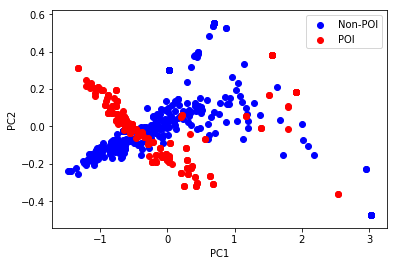

In [22]:
import matplotlib.pyplot as plt
plt.scatter(X_non_POI_reduced[:, 0], X_non_POI_reduced[:, 1],color='blue',label='Non-POI')
plt.scatter(X_POI_reduced[:, 0], X_POI_reduced[:, 1],color='red',label='POI')
# plt.scatter(X_non_POI_embedded[:, 0], X_non_POI_embedded[:, 1],color='red')
# plt.scatter(X_POI_embedded[:, 0], X_POI_embedded[:, 1],color='blue')
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.legend()
plt.show()

The above plot seems to be telling that there is a pattern assoicated with the POI email vectors. The POI emails vectors seem to be falling in one narrow band in the plot, except for a few of them which appears to be scattered. I'm not really sure what to make of this pattern, of if it indeed is saying something meaningful at all. We are comparing about 250 POI emails to 300 non-POI emails. Although it is not shown here, I had earlier plotted 1000 non-POI emails, and I found the same pattern. There were distinct regions of no-overlap between POI and non-POI emails. The question I have in my mind right now is, 
1) What about those non-POI emails which falls very close to the POI emails? Are they potentially unidentified Emails of Interest? (EOI)? Subsequently, should the people involved in that email exchange be considered as POI as well?

[NOTE: Of course, the 300 dimensional vector has been reduced to a 2 dimension vector using PCA for visualization purposes. However, looking at the explained variance ratio of the principal components (as shown below), we see that close to 70% of the variance in the data is captured in the first component itself.]

In [27]:
display(pca1.explained_variance_ratio_)
display(pca2.explained_variance_ratio_)

array([ 0.69632829,  0.02832875])

array([ 0.68805387,  0.02702359])